In [1]:
import h5py
import os
import math
from IPython.display import display
from PIL import Image
import numpy as np
import tensorflow as tf
from tensorflow import keras
import importlib
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import pickle

import datasets
import models
import losses

2021-07-29 15:06:01.824043: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0


In [2]:
importlib.reload(datasets)
filepath = 'datasets/nyu_depth/nyu_depth_v2_labeled.mat'
# images, depths = datasets.nyu_depth(filepath, dsize=(224,224))
# x_train, x_test, y_train, y_test = train_test_split(images, depths, test_size=0.2, shuffle=False)

# train_ds = tf.data.Dataset.from_tensor_slices((x_train, y_train))
# test_ds = tf.data.Dataset.from_tensor_slices((x_test, y_test))

train_ds, test_ds, train_size, test_size = datasets.nyu_depth_ds(filepath, 0.2)

2021-07-29 15:06:04.168040: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcuda.so.1
2021-07-29 15:06:04.229016: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1733] Found device 0 with properties: 
pciBusID: 0000:65:00.0 name: NVIDIA GeForce RTX 2080 computeCapability: 7.5
coreClock: 1.725GHz coreCount: 46 deviceMemorySize: 7.76GiB deviceMemoryBandwidth: 417.23GiB/s
2021-07-29 15:06:04.229063: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0
2021-07-29 15:06:04.243744: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcublas.so.11
2021-07-29 15:06:04.243849: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcublasLt.so.11
2021-07-29 15:06:04.248903: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcuf

In [3]:
# train_ds = tf.data.Dataset.from_tensor_slices((x_train, y_train))
# train_ds = train_ds.batch(5)
# print(train_size)
# print(test_size)
# print(list(train_ds.take(1).as_numpy_iterator())[0][0].shape)

# first_1 = list(train_ds.take(1).map(resize((224, 224))).as_numpy_iterator())[0][0]
# first_2 = x_train[0]

# print(first_1.shape, first_2.shape)

# diff = first_1 - first_2
# print(diff[0],diff[1],diff[2])
# image = Image.fromarray((diff*255).astype(np.uint8))
# display(image)
# display(Image.fromarray((first_1*255).astype(np.uint8)))
# display(Image.fromarray((first_2*255).astype(np.uint8)))

In [41]:
def spatial_augmentation(seed=1234, out_shape=None):
    rng = tf.random.Generator.from_seed(seed, alg='philox')
    def augmentor(image, label):
        #flip_lr, flip_ud, crop, 
        seed = rng.make_seeds(2)[0]
        label = tf.expand_dims(label, 2)
        image = tf.image.stateless_random_flip_left_right(image, seed)
        label = tf.image.stateless_random_flip_left_right(label, seed)
#         image = tf.image.stateless_random_flip_up_down(image, seed)
#         label = tf.image.stateless_random_flip_up_down(label, seed)
        
#         if rng.uniform((1,))[0] > 0.5:
        scale_factor = rng.uniform((1,), minval=0.5, maxval=1)[0]
        w = image.shape[0]*scale_factor
        h = image.shape[1]*scale_factor
        
        image = tf.image.stateless_random_crop(image, (w, h, 3), seed)
        label = tf.image.stateless_random_crop(label, (w, h, 1), seed)
        
        if out_shape:
            image = tf.image.resize(image, out_shape)
            label = tf.image.resize(label, out_shape)
        
        sf_tensor = tf.fill((224, 224, 1), 1-scale_factor)
        image = tf.concat([image, sf_tensor], 2)

        image = tf.cast(image, tf.float64)
            
        return image, label[:, :, 0]
    
    return augmentor

def add_zero_channel(image, label):
    t = tf.fill((image.shape[0], image.shape[1], 1), 0.0)
    image = tf.concat([image, t], 2)
    return image, label

def rgb_augmentation(seed=1234):
    rng = tf.random.Generator.from_seed(seed, alg='philox')
    def rgb_augmentor(image, label):
        seed = rng.make_seeds(2)[0]
        image = tf.image.stateless_random_brightness(image, 0.05, seed)
        image = tf.image.stateless_random_hue(image, 0.08, seed)
        image = tf.image.stateless_random_saturation(image, 0.6, 1.6, seed)
        image = tf.image.stateless_random_contrast(image, 0.7, 1.3, seed)
        
        return image, label
        
    return rgb_augmentor

def resize(shape):
    def resizer(image, label):
        label = tf.expand_dims(label, 2)
        image = tf.image.resize(image, shape)
        label = tf.image.resize(label, shape)
        
#         image = (image/127.5)-1
#         image = image/255
        
        return image, label[:, :, 0]
        
    return resizer

# spatial_augmentor = spatial_augmentation()
# rgb_augmentor = rgb_augmentation()
# for i in range(30):
#     image, label = next(iter(train_ds))
#     image, label = rgb_augmentor(image, label)
#     image, label = spatial_augmentor(image, label)
#     fig = plt.figure()
#     plt.subplot(1,2,1)
#     plt.title('Original image')
#     plt.imshow(image)
    
#     plt.subplot(1,2,2)
#     plt.title('Augmented image')
#     plt.imshow(label)


In [45]:
def experiment(name, model, loss, optimizer, batch_size, epochs, augment_rgb=True, augment_spatial=True, shuffle=False):
    model_file = "saved_models/{}.h5".format(name)
    history_file = "train_history/{}.obj".format(name)
    if os.path.isfile(model_file):
        print("Model file already exists.")
        return
    
    metrics = [losses.percent_relative_error(0.1), losses.percent_relative_error(0.25), 
                   losses.ssim_loss, losses.edge_loss, tf.keras.losses.MeanAbsoluteError(), 
                   tf.keras.losses.MeanSquaredError(), tf.keras.metrics.RootMeanSquaredError()]
    model.compile(loss=loss, optimizer=optimizer, metrics=metrics)
    train = train_ds
    test = test_ds
    if augment_rgb:
        train = train.map(rgb_augmentation())
    if augment_spatial:
        train = train.map(spatial_augmentation(out_shape=(224,224)))

    train = train.map(resize((224, 224))) 
    if shuffle:
        train = train.shuffle(train_size, reshuffle_each_iteration=True)
    test = test_ds.map(resize((224, 224))).map(add_zero_channel)
    
    train = train.batch(batch_size)
    test = test.batch(16)
    history = model.fit(train,
        epochs=epochs,
#         steps_per_epoch = math.floor(train_size/batch_size),
        verbose = 1,
        validation_data = test)
    model.save(model_file, include_optimizer=False)
    
    filehandler = open(history_file,"wb")
    pickle.dump(history.history,filehandler)
    filehandler.close()

In [16]:
def evaluate_model(model, count):
    ds = test_ds.map(resize((224, 224))).map(add_zero_channel)
    ds_batched = ds.batch(1)
    model.compile(metrics=[losses.percent_relative_error(0.1), losses.percent_relative_error(0.25), 
                           losses.ssim_loss, losses.edge_loss, tf.keras.losses.MeanAbsoluteError(), 
                           tf.keras.losses.MeanSquaredError(), tf.keras.metrics.RootMeanSquaredError()])
    model.evaluate(ds_batched)
    
    ds = ds.take(count)
    f, axarr = plt.subplots(count,3)
    f.set_figheight(5*count)
    f.set_figwidth(15)
    i = 0
    for image, label in ds.as_numpy_iterator():
        img = ((image[:, :, 0:3]+1) * 127.5).astype(np.uint8)
        
        out = model.predict(np.expand_dims(image, axis=0))

        axarr[i, 0].imshow(img)
        axarr[i, 1].imshow(label)
        axarr[i, 2].imshow(out[0, :, :, 0])
        i = i + 1
    plt.show()
    

In [7]:
def show_history(name):
    file_name = "train_history/{}.obj".format(name)
    if not os.path.isfile(file_name):
        print("No history was saved")
        return
    file = open(file_name,'rb')
    history = pickle.load(file)
    file.close()

    plt.plot(history['loss'], label='Training loss')
    plt.plot(history['val_loss'], label='Validation loss')
    plt.plot(history['relative_error_25.0'], label='Percent under 25% error')
    plt.plot(history['val_relative_error_25.0'], label='Percen undeer 25% error val')
    plt.title('Loss vs Epochs')
    plt.ylabel('MAE value')
    plt.xlabel('Epoch #')
    plt.legend(loc="upper left")
    plt.show()

# Experiments

#### Some papers
Fast Depth (https://arxiv.org/pdf/1903.03273.pdf):  MobileNet V1 with various decoders.  Fast network with good results
Depth Map Prediction from a Single Image using a Multi-Scale Deep Network(https://arxiv.org/pdf/1406.2283.pdf): Defines scale invariant MSE


In [8]:
# model: mobilenet unet
# iters: 220, bs: 5, data augmentation: none
# loss: l1 + 0.5*ssim + 0.5*edge
# optimizer: SGD with lr 0.01 and momentum 0.9
# m = tf.keras.models.load_model("saved_models/mobilenet_unet_1.h5")
# importlib.reload(losses)
# evaluate_model(m, 10)

In [9]:
# model: mobilenet unet
# iters: 450, bs: 5, data augmentation: none
# loss: l1 + 0.5*ssim + 0.5*edge
# optimizer: SGD with lr 0.01 and momentum 0.9
# m = tf.keras.models.load_model("saved_models/mobilenet_unet_2.h5")
# evaluate_model(m, 10)

In [10]:
# model: mobilenet unet
# iters: 450, bs: 5, data augmentation: none
# loss: 0.3 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
# importlib.reload(models)
# importlib.reload(losses)
# model = models.mobilenet_unet(224, 224, 3)
# loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0)
# optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
# experiment("saved_models/mobilenet_unet_3.h5", model, loss, optimizer, 5, 450, augment_rgb=False, augment_spatial=False)
# m = tf.keras.models.load_model("saved_models/mobilenet_unet_3.h5")
# evaluate_model(m, 10)

In [11]:
# model: mobilenet unet
# iters: 450, bs: 5, data augmentation: none
# loss: 1.0 * l1 + 0.5 * ssim + 0.5 * edge
# optimizer: Adam lr rate 0.01
# model = models.mobilenet_unet(224, 224, 3)
# loss = losses.l1_ssim_edge(l1_weight=1.0, ssim_weight=0.5, edge_weight=0.5)
# optimizer = keras.optimizers.Adam(learning_rate=1e-2)
# experiment("saved_models/mobilenet_unet_4.h5", model, loss, optimizer, 5, 450, augment_rgb=False, augment_spatial=False)
# m = tf.keras.models.load_model("saved_models/mobilenet_unet_4.h5")
# evaluate_model(m, 10)

In [12]:
# model: mobilenet unet
# iters: 450, bs: 5, data augmentation: none
# loss: 0.3 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: Adam lr rate 0.01
# model = models.mobilenet_unet(224, 224, 3)
# loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0)
# optimizer = keras.optimizers.Adam(learning_rate=1e-2)
# experiment("saved_models/mobilenet_unet_5.h5", model, loss, optimizer, 5, 450, augment_rgb=False, augment_spatial=False)
# m = tf.keras.models.load_model("saved_models/mobilenet_unet_5.h5")
# evaluate_model(m, 10)

In [13]:
# model: mobilenet unet
# iters: 450, bs: 5, data augmentation: none
# loss: 1.0 * l1 + 0 * ssim + 0 * edge
# optimizer: Adam lr rate 0.01
# model = models.mobilenet_unet(224, 224, 3)
# loss = losses.l1_ssim_edge(l1_weight=1.0, ssim_weight=0, edge_weight=0)
# optimizer = keras.optimizers.Adam(learning_rate=1e-2)
# experiment("saved_models/mobilenet_unet_6.h5", model, loss, optimizer, 5, 450, augment_rgb=False, augment_spatial=False)
# m = tf.keras.models.load_model("saved_models/mobilenet_unet_6.h5")
# evaluate_model(m, 10)

In [14]:
# model: mobilenet unet
# iters: 450, bs: 5, data augmentation: none
# loss: 1.0 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: Adam lr rate 0.01
# model = models.mobilenet_unet(224, 224, 3)
# loss = losses.l1_ssim_edge(l1_weight=1.0, ssim_weight=1.0, edge_weight=1.0)
# optimizer = keras.optimizers.Adam(learning_rate=1e-2)
# experiment("saved_models/mobilenet_unet_7.h5", model, loss, optimizer, 5, 450, augment_rgb=False, augment_spatial=False)
# m = tf.keras.models.load_model("saved_models/mobilenet_unet_7.h5")
# evaluate_model(m, 10)

In [15]:
# model: mobilenet unet
# iters: 450, bs: 8, data augmentation: none
# loss: 1.0 * l1 + 0.5 * ssim + 0.5 * edge
# optimizer: Adam lr rate 0.01
# model = models.mobilenet_unet(224, 224, 3)
# loss = losses.l1_ssim_edge(l1_weight=1.0, ssim_weight=0.5, edge_weight=0.5)
# optimizer = keras.optimizers.Adam(learning_rate=1e-2)
# experiment("saved_models/mobilenet_unet_8.h5", model, loss, optimizer, 8, 450, augment_rgb=False, augment_spatial=False)
# m = tf.keras.models.load_model("saved_models/mobilenet_unet_8.h5")
# evaluate_model(m, 10)

In [16]:
# model: mobilenet unet
# iters: 450, bs: 5, data augmentation: color and spatial
# loss: 0.3 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
# importlib.reload(models)
# importlib.reload(losses)
# model = models.mobilenet_unet(224, 224, 3)
# loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0)
# optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
# experiment("saved_models/mobilenet_unet_9.h5", model, loss, optimizer, 5, 450, augment_rgb=True, augment_spatial=True)
# m = tf.keras.models.load_model("saved_models/mobilenet_unet_9.h5")
# evaluate_model(m, 10)

In [17]:
# model: mobilenet unet, no pretrained weights
# iters: 450, bs: 5, data augmentation: color and spatial
# loss: 0.3 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
# importlib.reload(models)
# importlib.reload(losses)
# model = models.mobilenet_unet(224, 224, 3, weights=None)
# loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0)
# optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
# experiment("saved_models/mobilenet_unet_10.h5", model, loss, optimizer, 5, 450, augment_rgb=True, augment_spatial=True)
# m = tf.keras.models.load_model("saved_models/mobilenet_unet_10.h5")
# evaluate_model(m, 10)

In [18]:
# model: mobilenet unet, alpha 1.0 (only encoder is increased)
# iters: 450, bs: 5, data augmentation: color and spatial
# loss: 0.3 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
# importlib.reload(models)
# importlib.reload(losses)
# model = models.mobilenet_unet(224, 224, 3, alpha=1.0)
# loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0)
# optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
# experiment("saved_models/mobilenet_unet_11.h5", model, loss, optimizer, 5, 450, augment_rgb=True, augment_spatial=True)
# m = tf.keras.models.load_model("saved_models/mobilenet_unet_11.h5")
# evaluate_model(m, 10)

In [19]:
# model: mobilenet unet
# iters: 450, bs: 5, data augmentation: color and spatial
# loss: 0 * l1 + 1.0 * ssim + 0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
# importlib.reload(models)
# importlib.reload(losses)
# model = models.mobilenet_unet(224, 224, 3)
# loss = losses.l1_ssim_edge(l1_weight=0, ssim_weight=1.0, edge_weight=0)
# optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
# experiment("saved_models/mobilenet_unet_12.h5", model, loss, optimizer, 5, 450, augment_rgb=True, augment_spatial=True)
# m = tf.keras.models.load_model("saved_models/mobilenet_unet_12.h5")
# evaluate_model(m, 10)

In [20]:
# model: mobilenet unet
# iters: 450, bs: 5, data augmentation: color and spatial
# loss: 0 * l1 + 0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
# importlib.reload(models)
# importlib.reload(losses)
# model = models.mobilenet_unet(224, 224, 3)
# loss = losses.l1_ssim_edge(l1_weight=0, ssim_weight=0, edge_weight=1.0)
# optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
# experiment("saved_models/mobilenet_unet_13.h5", model, loss, optimizer, 5, 450, augment_rgb=True, augment_spatial=True)
# m = tf.keras.models.load_model("saved_models/mobilenet_unet_13.h5")
# evaluate_model(m, 10)

In [21]:
# model: mobilenet unet
# iters: 450, bs: 5, data augmentation: color and spatial
# loss: l2
# optimizer: SGD with lr 0.01 and momentum 0.9
# importlib.reload(models)
# importlib.reload(losses)
# model = models.mobilenet_unet(224, 224, 3)
# loss = tf.keras.losses.MeanSquaredError()
# optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
# experiment("saved_models/mobilenet_unet_14.h5", model, loss, optimizer, 5, 450, augment_rgb=True, augment_spatial=True)
# m = tf.keras.models.load_model("saved_models/mobilenet_unet_14.h5")
# evaluate_model(m, 10)

2021-07-29 11:51:34.089199: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:176] None of the MLIR Optimization Passes are enabled (registered 2)
2021-07-29 11:51:34.108815: I tensorflow/core/platform/profile_utils/cpu_utils.cc:114] CPU Frequency: 3999980000 Hz
2021-07-29 11:51:35.315328: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudnn.so.8
2021-07-29 11:51:36.065995: I tensorflow/stream_executor/cuda/cuda_dnn.cc:359] Loaded cuDNN version 8201
2021-07-29 11:51:37.055198: W tensorflow/stream_executor/gpu/asm_compiler.cc:64] Running ptxas --version returned 32512
2021-07-29 11:51:37.122651: W tensorflow/stream_executor/gpu/redzone_allocator.cc:314] Internal: ptxas exited with non-zero error code 32512, output: 
Relying on driver to perform ptx compilation. 
Modify $PATH to customize ptxas location.
This message will be only logged once.
2021-07-29 11:51:37.145430: I tensorflow/stream_executor/platform/default/dso_load

654/654 [==============================] - 17s 20ms/step - loss: 0.0000e+00 - relative_error_10.0: 0.1694 - relative_error_25.0: 0.4385 - ssim_loss: 0.1306 - edge_loss: 0.0185 - mean_absolute_error: 0.0906 - mean_squared_error: 0.0166 - root_mean_squared_error: 0.1287


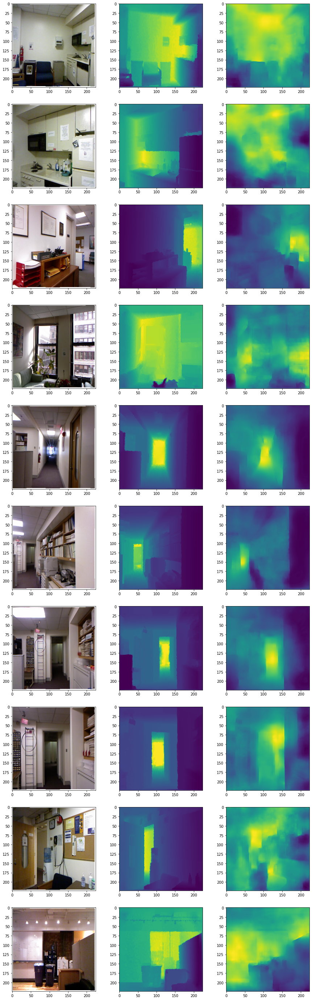

In [22]:
# model: mobilenet unet
# iters: 450, bs: 5, data augmentation: color
# loss: 0.3 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
# importlib.reload(models)
# importlib.reload(losses)
# model = models.mobilenet_unet(224, 224, 3)
# loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0)
# optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
# experiment("saved_models/mobilenet_unet_15.h5", model, loss, optimizer, 5, 450, augment_rgb=True, augment_spatial=False)
m = tf.keras.models.load_model("saved_models/mobilenet_unet_15.h5")
evaluate_model(m, 10)

Model file already exists.
No history was saved
654/654 [==============================] - 15s 21ms/step - loss: 0.0000e+00 - relative_error_10.0: 0.1934 - relative_error_25.0: 0.4848 - ssim_loss: 0.1304 - edge_loss: 0.0211 - mean_absolute_error: 0.0834 - mean_squared_error: 0.0140 - root_mean_squared_error: 0.1185


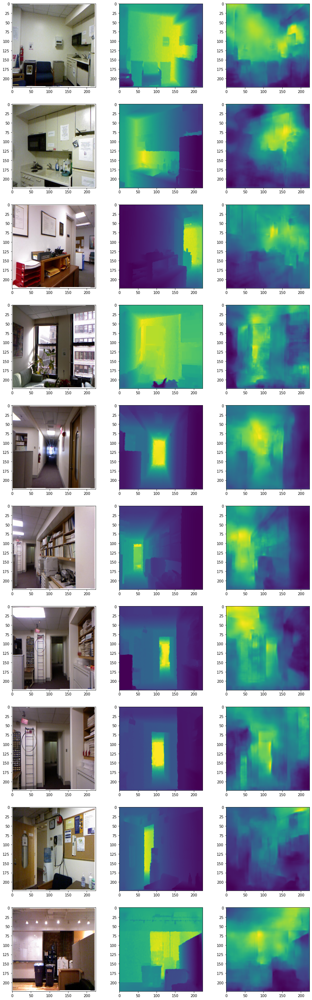

In [23]:
# model: mobilenet unet, alpha = 0.35
# iters: 450, bs: 8, data augmentation: none
# loss: 0.3 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
name = "mobilenet_unet_16"
importlib.reload(models)
importlib.reload(losses)
model = models.mobilenet_unet(224, 224, 3, alpha=0.35)
loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0)
optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
experiment(name, model, loss, optimizer, 8, 450, augment_rgb=False, augment_spatial=False)
m = tf.keras.models.load_model("saved_models/{}.h5".format(name))
show_history(name)
evaluate_model(m, 10)

Model file already exists.
654/654 [==============================] - 15s 21ms/step - loss: 0.0000e+00 - relative_error_10.0: 0.2358 - relative_error_25.0: 0.5466 - ssim_loss: 0.1204 - edge_loss: 0.0219 - mean_absolute_error: 0.0750 - mean_squared_error: 0.0109 - root_mean_squared_error: 0.1046


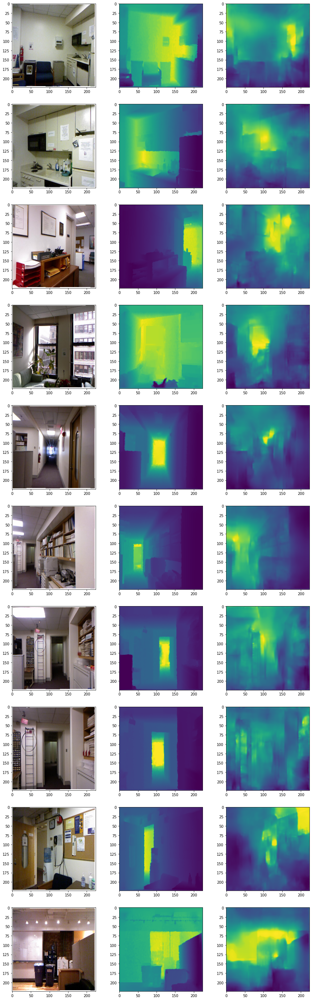

In [24]:
# model: mobilenet unet, alpha = 0.35
# iters: 450, bs: 8, data augmentation: color and spatial
# loss: 0.3 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
name = "mobilenet_unet_17"
importlib.reload(models)
importlib.reload(losses)
model = models.mobilenet_unet(224, 224, 3, alpha=0.35)
loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0)
optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
experiment(name, model, loss, optimizer, 8, 450, augment_rgb=True, augment_spatial=True)
m = tf.keras.models.load_model("saved_models/{}.h5".format(name))
evaluate_model(m, 10)

Model file already exists.
654/654 [==============================] - 16s 22ms/step - loss: 0.0000e+00 - relative_error_10.0: 0.1647 - relative_error_25.0: 0.4298 - ssim_loss: 0.1354 - edge_loss: 0.0197 - mean_absolute_error: 0.0913 - mean_squared_error: 0.0167 - root_mean_squared_error: 0.1292


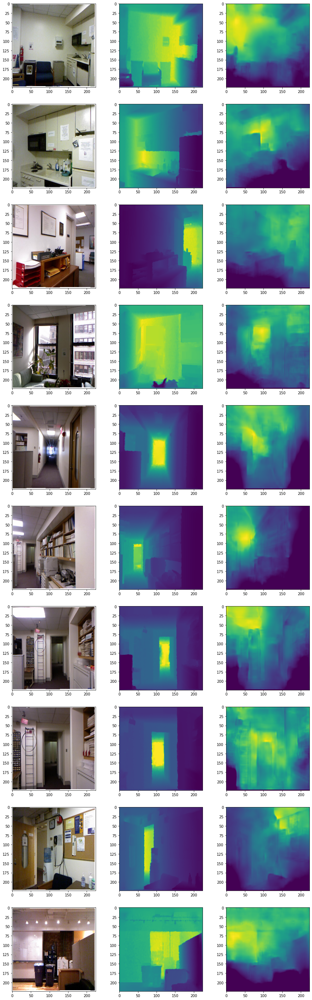

In [25]:
# model: mobilenet unet, alpha = 0.5
# iters: 450, bs: 8, data augmentation: color and spatial
# loss: 0.3 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
name = "mobilenet_unet_18"
importlib.reload(models)
importlib.reload(losses)
model = models.mobilenet_unet(224, 224, 3, alpha=0.5)
loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0)
optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
experiment(name, model, loss, optimizer, 8, 450, augment_rgb=True, augment_spatial=True)
m = tf.keras.models.load_model("saved_models/{}.h5".format(name))
evaluate_model(m, 10)

Model file already exists.
654/654 [==============================] - 20s 28ms/step - loss: 0.0000e+00 - relative_error_10.0: 0.2145 - relative_error_25.0: 0.5203 - ssim_loss: 0.1164 - edge_loss: 0.0197 - mean_absolute_error: 0.0775 - mean_squared_error: 0.0124 - root_mean_squared_error: 0.1115


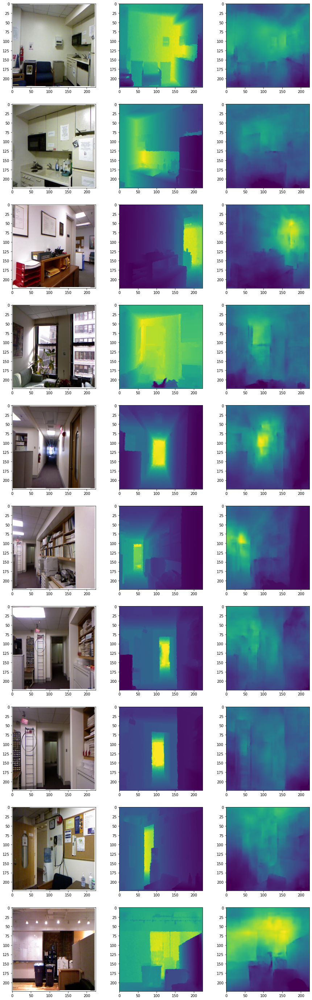

In [26]:
# model: mobilenet unet, alpha = 1.0
# iters: 450, bs: 8, data augmentation: color and spatial
# loss: 0.3 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
name = "mobilenet_unet_19"
importlib.reload(models)
importlib.reload(losses)
model = models.mobilenet_unet(224, 224, 3, alpha=1.0)
loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0)
optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
experiment(name, model, loss, optimizer, 8, 450, augment_rgb=True, augment_spatial=True)
m = tf.keras.models.load_model("saved_models/{}.h5".format(name))
evaluate_model(m, 10)

Model file already exists.


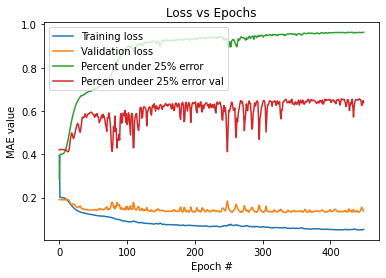

654/654 [==============================] - 20s 28ms/step - loss: 0.0000e+00 - relative_error_10.0: 0.2591 - relative_error_25.0: 0.5895 - ssim_loss: 0.1079 - edge_loss: 0.0212 - mean_absolute_error: 0.0680 - mean_squared_error: 0.0091 - root_mean_squared_error: 0.0955


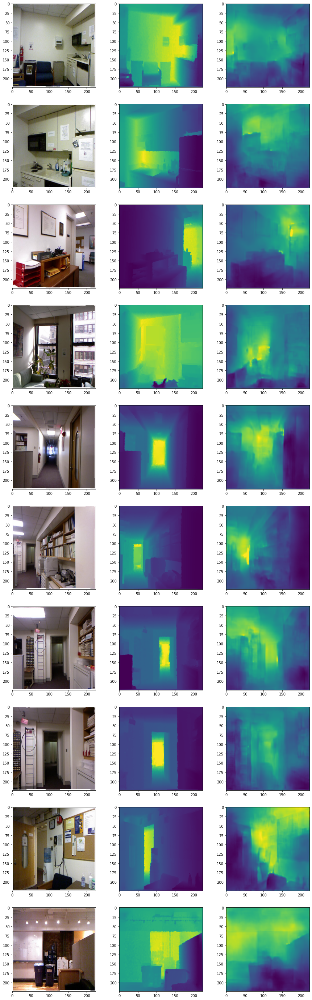

In [27]:
# model: mobilenet unet, alpha = 1.0
# iters: 450, bs: 8, data augmentation: color and spatial with random sized crops
# loss: 0.3 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
name = "mobilenet_unet_20"
importlib.reload(models)
importlib.reload(losses)
model = models.mobilenet_unet(224, 224, 3, alpha=1.0)
loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0)
optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
experiment(name, model, loss, optimizer, 8, 450, augment_rgb=True, augment_spatial=True)
m = tf.keras.models.load_model("saved_models/{}.h5".format(name))
show_history(name)
evaluate_model(m, 10)

Model file already exists.


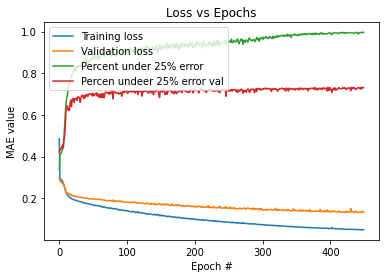

654/654 [==============================] - 20s 29ms/step - loss: 0.0175 - relative_error_10.0: 0.2921 - relative_error_25.0: 0.6473 - ssim_loss: 0.0939 - edge_loss: 0.0188 - mean_absolute_error: 0.0611 - mean_squared_error: 0.0078 - root_mean_squared_error: 0.0884


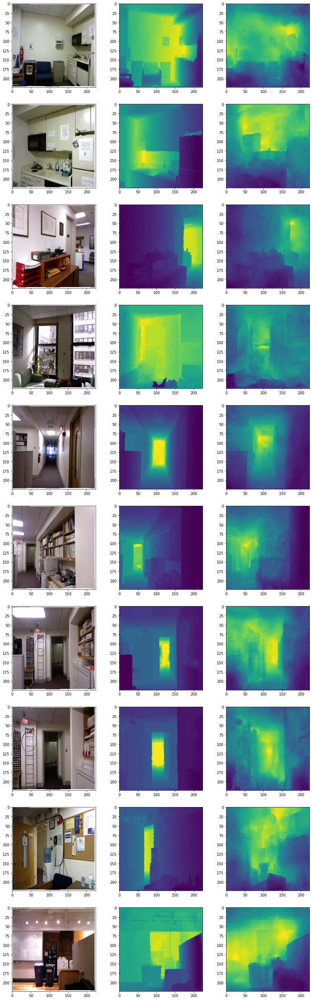

In [28]:
# model: mobilenet unet, alpha = 1.0, regularization
# iters: 450, bs: 8, data augmentation: color and spatial with random sized crops, shuffling
# loss: 0.3 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
name = "mobilenet_unet_21"
importlib.reload(models)
importlib.reload(losses)
model = models.mobilenet_unet(224, 224, 3, alpha=1.0)
loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0)
optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
experiment(name, model, loss, optimizer, 8, 450, augment_rgb=True, augment_spatial=True, shuffle=True)
m = tf.keras.models.load_model("saved_models/{}.h5".format(name))
show_history(name)
evaluate_model(m, 10)

Model file already exists.


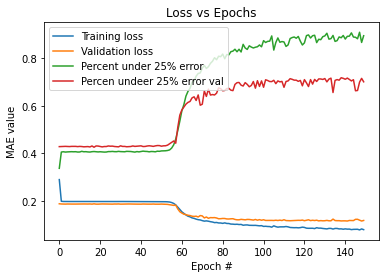

654/654 [==============================] - 20s 29ms/step - loss: 0.0000e+00 - relative_error_10.0: 0.2870 - relative_error_25.0: 0.6168 - ssim_loss: 0.0999 - edge_loss: 0.0202 - mean_absolute_error: 0.0636 - mean_squared_error: 0.0079 - root_mean_squared_error: 0.0891


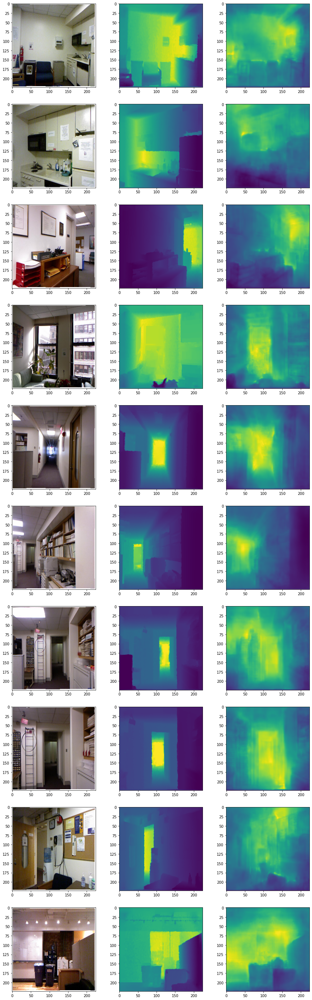

In [29]:
# model: mobilenet unet, alpha = 1.0, no regularization
# iters: 150, bs: 8, data augmentation: color and spatial with random sized crops, shuffling
# loss: 0.3 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
name = "mobilenet_unet_22"
importlib.reload(models)
importlib.reload(losses)
model = models.mobilenet_unet(224, 224, 3, alpha=1.0, regularize_decoder=False, decoder_initializer='glorot_uniform', last_channels=3)
loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0)
optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
experiment(name, model, loss, optimizer, 8, 150, augment_rgb=True, augment_spatial=True, shuffle=True)
m = tf.keras.models.load_model("saved_models/{}.h5".format(name))
show_history(name)
evaluate_model(m, 10)

Model file already exists.


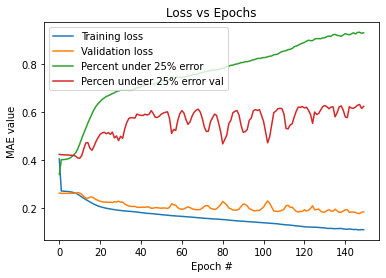

654/654 [==============================] - 20s 29ms/step - loss: 0.0403 - relative_error_10.0: 0.2319 - relative_error_25.0: 0.5460 - ssim_loss: 0.1181 - edge_loss: 0.0221 - mean_absolute_error: 0.0740 - mean_squared_error: 0.0105 - root_mean_squared_error: 0.1026


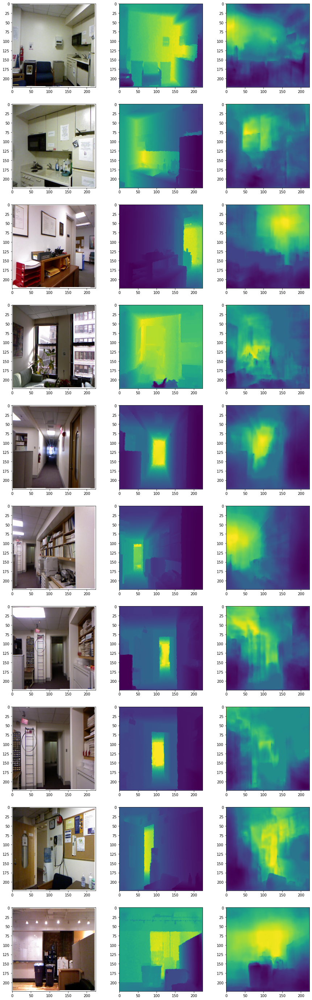

In [30]:
# model: mobilenet unet, alpha = 1.0, regularization
# iters: 150, bs: 8, data augmentation: color and spatial with random sized crops, no shuffling
# loss: 0.3 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
name = "mobilenet_unet_23"
importlib.reload(models)
importlib.reload(losses)
model = models.mobilenet_unet(224, 224, 3, alpha=1.0, regularize_decoder=True, decoder_initializer='glorot_uniform', last_channels=3)
loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0)
optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
experiment(name, model, loss, optimizer, 8, 150, augment_rgb=True, augment_spatial=True, shuffle=False)
m = tf.keras.models.load_model("saved_models/{}.h5".format(name))
show_history(name)
evaluate_model(m, 10)

Model file already exists.


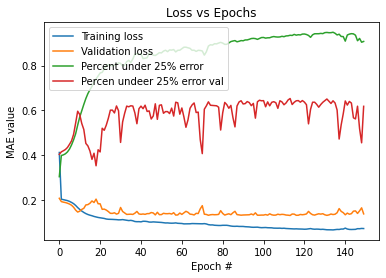

654/654 [==============================] - 20s 29ms/step - loss: 0.0000e+00 - relative_error_10.0: 0.2542 - relative_error_25.0: 0.5771 - ssim_loss: 0.1074 - edge_loss: 0.0207 - mean_absolute_error: 0.0696 - mean_squared_error: 0.0098 - root_mean_squared_error: 0.0990


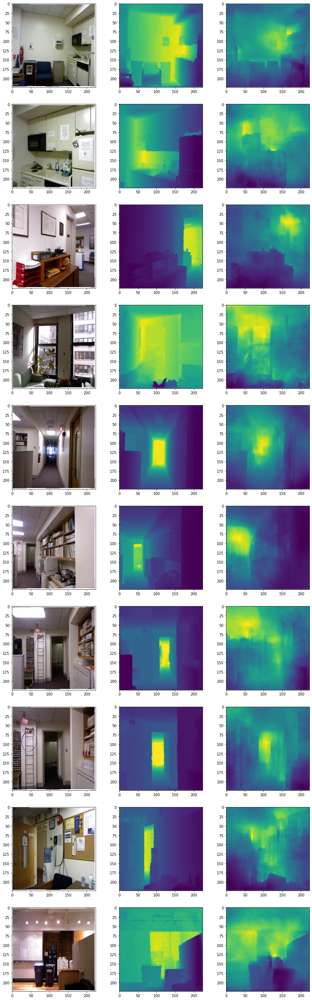

In [31]:
# model: mobilenet unet, alpha = 1.0, no regularization
# iters: 150, bs: 8, data augmentation: color and spatial with random sized crops, shuffling
# loss: 0.3 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
name = "mobilenet_unet_24"
importlib.reload(models)
importlib.reload(losses)
model = models.mobilenet_unet(224, 224, 3, alpha=1.0, regularize_decoder=False, decoder_initializer='glorot_uniform', last_channels=16)
loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0)
optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
experiment(name, model, loss, optimizer, 8, 150, augment_rgb=True, augment_spatial=True, shuffle=False)
m = tf.keras.models.load_model("saved_models/{}.h5".format(name))
show_history(name)
evaluate_model(m, 10)

Model file already exists.


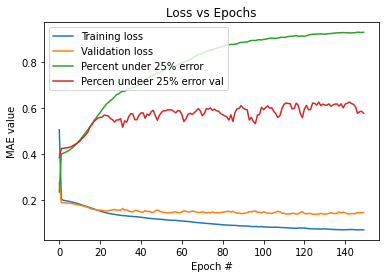

654/654 [==============================] - 20s 28ms/step - loss: 0.0000e+00 - relative_error_10.0: 0.1620 - relative_error_25.0: 0.4290 - ssim_loss: 0.1363 - edge_loss: 0.0202 - mean_absolute_error: 0.0904 - mean_squared_error: 0.0161 - root_mean_squared_error: 0.1267


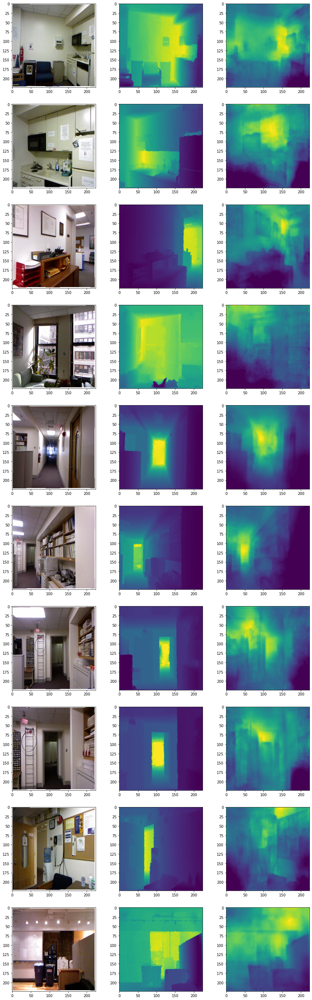

In [32]:
# model: mobilenet unet, alpha = 1.0, no regularization
# iters: 150, bs: 8, data augmentation: color and spatial with random sized crops, shuffling
# loss: 0.3 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
name = "mobilenet_unet_25"
importlib.reload(models)
importlib.reload(losses)
model = models.mobilenet_unet(224, 224, 3, alpha=1.0, regularize_decoder=False, decoder_initializer='he_normal', last_channels=3)
loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0)
optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
experiment(name, model, loss, optimizer, 8, 150, augment_rgb=True, augment_spatial=True, shuffle=False)
m = tf.keras.models.load_model("saved_models/{}.h5".format(name))
show_history(name)
evaluate_model(m, 10)

Model file already exists.


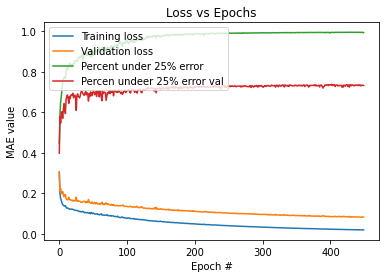

654/654 [==============================] - 21s 29ms/step - loss: 0.0162 - relative_error_10.0: 0.2789 - relative_error_25.0: 0.6318 - ssim_loss: 0.1045 - edge_loss: 0.0223 - mean_absolute_error: 0.0643 - mean_squared_error: 0.0091 - root_mean_squared_error: 0.0952


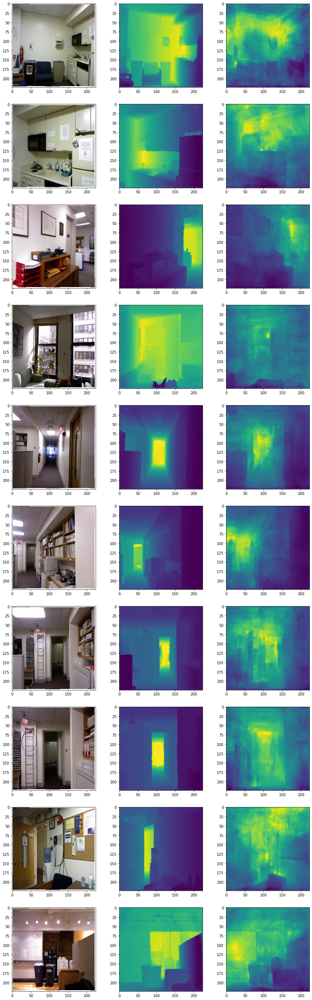

In [33]:
# model: mobilenet unet, alpha = 1.0, regularization
# iters: 150, bs: 8, data augmentation: color and spatial with random sized crops, shuffling
# loss: log mse
# optimizer: SGD with lr 0.01 and momentum 0.9
name = "mobilenet_unet_26"
importlib.reload(models)
importlib.reload(losses)
model = models.mobilenet_unet(224, 224, 3, alpha=1.0)
loss = losses.log_mse
optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
experiment(name, model, loss, optimizer, 8, 450, augment_rgb=True, augment_spatial=True, shuffle=True)
m = tf.keras.models.load_model("saved_models/{}.h5".format(name))
show_history(name)
evaluate_model(m, 10)

Model file already exists.


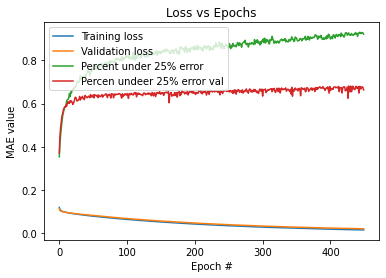

654/654 [==============================] - 20s 29ms/step - loss: 0.0155 - relative_error_10.0: 0.2651 - relative_error_25.0: 0.5951 - ssim_loss: 0.1559 - edge_loss: 0.0368 - mean_absolute_error: 0.0666 - mean_squared_error: 0.0087 - root_mean_squared_error: 0.0932


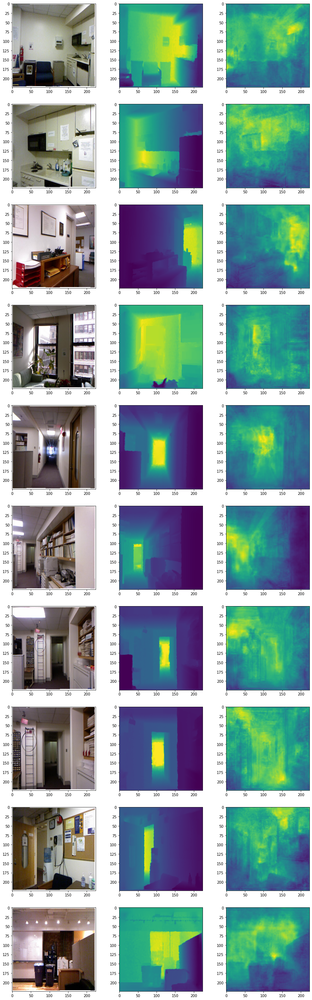

In [34]:
# model: mobilenet unet, alpha = 1.0, regularization
# iters: 150, bs: 8, data augmentation: color and spatial with random sized crops, shuffling
# loss: mse
# optimizer: SGD with lr 0.01 and momentum 0.9
name = "mobilenet_unet_27"
importlib.reload(models)
importlib.reload(losses)
model = models.mobilenet_unet(224, 224, 3, alpha=1.0)
loss = tf.keras.losses.MeanSquaredError()
optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
experiment(name, model, loss, optimizer, 8, 450, augment_rgb=True, augment_spatial=True, shuffle=True)
m = tf.keras.models.load_model("saved_models/{}.h5".format(name))
show_history(name)
evaluate_model(m, 10)

Model file already exists.


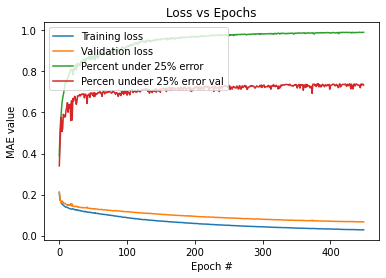

654/654 [==============================] - 21s 29ms/step - loss: 0.0167 - relative_error_10.0: 0.2950 - relative_error_25.0: 0.6467 - ssim_loss: 0.0984 - edge_loss: 0.0205 - mean_absolute_error: 0.0624 - mean_squared_error: 0.0085 - root_mean_squared_error: 0.0921


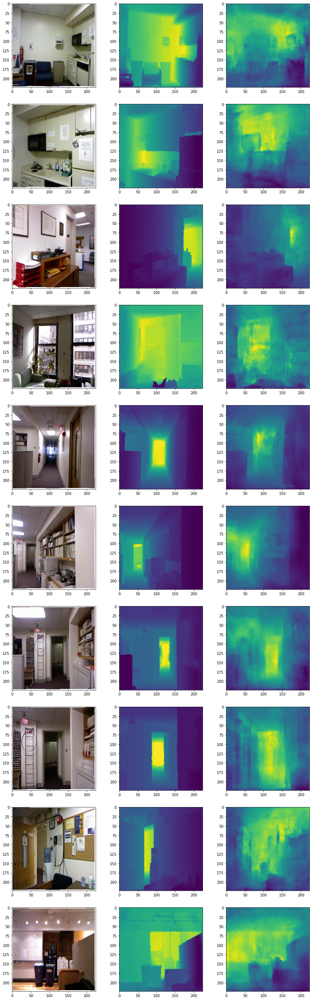

In [35]:
# model: mobilenet unet, alpha = 1.0, regularization
# iters: 150, bs: 8, data augmentation: color and spatial with random sized crops, shuffling
# loss: mae
# optimizer: SGD with lr 0.01 and momentum 0.9
name = "mobilenet_unet_28"
importlib.reload(models)
importlib.reload(losses)
model = models.mobilenet_unet(224, 224, 3, alpha=1.0)
loss = tf.keras.losses.MeanAbsoluteError()
optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
experiment(name, model, loss, optimizer, 8, 450, augment_rgb=True, augment_spatial=True, shuffle=True)
m = tf.keras.models.load_model("saved_models/{}.h5".format(name))
show_history(name)
evaluate_model(m, 10)

Model file already exists.


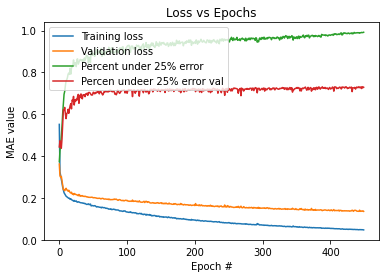

654/654 [==============================] - 21s 29ms/step - loss: 0.0172 - relative_error_10.0: 0.3075 - relative_error_25.0: 0.6571 - ssim_loss: 0.0922 - edge_loss: 0.0184 - mean_absolute_error: 0.0598 - mean_squared_error: 0.0075 - root_mean_squared_error: 0.0864


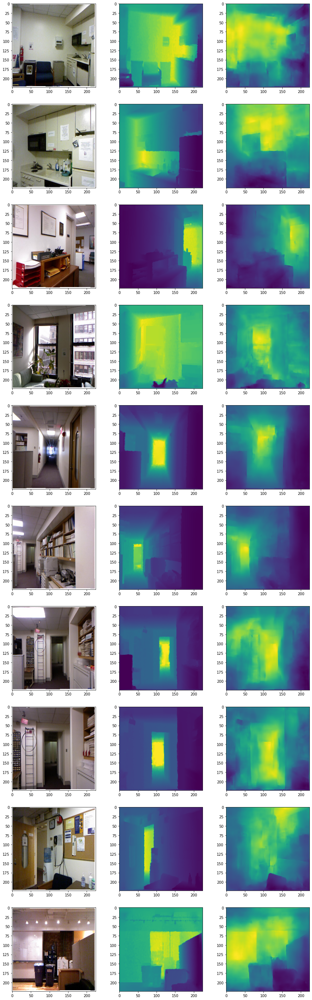

In [36]:
# model: mobilenet unet, alpha = 1.0, regularization
# iters: 150, bs: 8, data augmentation: color and spatial with random sized crops, shuffling
# loss: 0.3 * log_mse + 1.0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
name = "mobilenet_unet_29"
importlib.reload(models)
importlib.reload(losses)
model = models.mobilenet_unet(224, 224, 3, alpha=1.0)
loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0, l=losses.log_mse)
optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
experiment(name, model, loss, optimizer, 8, 450, augment_rgb=True, augment_spatial=True, shuffle=True)
m = tf.keras.models.load_model("saved_models/{}.h5".format(name))
show_history(name)
evaluate_model(m, 10)

Model file already exists.


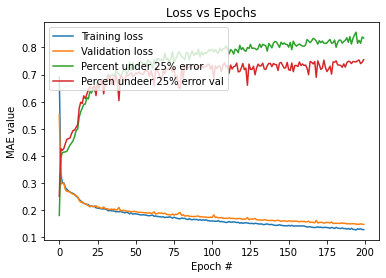

654/654 [==============================] - 21s 30ms/step - loss: 0.0422 - relative_error_10.0: 0.2476 - relative_error_25.0: 0.5950 - ssim_loss: 0.0983 - edge_loss: 0.0175 - mean_absolute_error: 0.0707 - mean_squared_error: 0.0112 - root_mean_squared_error: 0.1060


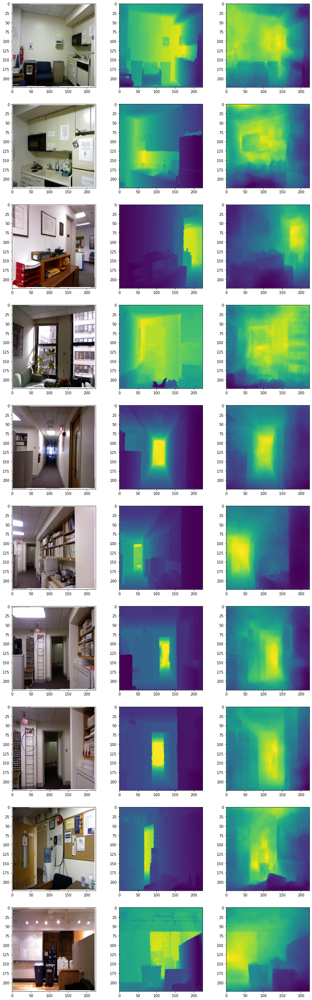

In [37]:
# model: mobilenet unet, alpha = 1.0, regularization
# iters: 150, bs: 8, data augmentation: color and spatial with random sized crops, shuffling
# loss: 0.3 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
name = "mobilenet_unet_30"
importlib.reload(models)
importlib.reload(losses)
model = models.mobilenet_unet(224, 224, 3, alpha=1.0)
loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0)
optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
experiment(name, model, loss, optimizer, 8, 200, augment_rgb=True, augment_spatial=True, shuffle=True)
m = tf.keras.models.load_model("saved_models/{}.h5".format(name))
show_history(name)
evaluate_model(m, 10)

In [38]:
# model: mobilenet unet, alpha = 1.0, regularization, no pretrained weights
# iters: 150, bs: 8, data augmentation: color and spatial with random sized crops, shuffling, extra scale channel
# loss: 0.3 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
# name = "mobilenet_unet_31"
# importlib.reload(models)
# importlib.reload(losses)
# model = models.mobilenet_unet(224, 224, 4, alpha=1.0, weights=None)
# loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0)
# optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
# experiment(name, model, loss, optimizer, 8, 200, augment_rgb=True, augment_spatial=True, shuffle=True)
# m = tf.keras.models.load_model("saved_models/{}.h5".format(name))
# show_history(name)
# evaluate_model(model, 10)

Model file already exists.


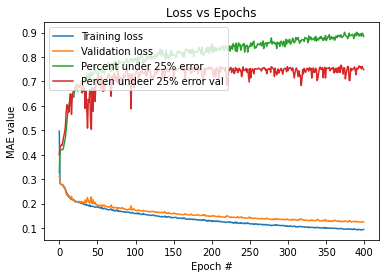

654/654 [==============================] - 21s 29ms/step - loss: 0.0200 - relative_error_10.0: 0.3830 - relative_error_25.0: 0.7479 - ssim_loss: 0.0731 - edge_loss: 0.0175 - mean_absolute_error: 0.0482 - mean_squared_error: 0.0051 - root_mean_squared_error: 0.0717


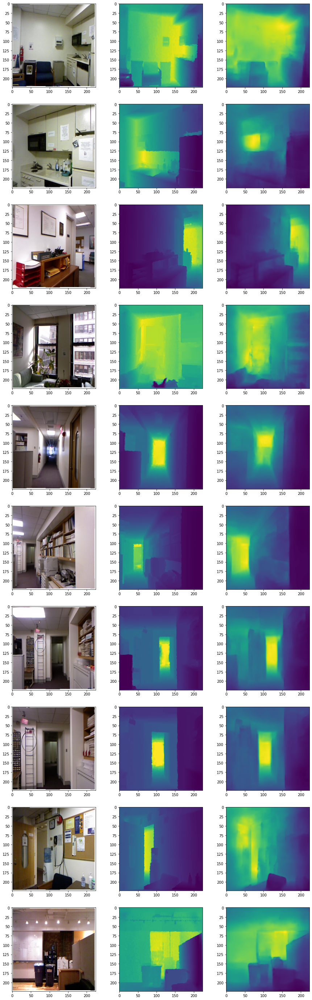

In [39]:
# model: mobilenet unet, alpha = 1.0, regularization
# iters: 150, bs: 8, data augmentation: color and spatial with random sized crops, shuffling
# loss: 0.3 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
name = "mobilenet_unet_32"
importlib.reload(models)
importlib.reload(losses)
model = models.mobilenet_unet(224, 224, 3, alpha=1.0)
loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0)
optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
experiment(name, model, loss, optimizer, 8, 400, augment_rgb=True, augment_spatial=True, shuffle=True)
m = tf.keras.models.load_model("saved_models/{}.h5".format(name))
show_history(name)
evaluate_model(m, 10)

Model file already exists.


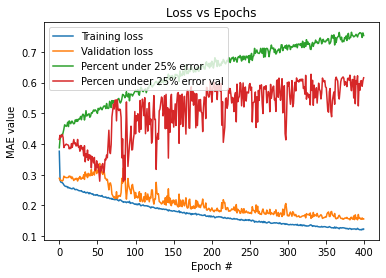

ValueError: in user code:

    /home/anews/Documents/venv/lib/python3.7/site-packages/tensorflow/python/keras/engine/training.py:1323 test_function  *
        return step_function(self, iterator)
    /home/anews/Documents/venv/lib/python3.7/site-packages/tensorflow/python/keras/engine/training.py:1314 step_function  **
        outputs = model.distribute_strategy.run(run_step, args=(data,))
    /home/anews/Documents/venv/lib/python3.7/site-packages/tensorflow/python/distribute/distribute_lib.py:1285 run
        return self._extended.call_for_each_replica(fn, args=args, kwargs=kwargs)
    /home/anews/Documents/venv/lib/python3.7/site-packages/tensorflow/python/distribute/distribute_lib.py:2833 call_for_each_replica
        return self._call_for_each_replica(fn, args, kwargs)
    /home/anews/Documents/venv/lib/python3.7/site-packages/tensorflow/python/distribute/distribute_lib.py:3608 _call_for_each_replica
        return fn(*args, **kwargs)
    /home/anews/Documents/venv/lib/python3.7/site-packages/tensorflow/python/keras/engine/training.py:1307 run_step  **
        outputs = model.test_step(data)
    /home/anews/Documents/venv/lib/python3.7/site-packages/tensorflow/python/keras/engine/training.py:1266 test_step
        y_pred = self(x, training=False)
    /home/anews/Documents/venv/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer.py:1013 __call__
        input_spec.assert_input_compatibility(self.input_spec, inputs, self.name)
    /home/anews/Documents/venv/lib/python3.7/site-packages/tensorflow/python/keras/engine/input_spec.py:270 assert_input_compatibility
        ', found shape=' + display_shape(x.shape))

    ValueError: Input 0 is incompatible with layer model_16: expected shape=(None, 224, 224, 3), found shape=(None, 224, 224, 4)


In [19]:
# model: mobilenet unet, alpha = 1.0, regularization, not pretrained
# iters: 150, bs: 8, data augmentation: color and spatial with random sized crops, shuffling
# loss: 0.3 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
name = "mobilenet_unet_33"
importlib.reload(models)
importlib.reload(losses)
model = models.mobilenet_unet(224, 224, 3, alpha=1.0, weights=None)
loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0)
optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
experiment(name, model, loss, optimizer, 8, 400, augment_rgb=True, augment_spatial=True, shuffle=True)
m = tf.keras.models.load_model("saved_models/{}.h5".format(name))
show_history(name)
evaluate_model(m, 10)

Epoch 1/200


2021-07-29 17:39:24.585225: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 382 of 795
2021-07-29 17:39:34.588967: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 763 of 795


      1/Unknown - 24s 24s/step - loss: 0.1152 - relative_error_10.0: 0.6229 - relative_error_25.0: 0.9236 - ssim_loss: 0.0495 - edge_loss: 0.0151 - mean_absolute_error: 0.0283 - mean_squared_error: 0.0019 - root_mean_squared_error: 0.0437

2021-07-29 17:39:35.420866: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 37s 130ms/step - loss: 0.1311 - relative_error_10.0: 0.4320 - relative_error_25.0: 0.8213 - ssim_loss: 0.0596 - edge_loss: 0.0161 - mean_absolute_error: 0.0447 - mean_squared_error: 0.0046 - root_mean_squared_error: 0.0680 - val_loss: 0.1497 - val_relative_error_10.0: 0.3742 - val_relative_error_25.0: 0.7328 - val_ssim_loss: 0.0755 - val_edge_loss: 0.0175 - val_mean_absolute_error: 0.0494 - val_mean_squared_error: 0.0054 - val_root_mean_squared_error: 0.0731
Epoch 2/200


2021-07-29 17:39:58.467708: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 394 of 795
2021-07-29 17:40:08.455152: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 782 of 795


  1/100 [..............................] - ETA: 33:47 - loss: 0.1039 - relative_error_10.0: 0.6674 - relative_error_25.0: 0.9445 - ssim_loss: 0.0403 - edge_loss: 0.0142 - mean_absolute_error: 0.0247 - mean_squared_error: 0.0013 - root_mean_squared_error: 0.0354

2021-07-29 17:40:08.780035: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1292 - relative_error_10.0: 0.4695 - relative_error_25.0: 0.8369 - ssim_loss: 0.0585 - edge_loss: 0.0161 - mean_absolute_error: 0.0432 - mean_squared_error: 0.0045 - root_mean_squared_error: 0.0668 - val_loss: 0.1512 - val_relative_error_10.0: 0.3453 - val_relative_error_25.0: 0.7298 - val_ssim_loss: 0.0766 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0528 - val_mean_squared_error: 0.0065 - val_root_mean_squared_error: 0.0806
Epoch 3/200


2021-07-29 17:40:30.807724: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 394 of 795
2021-07-29 17:40:40.814539: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 784 of 795


  1/100 [..............................] - ETA: 33:39 - loss: 0.1445 - relative_error_10.0: 0.3204 - relative_error_25.0: 0.7940 - ssim_loss: 0.0656 - edge_loss: 0.0163 - mean_absolute_error: 0.0690 - mean_squared_error: 0.0098 - root_mean_squared_error: 0.0991

2021-07-29 17:40:41.083125: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1284 - relative_error_10.0: 0.4415 - relative_error_25.0: 0.8339 - ssim_loss: 0.0578 - edge_loss: 0.0159 - mean_absolute_error: 0.0442 - mean_squared_error: 0.0046 - root_mean_squared_error: 0.0673 - val_loss: 0.1495 - val_relative_error_10.0: 0.3532 - val_relative_error_25.0: 0.7351 - val_ssim_loss: 0.0754 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0507 - val_mean_squared_error: 0.0057 - val_root_mean_squared_error: 0.0757
Epoch 4/200


2021-07-29 17:41:03.053307: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 386 of 795
2021-07-29 17:41:13.053724: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 783 of 795


  1/100 [..............................] - ETA: 33:41 - loss: 0.1129 - relative_error_10.0: 0.4012 - relative_error_25.0: 0.7652 - ssim_loss: 0.0458 - edge_loss: 0.0122 - mean_absolute_error: 0.0439 - mean_squared_error: 0.0038 - root_mean_squared_error: 0.0615

2021-07-29 17:41:13.350868: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 118ms/step - loss: 0.1319 - relative_error_10.0: 0.4143 - relative_error_25.0: 0.8042 - ssim_loss: 0.0602 - edge_loss: 0.0160 - mean_absolute_error: 0.0469 - mean_squared_error: 0.0049 - root_mean_squared_error: 0.0699 - val_loss: 0.1496 - val_relative_error_10.0: 0.3603 - val_relative_error_25.0: 0.7323 - val_ssim_loss: 0.0759 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0507 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0760
Epoch 5/200


2021-07-29 17:41:35.241662: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 389 of 795
2021-07-29 17:41:45.242052: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 777 of 795


  1/100 [..............................] - ETA: 33:59 - loss: 0.1517 - relative_error_10.0: 0.5068 - relative_error_25.0: 0.8682 - ssim_loss: 0.0749 - edge_loss: 0.0210 - mean_absolute_error: 0.0478 - mean_squared_error: 0.0058 - root_mean_squared_error: 0.0759

2021-07-29 17:41:45.725529: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1283 - relative_error_10.0: 0.4544 - relative_error_25.0: 0.8302 - ssim_loss: 0.0578 - edge_loss: 0.0158 - mean_absolute_error: 0.0444 - mean_squared_error: 0.0049 - root_mean_squared_error: 0.0695 - val_loss: 0.1498 - val_relative_error_10.0: 0.3501 - val_relative_error_25.0: 0.7267 - val_ssim_loss: 0.0757 - val_edge_loss: 0.0177 - val_mean_absolute_error: 0.0506 - val_mean_squared_error: 0.0054 - val_root_mean_squared_error: 0.0733
Epoch 6/200


2021-07-29 17:42:07.666148: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 383 of 795
2021-07-29 17:42:17.674607: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 770 of 795


  1/100 [..............................] - ETA: 34:23 - loss: 0.1131 - relative_error_10.0: 0.6182 - relative_error_25.0: 0.9586 - ssim_loss: 0.0466 - edge_loss: 0.0161 - mean_absolute_error: 0.0300 - mean_squared_error: 0.0026 - root_mean_squared_error: 0.0509

2021-07-29 17:42:18.381843: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1279 - relative_error_10.0: 0.4555 - relative_error_25.0: 0.8324 - ssim_loss: 0.0576 - edge_loss: 0.0159 - mean_absolute_error: 0.0432 - mean_squared_error: 0.0044 - root_mean_squared_error: 0.0663 - val_loss: 0.1524 - val_relative_error_10.0: 0.3329 - val_relative_error_25.0: 0.7278 - val_ssim_loss: 0.0779 - val_edge_loss: 0.0175 - val_mean_absolute_error: 0.0528 - val_mean_squared_error: 0.0062 - val_root_mean_squared_error: 0.0785
Epoch 7/200


2021-07-29 17:42:40.336418: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 390 of 795
2021-07-29 17:42:50.342239: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 772 of 795


  1/100 [..............................] - ETA: 34:11 - loss: 0.1021 - relative_error_10.0: 0.5984 - relative_error_25.0: 0.8985 - ssim_loss: 0.0398 - edge_loss: 0.0130 - mean_absolute_error: 0.0269 - mean_squared_error: 0.0015 - root_mean_squared_error: 0.0387

2021-07-29 17:42:50.927147: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1276 - relative_error_10.0: 0.4574 - relative_error_25.0: 0.8299 - ssim_loss: 0.0575 - edge_loss: 0.0158 - mean_absolute_error: 0.0432 - mean_squared_error: 0.0045 - root_mean_squared_error: 0.0668 - val_loss: 0.1513 - val_relative_error_10.0: 0.3315 - val_relative_error_25.0: 0.7287 - val_ssim_loss: 0.0772 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0540 - val_mean_squared_error: 0.0068 - val_root_mean_squared_error: 0.0821
Epoch 8/200


2021-07-29 17:43:12.872439: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 388 of 795
2021-07-29 17:43:22.872571: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 776 of 795


  1/100 [..............................] - ETA: 34:05 - loss: 0.1130 - relative_error_10.0: 0.4265 - relative_error_25.0: 0.9114 - ssim_loss: 0.0467 - edge_loss: 0.0142 - mean_absolute_error: 0.0367 - mean_squared_error: 0.0024 - root_mean_squared_error: 0.0490

2021-07-29 17:43:23.397048: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1261 - relative_error_10.0: 0.4780 - relative_error_25.0: 0.8484 - ssim_loss: 0.0568 - edge_loss: 0.0158 - mean_absolute_error: 0.0421 - mean_squared_error: 0.0045 - root_mean_squared_error: 0.0669 - val_loss: 0.1465 - val_relative_error_10.0: 0.3733 - val_relative_error_25.0: 0.7499 - val_ssim_loss: 0.0737 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0486 - val_mean_squared_error: 0.0052 - val_root_mean_squared_error: 0.0723
Epoch 9/200


2021-07-29 17:43:45.337501: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 390 of 795
2021-07-29 17:43:55.335198: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 778 of 795


  1/100 [..............................] - ETA: 34:02 - loss: 0.1353 - relative_error_10.0: 0.6280 - relative_error_25.0: 0.9004 - ssim_loss: 0.0650 - edge_loss: 0.0191 - mean_absolute_error: 0.0342 - mean_squared_error: 0.0036 - root_mean_squared_error: 0.0602

2021-07-29 17:43:55.793945: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 120ms/step - loss: 0.1294 - relative_error_10.0: 0.4304 - relative_error_25.0: 0.8145 - ssim_loss: 0.0592 - edge_loss: 0.0158 - mean_absolute_error: 0.0447 - mean_squared_error: 0.0045 - root_mean_squared_error: 0.0676 - val_loss: 0.1478 - val_relative_error_10.0: 0.3672 - val_relative_error_25.0: 0.7428 - val_ssim_loss: 0.0747 - val_edge_loss: 0.0176 - val_mean_absolute_error: 0.0493 - val_mean_squared_error: 0.0054 - val_root_mean_squared_error: 0.0732
Epoch 10/200


2021-07-29 17:44:17.868758: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 389 of 795
2021-07-29 17:44:27.869722: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 775 of 795


  1/100 [..............................] - ETA: 34:05 - loss: 0.1072 - relative_error_10.0: 0.5615 - relative_error_25.0: 0.8989 - ssim_loss: 0.0413 - edge_loss: 0.0126 - mean_absolute_error: 0.0417 - mean_squared_error: 0.0045 - root_mean_squared_error: 0.0674

2021-07-29 17:44:28.399881: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 118ms/step - loss: 0.1270 - relative_error_10.0: 0.4557 - relative_error_25.0: 0.8378 - ssim_loss: 0.0576 - edge_loss: 0.0157 - mean_absolute_error: 0.0439 - mean_squared_error: 0.0046 - root_mean_squared_error: 0.0679 - val_loss: 0.1486 - val_relative_error_10.0: 0.3569 - val_relative_error_25.0: 0.7354 - val_ssim_loss: 0.0754 - val_edge_loss: 0.0177 - val_mean_absolute_error: 0.0502 - val_mean_squared_error: 0.0054 - val_root_mean_squared_error: 0.0735
Epoch 11/200


2021-07-29 17:44:50.282099: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 385 of 795
2021-07-29 17:45:00.283620: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 773 of 795


  1/100 [..............................] - ETA: 34:11 - loss: 0.1263 - relative_error_10.0: 0.4366 - relative_error_25.0: 0.8514 - ssim_loss: 0.0571 - edge_loss: 0.0168 - mean_absolute_error: 0.0391 - mean_squared_error: 0.0032 - root_mean_squared_error: 0.0562

2021-07-29 17:45:00.878902: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 118ms/step - loss: 0.1263 - relative_error_10.0: 0.4687 - relative_error_25.0: 0.8351 - ssim_loss: 0.0575 - edge_loss: 0.0159 - mean_absolute_error: 0.0419 - mean_squared_error: 0.0040 - root_mean_squared_error: 0.0636 - val_loss: 0.1487 - val_relative_error_10.0: 0.3454 - val_relative_error_25.0: 0.7405 - val_ssim_loss: 0.0757 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0512 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0761
Epoch 12/200


2021-07-29 17:45:22.722442: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 398 of 795
2021-07-29 17:45:32.721785: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 780 of 795


  1/100 [..............................] - ETA: 33:45 - loss: 0.1108 - relative_error_10.0: 0.4535 - relative_error_25.0: 0.9180 - ssim_loss: 0.0455 - edge_loss: 0.0139 - mean_absolute_error: 0.0365 - mean_squared_error: 0.0023 - root_mean_squared_error: 0.0483

2021-07-29 17:45:33.062032: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 120ms/step - loss: 0.1259 - relative_error_10.0: 0.4550 - relative_error_25.0: 0.8369 - ssim_loss: 0.0567 - edge_loss: 0.0158 - mean_absolute_error: 0.0432 - mean_squared_error: 0.0044 - root_mean_squared_error: 0.0664 - val_loss: 0.1480 - val_relative_error_10.0: 0.3606 - val_relative_error_25.0: 0.7455 - val_ssim_loss: 0.0752 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0510 - val_mean_squared_error: 0.0061 - val_root_mean_squared_error: 0.0782
Epoch 13/200


2021-07-29 17:45:55.072395: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 387 of 795
2021-07-29 17:46:05.065764: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 778 of 795


  1/100 [..............................] - ETA: 33:53 - loss: 0.1154 - relative_error_10.0: 0.3723 - relative_error_25.0: 0.8037 - ssim_loss: 0.0483 - edge_loss: 0.0138 - mean_absolute_error: 0.0434 - mean_squared_error: 0.0044 - root_mean_squared_error: 0.0661

2021-07-29 17:46:05.486081: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1282 - relative_error_10.0: 0.4223 - relative_error_25.0: 0.8111 - ssim_loss: 0.0589 - edge_loss: 0.0157 - mean_absolute_error: 0.0464 - mean_squared_error: 0.0049 - root_mean_squared_error: 0.0693 - val_loss: 0.1485 - val_relative_error_10.0: 0.3493 - val_relative_error_25.0: 0.7387 - val_ssim_loss: 0.0759 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0513 - val_mean_squared_error: 0.0059 - val_root_mean_squared_error: 0.0770
Epoch 14/200


2021-07-29 17:46:27.407109: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 391 of 795
2021-07-29 17:46:37.412016: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 778 of 795


  1/100 [..............................] - ETA: 33:54 - loss: 0.1271 - relative_error_10.0: 0.4864 - relative_error_25.0: 0.8410 - ssim_loss: 0.0589 - edge_loss: 0.0158 - mean_absolute_error: 0.0408 - mean_squared_error: 0.0036 - root_mean_squared_error: 0.0601

2021-07-29 17:46:37.834433: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 120ms/step - loss: 0.1261 - relative_error_10.0: 0.4621 - relative_error_25.0: 0.8370 - ssim_loss: 0.0575 - edge_loss: 0.0159 - mean_absolute_error: 0.0425 - mean_squared_error: 0.0042 - root_mean_squared_error: 0.0643 - val_loss: 0.1494 - val_relative_error_10.0: 0.3468 - val_relative_error_25.0: 0.7381 - val_ssim_loss: 0.0764 - val_edge_loss: 0.0175 - val_mean_absolute_error: 0.0521 - val_mean_squared_error: 0.0062 - val_root_mean_squared_error: 0.0786
Epoch 15/200


2021-07-29 17:46:59.924755: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 386 of 795
2021-07-29 17:47:09.921410: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 768 of 795


  1/100 [..............................] - ETA: 34:26 - loss: 0.1113 - relative_error_10.0: 0.5285 - relative_error_25.0: 0.8819 - ssim_loss: 0.0468 - edge_loss: 0.0152 - mean_absolute_error: 0.0316 - mean_squared_error: 0.0022 - root_mean_squared_error: 0.0465

2021-07-29 17:47:10.637575: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1254 - relative_error_10.0: 0.4714 - relative_error_25.0: 0.8413 - ssim_loss: 0.0569 - edge_loss: 0.0158 - mean_absolute_error: 0.0426 - mean_squared_error: 0.0046 - root_mean_squared_error: 0.0677 - val_loss: 0.1504 - val_relative_error_10.0: 0.3475 - val_relative_error_25.0: 0.7274 - val_ssim_loss: 0.0773 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0538 - val_mean_squared_error: 0.0069 - val_root_mean_squared_error: 0.0830
Epoch 16/200


2021-07-29 17:47:32.684219: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 383 of 795
2021-07-29 17:47:42.664871: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 777 of 795


  1/100 [..............................] - ETA: 34:02 - loss: 0.1055 - relative_error_10.0: 0.7185 - relative_error_25.0: 0.9596 - ssim_loss: 0.0429 - edge_loss: 0.0148 - mean_absolute_error: 0.0266 - mean_squared_error: 0.0026 - root_mean_squared_error: 0.0511

2021-07-29 17:47:43.151692: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1229 - relative_error_10.0: 0.4796 - relative_error_25.0: 0.8509 - ssim_loss: 0.0552 - edge_loss: 0.0157 - mean_absolute_error: 0.0412 - mean_squared_error: 0.0040 - root_mean_squared_error: 0.0629 - val_loss: 0.1481 - val_relative_error_10.0: 0.3622 - val_relative_error_25.0: 0.7383 - val_ssim_loss: 0.0759 - val_edge_loss: 0.0172 - val_mean_absolute_error: 0.0514 - val_mean_squared_error: 0.0061 - val_root_mean_squared_error: 0.0783
Epoch 17/200


2021-07-29 17:48:05.089942: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 381 of 795
2021-07-29 17:48:15.108916: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 767 of 795


  1/100 [..............................] - ETA: 34:26 - loss: 0.1107 - relative_error_10.0: 0.6425 - relative_error_25.0: 0.9517 - ssim_loss: 0.0472 - edge_loss: 0.0152 - mean_absolute_error: 0.0289 - mean_squared_error: 0.0021 - root_mean_squared_error: 0.0454

2021-07-29 17:48:15.834141: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1269 - relative_error_10.0: 0.4435 - relative_error_25.0: 0.8235 - ssim_loss: 0.0583 - edge_loss: 0.0158 - mean_absolute_error: 0.0445 - mean_squared_error: 0.0046 - root_mean_squared_error: 0.0678 - val_loss: 0.1480 - val_relative_error_10.0: 0.3447 - val_relative_error_25.0: 0.7387 - val_ssim_loss: 0.0758 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0513 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0762
Epoch 18/200


2021-07-29 17:48:37.767265: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 389 of 795
2021-07-29 17:48:47.785986: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 774 of 795


  1/100 [..............................] - ETA: 34:06 - loss: 0.1079 - relative_error_10.0: 0.5513 - relative_error_25.0: 0.8554 - ssim_loss: 0.0433 - edge_loss: 0.0133 - mean_absolute_error: 0.0397 - mean_squared_error: 0.0047 - root_mean_squared_error: 0.0687

2021-07-29 17:48:48.321567: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1243 - relative_error_10.0: 0.4686 - relative_error_25.0: 0.8432 - ssim_loss: 0.0565 - edge_loss: 0.0158 - mean_absolute_error: 0.0418 - mean_squared_error: 0.0041 - root_mean_squared_error: 0.0643 - val_loss: 0.1466 - val_relative_error_10.0: 0.3586 - val_relative_error_25.0: 0.7436 - val_ssim_loss: 0.0749 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0504 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0759
Epoch 19/200


2021-07-29 17:49:10.311255: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 390 of 795
2021-07-29 17:49:20.316324: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 784 of 795


  1/100 [..............................] - ETA: 33:42 - loss: 0.1361 - relative_error_10.0: 0.4252 - relative_error_25.0: 0.7920 - ssim_loss: 0.0668 - edge_loss: 0.0179 - mean_absolute_error: 0.0404 - mean_squared_error: 0.0033 - root_mean_squared_error: 0.0574

2021-07-29 17:49:20.607303: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 118ms/step - loss: 0.1258 - relative_error_10.0: 0.4600 - relative_error_25.0: 0.8321 - ssim_loss: 0.0577 - edge_loss: 0.0160 - mean_absolute_error: 0.0436 - mean_squared_error: 0.0046 - root_mean_squared_error: 0.0680 - val_loss: 0.1472 - val_relative_error_10.0: 0.3465 - val_relative_error_25.0: 0.7413 - val_ssim_loss: 0.0755 - val_edge_loss: 0.0172 - val_mean_absolute_error: 0.0514 - val_mean_squared_error: 0.0060 - val_root_mean_squared_error: 0.0772
Epoch 20/200


2021-07-29 17:49:42.508591: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 386 of 795
2021-07-29 17:49:52.534994: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 784 of 795


  1/100 [..............................] - ETA: 33:44 - loss: 0.1164 - relative_error_10.0: 0.4182 - relative_error_25.0: 0.7937 - ssim_loss: 0.0530 - edge_loss: 0.0137 - mean_absolute_error: 0.0348 - mean_squared_error: 0.0022 - root_mean_squared_error: 0.0465

2021-07-29 17:49:52.836775: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1248 - relative_error_10.0: 0.4563 - relative_error_25.0: 0.8359 - ssim_loss: 0.0569 - edge_loss: 0.0158 - mean_absolute_error: 0.0431 - mean_squared_error: 0.0043 - root_mean_squared_error: 0.0659 - val_loss: 0.1475 - val_relative_error_10.0: 0.3556 - val_relative_error_25.0: 0.7400 - val_ssim_loss: 0.0759 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0510 - val_mean_squared_error: 0.0059 - val_root_mean_squared_error: 0.0768
Epoch 21/200


2021-07-29 17:50:14.801445: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 387 of 795
2021-07-29 17:50:24.798292: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 773 of 795


  1/100 [..............................] - ETA: 34:07 - loss: 0.1006 - relative_error_10.0: 0.5926 - relative_error_25.0: 0.9183 - ssim_loss: 0.0397 - edge_loss: 0.0134 - mean_absolute_error: 0.0279 - mean_squared_error: 0.0016 - root_mean_squared_error: 0.0397

2021-07-29 17:50:25.336678: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 118ms/step - loss: 0.1233 - relative_error_10.0: 0.4773 - relative_error_25.0: 0.8386 - ssim_loss: 0.0568 - edge_loss: 0.0157 - mean_absolute_error: 0.0426 - mean_squared_error: 0.0046 - root_mean_squared_error: 0.0668 - val_loss: 0.1459 - val_relative_error_10.0: 0.3703 - val_relative_error_25.0: 0.7395 - val_ssim_loss: 0.0749 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0498 - val_mean_squared_error: 0.0056 - val_root_mean_squared_error: 0.0749
Epoch 22/200


2021-07-29 17:50:47.274057: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 383 of 795
2021-07-29 17:50:57.276184: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 773 of 795


  1/100 [..............................] - ETA: 34:15 - loss: 0.1301 - relative_error_10.0: 0.3778 - relative_error_25.0: 0.8753 - ssim_loss: 0.0578 - edge_loss: 0.0167 - mean_absolute_error: 0.0558 - mean_squared_error: 0.0071 - root_mean_squared_error: 0.0843

2021-07-29 17:50:57.881309: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1234 - relative_error_10.0: 0.4641 - relative_error_25.0: 0.8496 - ssim_loss: 0.0561 - edge_loss: 0.0157 - mean_absolute_error: 0.0423 - mean_squared_error: 0.0043 - root_mean_squared_error: 0.0656 - val_loss: 0.1458 - val_relative_error_10.0: 0.3792 - val_relative_error_25.0: 0.7424 - val_ssim_loss: 0.0747 - val_edge_loss: 0.0178 - val_mean_absolute_error: 0.0488 - val_mean_squared_error: 0.0053 - val_root_mean_squared_error: 0.0727
Epoch 23/200


2021-07-29 17:51:19.844197: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 394 of 795
2021-07-29 17:51:29.818247: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 779 of 795


  1/100 [..............................] - ETA: 33:47 - loss: 0.1344 - relative_error_10.0: 0.4717 - relative_error_25.0: 0.8639 - ssim_loss: 0.0647 - edge_loss: 0.0183 - mean_absolute_error: 0.0423 - mean_squared_error: 0.0041 - root_mean_squared_error: 0.0641

2021-07-29 17:51:30.185904: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1237 - relative_error_10.0: 0.4737 - relative_error_25.0: 0.8436 - ssim_loss: 0.0565 - edge_loss: 0.0159 - mean_absolute_error: 0.0421 - mean_squared_error: 0.0042 - root_mean_squared_error: 0.0652 - val_loss: 0.1453 - val_relative_error_10.0: 0.3670 - val_relative_error_25.0: 0.7480 - val_ssim_loss: 0.0746 - val_edge_loss: 0.0172 - val_mean_absolute_error: 0.0500 - val_mean_squared_error: 0.0057 - val_root_mean_squared_error: 0.0753
Epoch 24/200


2021-07-29 17:51:52.177192: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 386 of 795
2021-07-29 17:52:02.177217: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 774 of 795


  1/100 [..............................] - ETA: 34:09 - loss: 0.1087 - relative_error_10.0: 0.6323 - relative_error_25.0: 0.9363 - ssim_loss: 0.0460 - edge_loss: 0.0156 - mean_absolute_error: 0.0285 - mean_squared_error: 0.0025 - root_mean_squared_error: 0.0500

2021-07-29 17:52:02.749774: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1250 - relative_error_10.0: 0.4458 - relative_error_25.0: 0.8343 - ssim_loss: 0.0577 - edge_loss: 0.0159 - mean_absolute_error: 0.0445 - mean_squared_error: 0.0049 - root_mean_squared_error: 0.0689 - val_loss: 0.1453 - val_relative_error_10.0: 0.3691 - val_relative_error_25.0: 0.7471 - val_ssim_loss: 0.0747 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0501 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0762
Epoch 25/200


2021-07-29 17:52:24.689748: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 388 of 795
2021-07-29 17:52:34.683298: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 770 of 795


  1/100 [..............................] - ETA: 34:16 - loss: 0.1207 - relative_error_10.0: 0.3347 - relative_error_25.0: 0.6894 - ssim_loss: 0.0562 - edge_loss: 0.0137 - mean_absolute_error: 0.0413 - mean_squared_error: 0.0029 - root_mean_squared_error: 0.0535

2021-07-29 17:52:35.322448: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1246 - relative_error_10.0: 0.4367 - relative_error_25.0: 0.8264 - ssim_loss: 0.0574 - edge_loss: 0.0157 - mean_absolute_error: 0.0440 - mean_squared_error: 0.0045 - root_mean_squared_error: 0.0672 - val_loss: 0.1470 - val_relative_error_10.0: 0.3379 - val_relative_error_25.0: 0.7341 - val_ssim_loss: 0.0760 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0528 - val_mean_squared_error: 0.0064 - val_root_mean_squared_error: 0.0799
Epoch 26/200


2021-07-29 17:52:57.273522: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 384 of 795
2021-07-29 17:53:07.284899: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 775 of 795


  1/100 [..............................] - ETA: 34:06 - loss: 0.1001 - relative_error_10.0: 0.7065 - relative_error_25.0: 0.9598 - ssim_loss: 0.0397 - edge_loss: 0.0140 - mean_absolute_error: 0.0269 - mean_squared_error: 0.0025 - root_mean_squared_error: 0.0498

2021-07-29 17:53:07.817034: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 118ms/step - loss: 0.1226 - relative_error_10.0: 0.4648 - relative_error_25.0: 0.8482 - ssim_loss: 0.0557 - edge_loss: 0.0158 - mean_absolute_error: 0.0425 - mean_squared_error: 0.0044 - root_mean_squared_error: 0.0663 - val_loss: 0.1455 - val_relative_error_10.0: 0.3516 - val_relative_error_25.0: 0.7433 - val_ssim_loss: 0.0751 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0507 - val_mean_squared_error: 0.0057 - val_root_mean_squared_error: 0.0756
Epoch 27/200


2021-07-29 17:53:29.728276: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 386 of 795
2021-07-29 17:53:39.739338: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 775 of 795


  1/100 [..............................] - ETA: 34:10 - loss: 0.2481 - relative_error_10.0: 0.0310 - relative_error_25.0: 0.2974 - ssim_loss: 0.1412 - edge_loss: 0.0252 - mean_absolute_error: 0.1455 - mean_squared_error: 0.0356 - root_mean_squared_error: 0.1886

2021-07-29 17:53:40.288137: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 118ms/step - loss: 0.1232 - relative_error_10.0: 0.4680 - relative_error_25.0: 0.8434 - ssim_loss: 0.0564 - edge_loss: 0.0157 - mean_absolute_error: 0.0429 - mean_squared_error: 0.0045 - root_mean_squared_error: 0.0675 - val_loss: 0.1463 - val_relative_error_10.0: 0.3582 - val_relative_error_25.0: 0.7383 - val_ssim_loss: 0.0757 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0521 - val_mean_squared_error: 0.0065 - val_root_mean_squared_error: 0.0805
Epoch 28/200


2021-07-29 17:54:02.203099: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 395 of 795
2021-07-29 17:54:12.177461: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 784 of 795


  1/100 [..............................] - ETA: 33:42 - loss: 0.1421 - relative_error_10.0: 0.1508 - relative_error_25.0: 0.6017 - ssim_loss: 0.0727 - edge_loss: 0.0140 - mean_absolute_error: 0.0580 - mean_squared_error: 0.0057 - root_mean_squared_error: 0.0758

2021-07-29 17:54:12.471333: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1230 - relative_error_10.0: 0.4580 - relative_error_25.0: 0.8378 - ssim_loss: 0.0565 - edge_loss: 0.0158 - mean_absolute_error: 0.0427 - mean_squared_error: 0.0043 - root_mean_squared_error: 0.0659 - val_loss: 0.1453 - val_relative_error_10.0: 0.3566 - val_relative_error_25.0: 0.7419 - val_ssim_loss: 0.0751 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0514 - val_mean_squared_error: 0.0062 - val_root_mean_squared_error: 0.0784
Epoch 29/200


2021-07-29 17:54:34.437117: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 381 of 795
2021-07-29 17:54:44.451271: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 771 of 795


  1/100 [..............................] - ETA: 34:15 - loss: 0.1361 - relative_error_10.0: 0.4691 - relative_error_25.0: 0.8616 - ssim_loss: 0.0644 - edge_loss: 0.0184 - mean_absolute_error: 0.0515 - mean_squared_error: 0.0071 - root_mean_squared_error: 0.0841

2021-07-29 17:54:45.084372: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1250 - relative_error_10.0: 0.4373 - relative_error_25.0: 0.8214 - ssim_loss: 0.0581 - edge_loss: 0.0158 - mean_absolute_error: 0.0448 - mean_squared_error: 0.0047 - root_mean_squared_error: 0.0682 - val_loss: 0.1491 - val_relative_error_10.0: 0.3345 - val_relative_error_25.0: 0.7255 - val_ssim_loss: 0.0781 - val_edge_loss: 0.0172 - val_mean_absolute_error: 0.0542 - val_mean_squared_error: 0.0069 - val_root_mean_squared_error: 0.0829
Epoch 30/200


2021-07-29 17:55:06.996984: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 386 of 795
2021-07-29 17:55:16.995483: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 779 of 795


  1/100 [..............................] - ETA: 33:50 - loss: 0.0986 - relative_error_10.0: 0.5152 - relative_error_25.0: 0.9128 - ssim_loss: 0.0378 - edge_loss: 0.0128 - mean_absolute_error: 0.0346 - mean_squared_error: 0.0024 - root_mean_squared_error: 0.0487

2021-07-29 17:55:17.376723: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 117ms/step - loss: 0.1239 - relative_error_10.0: 0.4572 - relative_error_25.0: 0.8378 - ssim_loss: 0.0574 - edge_loss: 0.0159 - mean_absolute_error: 0.0433 - mean_squared_error: 0.0046 - root_mean_squared_error: 0.0681 - val_loss: 0.1443 - val_relative_error_10.0: 0.3759 - val_relative_error_25.0: 0.7421 - val_ssim_loss: 0.0745 - val_edge_loss: 0.0176 - val_mean_absolute_error: 0.0492 - val_mean_squared_error: 0.0054 - val_root_mean_squared_error: 0.0737
Epoch 31/200


2021-07-29 17:55:39.143217: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 387 of 795
2021-07-29 17:55:49.139508: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 779 of 795


  1/100 [..............................] - ETA: 33:53 - loss: 0.1149 - relative_error_10.0: 0.6722 - relative_error_25.0: 0.9597 - ssim_loss: 0.0528 - edge_loss: 0.0162 - mean_absolute_error: 0.0276 - mean_squared_error: 0.0018 - root_mean_squared_error: 0.0421

2021-07-29 17:55:49.556603: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 127ms/step - loss: 0.1225 - relative_error_10.0: 0.4549 - relative_error_25.0: 0.8404 - ssim_loss: 0.0566 - edge_loss: 0.0158 - mean_absolute_error: 0.0428 - mean_squared_error: 0.0045 - root_mean_squared_error: 0.0668 - val_loss: 0.1479 - val_relative_error_10.0: 0.3309 - val_relative_error_25.0: 0.7282 - val_ssim_loss: 0.0774 - val_edge_loss: 0.0175 - val_mean_absolute_error: 0.0524 - val_mean_squared_error: 0.0059 - val_root_mean_squared_error: 0.0768
Epoch 32/200


2021-07-29 17:56:12.279505: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 387 of 795
2021-07-29 17:56:22.286567: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 775 of 795


  1/100 [..............................] - ETA: 34:03 - loss: 0.1486 - relative_error_10.0: 0.2308 - relative_error_25.0: 0.7151 - ssim_loss: 0.0702 - edge_loss: 0.0161 - mean_absolute_error: 0.0831 - mean_squared_error: 0.0143 - root_mean_squared_error: 0.1195

2021-07-29 17:56:22.794740: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1243 - relative_error_10.0: 0.4438 - relative_error_25.0: 0.8242 - ssim_loss: 0.0576 - edge_loss: 0.0158 - mean_absolute_error: 0.0448 - mean_squared_error: 0.0048 - root_mean_squared_error: 0.0691 - val_loss: 0.1465 - val_relative_error_10.0: 0.3457 - val_relative_error_25.0: 0.7336 - val_ssim_loss: 0.0764 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0528 - val_mean_squared_error: 0.0065 - val_root_mean_squared_error: 0.0807
Epoch 33/200


2021-07-29 17:56:44.716217: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 387 of 795
2021-07-29 17:56:54.727750: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 776 of 795


  1/100 [..............................] - ETA: 33:57 - loss: 0.1115 - relative_error_10.0: 0.1359 - relative_error_25.0: 0.6234 - ssim_loss: 0.0467 - edge_loss: 0.0119 - mean_absolute_error: 0.0524 - mean_squared_error: 0.0042 - root_mean_squared_error: 0.0650

2021-07-29 17:56:55.156481: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1202 - relative_error_10.0: 0.4693 - relative_error_25.0: 0.8415 - ssim_loss: 0.0550 - edge_loss: 0.0155 - mean_absolute_error: 0.0420 - mean_squared_error: 0.0043 - root_mean_squared_error: 0.0653 - val_loss: 0.1487 - val_relative_error_10.0: 0.3288 - val_relative_error_25.0: 0.7251 - val_ssim_loss: 0.0782 - val_edge_loss: 0.0175 - val_mean_absolute_error: 0.0534 - val_mean_squared_error: 0.0064 - val_root_mean_squared_error: 0.0799
Epoch 34/200


2021-07-29 17:57:17.118510: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 388 of 795
2021-07-29 17:57:27.107909: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 781 of 795


  1/100 [..............................] - ETA: 33:44 - loss: 0.1237 - relative_error_10.0: 0.3202 - relative_error_25.0: 0.8466 - ssim_loss: 0.0564 - edge_loss: 0.0156 - mean_absolute_error: 0.0485 - mean_squared_error: 0.0039 - root_mean_squared_error: 0.0622

2021-07-29 17:57:27.428803: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1213 - relative_error_10.0: 0.4651 - relative_error_25.0: 0.8369 - ssim_loss: 0.0563 - edge_loss: 0.0157 - mean_absolute_error: 0.0425 - mean_squared_error: 0.0043 - root_mean_squared_error: 0.0649 - val_loss: 0.1435 - val_relative_error_10.0: 0.3732 - val_relative_error_25.0: 0.7365 - val_ssim_loss: 0.0745 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0492 - val_mean_squared_error: 0.0053 - val_root_mean_squared_error: 0.0725
Epoch 35/200


2021-07-29 17:57:49.411542: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 381 of 795
2021-07-29 17:57:59.426251: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 772 of 795


  1/100 [..............................] - ETA: 34:15 - loss: 0.1297 - relative_error_10.0: 0.5362 - relative_error_25.0: 0.8577 - ssim_loss: 0.0624 - edge_loss: 0.0184 - mean_absolute_error: 0.0398 - mean_squared_error: 0.0034 - root_mean_squared_error: 0.0584

2021-07-29 17:58:00.042396: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 118ms/step - loss: 0.1202 - relative_error_10.0: 0.4744 - relative_error_25.0: 0.8430 - ssim_loss: 0.0555 - edge_loss: 0.0158 - mean_absolute_error: 0.0415 - mean_squared_error: 0.0041 - root_mean_squared_error: 0.0627 - val_loss: 0.1474 - val_relative_error_10.0: 0.3366 - val_relative_error_25.0: 0.7304 - val_ssim_loss: 0.0775 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0528 - val_mean_squared_error: 0.0063 - val_root_mean_squared_error: 0.0792
Epoch 36/200


2021-07-29 17:58:21.936396: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 383 of 795
2021-07-29 17:58:31.928364: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 770 of 795


  1/100 [..............................] - ETA: 34:17 - loss: 0.1131 - relative_error_10.0: 0.4980 - relative_error_25.0: 0.8325 - ssim_loss: 0.0498 - edge_loss: 0.0151 - mean_absolute_error: 0.0376 - mean_squared_error: 0.0030 - root_mean_squared_error: 0.0544

2021-07-29 17:58:32.578054: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 118ms/step - loss: 0.1203 - relative_error_10.0: 0.4827 - relative_error_25.0: 0.8525 - ssim_loss: 0.0554 - edge_loss: 0.0158 - mean_absolute_error: 0.0410 - mean_squared_error: 0.0040 - root_mean_squared_error: 0.0632 - val_loss: 0.1439 - val_relative_error_10.0: 0.3691 - val_relative_error_25.0: 0.7413 - val_ssim_loss: 0.0749 - val_edge_loss: 0.0175 - val_mean_absolute_error: 0.0499 - val_mean_squared_error: 0.0057 - val_root_mean_squared_error: 0.0757
Epoch 37/200


2021-07-29 17:58:54.471327: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 388 of 795
2021-07-29 17:59:04.467303: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 782 of 795


  1/100 [..............................] - ETA: 33:42 - loss: 0.1120 - relative_error_10.0: 0.2407 - relative_error_25.0: 0.6636 - ssim_loss: 0.0504 - edge_loss: 0.0118 - mean_absolute_error: 0.0435 - mean_squared_error: 0.0025 - root_mean_squared_error: 0.0499

2021-07-29 17:59:04.776011: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 118ms/step - loss: 0.1189 - relative_error_10.0: 0.4791 - relative_error_25.0: 0.8555 - ssim_loss: 0.0551 - edge_loss: 0.0158 - mean_absolute_error: 0.0413 - mean_squared_error: 0.0042 - root_mean_squared_error: 0.0629 - val_loss: 0.1444 - val_relative_error_10.0: 0.3577 - val_relative_error_25.0: 0.7362 - val_ssim_loss: 0.0755 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0515 - val_mean_squared_error: 0.0061 - val_root_mean_squared_error: 0.0780
Epoch 38/200


2021-07-29 17:59:26.678403: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 391 of 795
2021-07-29 17:59:36.678472: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 782 of 795


  1/100 [..............................] - ETA: 33:48 - loss: 0.1209 - relative_error_10.0: 0.3686 - relative_error_25.0: 0.8835 - ssim_loss: 0.0549 - edge_loss: 0.0160 - mean_absolute_error: 0.0445 - mean_squared_error: 0.0031 - root_mean_squared_error: 0.0556

2021-07-29 17:59:37.042420: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1213 - relative_error_10.0: 0.4495 - relative_error_25.0: 0.8338 - ssim_loss: 0.0564 - edge_loss: 0.0158 - mean_absolute_error: 0.0432 - mean_squared_error: 0.0043 - root_mean_squared_error: 0.0653 - val_loss: 0.1442 - val_relative_error_10.0: 0.3512 - val_relative_error_25.0: 0.7399 - val_ssim_loss: 0.0754 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0515 - val_mean_squared_error: 0.0061 - val_root_mean_squared_error: 0.0783
Epoch 39/200


2021-07-29 17:59:58.964350: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 381 of 795
2021-07-29 18:00:08.957109: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 768 of 795


  1/100 [..............................] - ETA: 34:19 - loss: 0.0892 - relative_error_10.0: 0.5667 - relative_error_25.0: 0.9081 - ssim_loss: 0.0335 - edge_loss: 0.0118 - mean_absolute_error: 0.0249 - mean_squared_error: 9.9462e-04 - root_mean_squared_error: 0.0315

2021-07-29 18:00:09.604846: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 118ms/step - loss: 0.1223 - relative_error_10.0: 0.4561 - relative_error_25.0: 0.8250 - ssim_loss: 0.0573 - edge_loss: 0.0157 - mean_absolute_error: 0.0438 - mean_squared_error: 0.0046 - root_mean_squared_error: 0.0676 - val_loss: 0.1436 - val_relative_error_10.0: 0.3671 - val_relative_error_25.0: 0.7407 - val_ssim_loss: 0.0752 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0505 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0763
Epoch 40/200


2021-07-29 18:00:31.525897: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 392 of 795
2021-07-29 18:00:41.537456: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 783 of 795


  1/100 [..............................] - ETA: 33:44 - loss: 0.1143 - relative_error_10.0: 0.5560 - relative_error_25.0: 0.9083 - ssim_loss: 0.0530 - edge_loss: 0.0163 - mean_absolute_error: 0.0289 - mean_squared_error: 0.0016 - root_mean_squared_error: 0.0404

2021-07-29 18:00:41.849979: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1188 - relative_error_10.0: 0.4726 - relative_error_25.0: 0.8467 - ssim_loss: 0.0548 - edge_loss: 0.0156 - mean_absolute_error: 0.0421 - mean_squared_error: 0.0044 - root_mean_squared_error: 0.0657 - val_loss: 0.1437 - val_relative_error_10.0: 0.3586 - val_relative_error_25.0: 0.7406 - val_ssim_loss: 0.0754 - val_edge_loss: 0.0169 - val_mean_absolute_error: 0.0510 - val_mean_squared_error: 0.0059 - val_root_mean_squared_error: 0.0770
Epoch 41/200


2021-07-29 18:01:03.777315: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 394 of 795
2021-07-29 18:01:13.764025: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 774 of 795


  1/100 [..............................] - ETA: 34:05 - loss: 0.1097 - relative_error_10.0: 0.6514 - relative_error_25.0: 0.9465 - ssim_loss: 0.0495 - edge_loss: 0.0160 - mean_absolute_error: 0.0271 - mean_squared_error: 0.0018 - root_mean_squared_error: 0.0428

2021-07-29 18:01:14.313932: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1215 - relative_error_10.0: 0.4644 - relative_error_25.0: 0.8388 - ssim_loss: 0.0570 - edge_loss: 0.0158 - mean_absolute_error: 0.0434 - mean_squared_error: 0.0047 - root_mean_squared_error: 0.0685 - val_loss: 0.1438 - val_relative_error_10.0: 0.3589 - val_relative_error_25.0: 0.7425 - val_ssim_loss: 0.0753 - val_edge_loss: 0.0175 - val_mean_absolute_error: 0.0506 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0763
Epoch 42/200


2021-07-29 18:01:36.262942: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 380 of 795
2021-07-29 18:01:46.269749: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 763 of 795


  1/100 [..............................] - ETA: 34:37 - loss: 0.1788 - relative_error_10.0: 0.1279 - relative_error_25.0: 0.6057 - ssim_loss: 0.0959 - edge_loss: 0.0206 - mean_absolute_error: 0.0875 - mean_squared_error: 0.0124 - root_mean_squared_error: 0.1114

2021-07-29 18:01:47.128432: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1190 - relative_error_10.0: 0.4709 - relative_error_25.0: 0.8414 - ssim_loss: 0.0550 - edge_loss: 0.0156 - mean_absolute_error: 0.0421 - mean_squared_error: 0.0043 - root_mean_squared_error: 0.0650 - val_loss: 0.1425 - val_relative_error_10.0: 0.3654 - val_relative_error_25.0: 0.7426 - val_ssim_loss: 0.0747 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0500 - val_mean_squared_error: 0.0057 - val_root_mean_squared_error: 0.0753
Epoch 43/200


2021-07-29 18:02:09.107287: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 387 of 795
2021-07-29 18:02:19.131326: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 784 of 795


  1/100 [..............................] - ETA: 33:40 - loss: 0.1091 - relative_error_10.0: 0.5993 - relative_error_25.0: 0.9289 - ssim_loss: 0.0481 - edge_loss: 0.0158 - mean_absolute_error: 0.0313 - mean_squared_error: 0.0024 - root_mean_squared_error: 0.0485

2021-07-29 18:02:19.398269: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1211 - relative_error_10.0: 0.4639 - relative_error_25.0: 0.8377 - ssim_loss: 0.0571 - edge_loss: 0.0159 - mean_absolute_error: 0.0432 - mean_squared_error: 0.0046 - root_mean_squared_error: 0.0668 - val_loss: 0.1462 - val_relative_error_10.0: 0.3302 - val_relative_error_25.0: 0.7231 - val_ssim_loss: 0.0775 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0536 - val_mean_squared_error: 0.0065 - val_root_mean_squared_error: 0.0805
Epoch 44/200


2021-07-29 18:02:41.389933: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 387 of 795
2021-07-29 18:02:51.390797: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 780 of 795


  1/100 [..............................] - ETA: 33:50 - loss: 0.1141 - relative_error_10.0: 0.5320 - relative_error_25.0: 0.9054 - ssim_loss: 0.0534 - edge_loss: 0.0162 - mean_absolute_error: 0.0292 - mean_squared_error: 0.0016 - root_mean_squared_error: 0.0401

2021-07-29 18:02:51.779278: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1195 - relative_error_10.0: 0.4543 - relative_error_25.0: 0.8413 - ssim_loss: 0.0556 - edge_loss: 0.0156 - mean_absolute_error: 0.0422 - mean_squared_error: 0.0042 - root_mean_squared_error: 0.0644 - val_loss: 0.1469 - val_relative_error_10.0: 0.3256 - val_relative_error_25.0: 0.7218 - val_ssim_loss: 0.0782 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0541 - val_mean_squared_error: 0.0065 - val_root_mean_squared_error: 0.0807
Epoch 45/200


2021-07-29 18:03:13.704230: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 383 of 795
2021-07-29 18:03:23.702915: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 773 of 795


  1/100 [..............................] - ETA: 34:13 - loss: 0.1038 - relative_error_10.0: 0.5725 - relative_error_25.0: 0.9374 - ssim_loss: 0.0436 - edge_loss: 0.0151 - mean_absolute_error: 0.0320 - mean_squared_error: 0.0021 - root_mean_squared_error: 0.0460

2021-07-29 18:03:24.288810: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1198 - relative_error_10.0: 0.4601 - relative_error_25.0: 0.8464 - ssim_loss: 0.0559 - edge_loss: 0.0157 - mean_absolute_error: 0.0421 - mean_squared_error: 0.0042 - root_mean_squared_error: 0.0647 - val_loss: 0.1429 - val_relative_error_10.0: 0.3533 - val_relative_error_25.0: 0.7395 - val_ssim_loss: 0.0751 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0512 - val_mean_squared_error: 0.0060 - val_root_mean_squared_error: 0.0772
Epoch 46/200


2021-07-29 18:03:46.280855: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 384 of 795
2021-07-29 18:03:56.267132: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 773 of 795


  1/100 [..............................] - ETA: 34:13 - loss: 0.1361 - relative_error_10.0: 0.2122 - relative_error_25.0: 0.4662 - ssim_loss: 0.0678 - edge_loss: 0.0118 - mean_absolute_error: 0.0702 - mean_squared_error: 0.0095 - root_mean_squared_error: 0.0977

2021-07-29 18:03:56.875054: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 118ms/step - loss: 0.1179 - relative_error_10.0: 0.4770 - relative_error_25.0: 0.8457 - ssim_loss: 0.0549 - edge_loss: 0.0156 - mean_absolute_error: 0.0415 - mean_squared_error: 0.0042 - root_mean_squared_error: 0.0644 - val_loss: 0.1445 - val_relative_error_10.0: 0.3450 - val_relative_error_25.0: 0.7351 - val_ssim_loss: 0.0762 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0526 - val_mean_squared_error: 0.0064 - val_root_mean_squared_error: 0.0800
Epoch 47/200


2021-07-29 18:04:18.759234: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 387 of 795
2021-07-29 18:04:28.769581: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 776 of 795


  1/100 [..............................] - ETA: 34:05 - loss: 0.0979 - relative_error_10.0: 0.6460 - relative_error_25.0: 0.9418 - ssim_loss: 0.0405 - edge_loss: 0.0142 - mean_absolute_error: 0.0262 - mean_squared_error: 0.0016 - root_mean_squared_error: 0.0402

2021-07-29 18:04:29.293548: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1181 - relative_error_10.0: 0.4838 - relative_error_25.0: 0.8445 - ssim_loss: 0.0555 - edge_loss: 0.0158 - mean_absolute_error: 0.0409 - mean_squared_error: 0.0041 - root_mean_squared_error: 0.0633 - val_loss: 0.1413 - val_relative_error_10.0: 0.3722 - val_relative_error_25.0: 0.7422 - val_ssim_loss: 0.0743 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0494 - val_mean_squared_error: 0.0054 - val_root_mean_squared_error: 0.0737
Epoch 48/200


2021-07-29 18:04:51.235692: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 391 of 795
2021-07-29 18:05:01.234248: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 787 of 795
2021-07-29 18:05:01.430151: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1206 - relative_error_10.0: 0.4587 - relative_error_25.0: 0.8322 - ssim_loss: 0.0568 - edge_loss: 0.0159 - mean_absolute_error: 0.0433 - mean_squared_error: 0.0045 - root_mean_squared_error: 0.0670 - val_loss: 0.1424 - val_relative_error_10.0: 0.3597 - val_relative_error_25.0: 0.7453 - val_ssim_loss: 0.0748 - val_edge_loss: 0.0176 - val_mean_absolute_error: 0.0501 - val_mean_squared_error: 0.0055 - val_root_mean_squared_error: 0.0744
Epoch 49/200


2021-07-29 18:05:23.387578: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 380 of 795
2021-07-29 18:05:33.393696: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 776 of 795


  1/100 [..............................] - ETA: 34:05 - loss: 0.1280 - relative_error_10.0: 0.1257 - relative_error_25.0: 0.5192 - ssim_loss: 0.0627 - edge_loss: 0.0139 - mean_absolute_error: 0.0546 - mean_squared_error: 0.0048 - root_mean_squared_error: 0.0695

2021-07-29 18:05:33.913965: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1169 - relative_error_10.0: 0.4764 - relative_error_25.0: 0.8565 - ssim_loss: 0.0540 - edge_loss: 0.0156 - mean_absolute_error: 0.0411 - mean_squared_error: 0.0041 - root_mean_squared_error: 0.0639 - val_loss: 0.1417 - val_relative_error_10.0: 0.3719 - val_relative_error_25.0: 0.7384 - val_ssim_loss: 0.0746 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0495 - val_mean_squared_error: 0.0054 - val_root_mean_squared_error: 0.0736
Epoch 50/200


2021-07-29 18:05:55.848959: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 389 of 795
2021-07-29 18:06:05.845929: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 775 of 795


  1/100 [..............................] - ETA: 34:03 - loss: 0.1614 - relative_error_10.0: 0.2559 - relative_error_25.0: 0.7762 - ssim_loss: 0.0827 - edge_loss: 0.0218 - mean_absolute_error: 0.0733 - mean_squared_error: 0.0106 - root_mean_squared_error: 0.1031

2021-07-29 18:06:06.358817: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1200 - relative_error_10.0: 0.4379 - relative_error_25.0: 0.8324 - ssim_loss: 0.0561 - edge_loss: 0.0157 - mean_absolute_error: 0.0441 - mean_squared_error: 0.0046 - root_mean_squared_error: 0.0674 - val_loss: 0.1423 - val_relative_error_10.0: 0.3559 - val_relative_error_25.0: 0.7419 - val_ssim_loss: 0.0750 - val_edge_loss: 0.0172 - val_mean_absolute_error: 0.0516 - val_mean_squared_error: 0.0062 - val_root_mean_squared_error: 0.0787
Epoch 51/200


2021-07-29 18:06:28.386807: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 386 of 795
2021-07-29 18:06:38.361795: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 776 of 795


  1/100 [..............................] - ETA: 34:03 - loss: 0.1098 - relative_error_10.0: 0.6405 - relative_error_25.0: 0.9518 - ssim_loss: 0.0492 - edge_loss: 0.0168 - mean_absolute_error: 0.0305 - mean_squared_error: 0.0032 - root_mean_squared_error: 0.0569

2021-07-29 18:06:38.861153: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1181 - relative_error_10.0: 0.4842 - relative_error_25.0: 0.8466 - ssim_loss: 0.0555 - edge_loss: 0.0157 - mean_absolute_error: 0.0416 - mean_squared_error: 0.0043 - root_mean_squared_error: 0.0655 - val_loss: 0.1428 - val_relative_error_10.0: 0.3596 - val_relative_error_25.0: 0.7448 - val_ssim_loss: 0.0754 - val_edge_loss: 0.0176 - val_mean_absolute_error: 0.0508 - val_mean_squared_error: 0.0059 - val_root_mean_squared_error: 0.0767
Epoch 52/200


2021-07-29 18:07:00.888055: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 387 of 795
2021-07-29 18:07:10.891803: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 771 of 795


  1/100 [..............................] - ETA: 34:19 - loss: 0.1140 - relative_error_10.0: 0.5937 - relative_error_25.0: 0.9279 - ssim_loss: 0.0515 - edge_loss: 0.0169 - mean_absolute_error: 0.0365 - mean_squared_error: 0.0046 - root_mean_squared_error: 0.0675

2021-07-29 18:07:11.539126: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1175 - relative_error_10.0: 0.4742 - relative_error_25.0: 0.8504 - ssim_loss: 0.0551 - edge_loss: 0.0157 - mean_absolute_error: 0.0411 - mean_squared_error: 0.0041 - root_mean_squared_error: 0.0638 - val_loss: 0.1423 - val_relative_error_10.0: 0.3624 - val_relative_error_25.0: 0.7379 - val_ssim_loss: 0.0752 - val_edge_loss: 0.0177 - val_mean_absolute_error: 0.0500 - val_mean_squared_error: 0.0056 - val_root_mean_squared_error: 0.0749
Epoch 53/200


2021-07-29 18:07:33.469376: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 382 of 795
2021-07-29 18:07:43.459608: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 771 of 795


  1/100 [..............................] - ETA: 34:12 - loss: 0.1191 - relative_error_10.0: 0.5102 - relative_error_25.0: 0.8533 - ssim_loss: 0.0582 - edge_loss: 0.0154 - mean_absolute_error: 0.0369 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0606

2021-07-29 18:07:44.067883: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1158 - relative_error_10.0: 0.4976 - relative_error_25.0: 0.8641 - ssim_loss: 0.0537 - edge_loss: 0.0157 - mean_absolute_error: 0.0395 - mean_squared_error: 0.0038 - root_mean_squared_error: 0.0620 - val_loss: 0.1417 - val_relative_error_10.0: 0.3586 - val_relative_error_25.0: 0.7340 - val_ssim_loss: 0.0751 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0512 - val_mean_squared_error: 0.0059 - val_root_mean_squared_error: 0.0770
Epoch 54/200


2021-07-29 18:08:06.009307: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 389 of 795
2021-07-29 18:08:16.002353: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 775 of 795


  1/100 [..............................] - ETA: 34:03 - loss: 0.0992 - relative_error_10.0: 0.5145 - relative_error_25.0: 0.9144 - ssim_loss: 0.0416 - edge_loss: 0.0134 - mean_absolute_error: 0.0327 - mean_squared_error: 0.0021 - root_mean_squared_error: 0.0458

2021-07-29 18:08:16.511516: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1137 - relative_error_10.0: 0.5202 - relative_error_25.0: 0.8794 - ssim_loss: 0.0528 - edge_loss: 0.0157 - mean_absolute_error: 0.0385 - mean_squared_error: 0.0038 - root_mean_squared_error: 0.0609 - val_loss: 0.1424 - val_relative_error_10.0: 0.3618 - val_relative_error_25.0: 0.7405 - val_ssim_loss: 0.0755 - val_edge_loss: 0.0177 - val_mean_absolute_error: 0.0503 - val_mean_squared_error: 0.0057 - val_root_mean_squared_error: 0.0753
Epoch 55/200


2021-07-29 18:08:38.542072: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 390 of 795
2021-07-29 18:08:48.548025: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 780 of 795


  1/100 [..............................] - ETA: 33:54 - loss: 0.1972 - relative_error_10.0: 0.0604 - relative_error_25.0: 0.5830 - ssim_loss: 0.1088 - edge_loss: 0.0238 - mean_absolute_error: 0.1014 - mean_squared_error: 0.0154 - root_mean_squared_error: 0.1240

2021-07-29 18:08:48.955827: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 120ms/step - loss: 0.1179 - relative_error_10.0: 0.4607 - relative_error_25.0: 0.8322 - ssim_loss: 0.0556 - edge_loss: 0.0155 - mean_absolute_error: 0.0434 - mean_squared_error: 0.0045 - root_mean_squared_error: 0.0666 - val_loss: 0.1414 - val_relative_error_10.0: 0.3685 - val_relative_error_25.0: 0.7441 - val_ssim_loss: 0.0748 - val_edge_loss: 0.0177 - val_mean_absolute_error: 0.0496 - val_mean_squared_error: 0.0055 - val_root_mean_squared_error: 0.0742
Epoch 56/200


2021-07-29 18:09:10.969800: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 381 of 795
2021-07-29 18:09:20.985265: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 770 of 795


  1/100 [..............................] - ETA: 34:19 - loss: 0.0933 - relative_error_10.0: 0.6475 - relative_error_25.0: 0.9619 - ssim_loss: 0.0375 - edge_loss: 0.0129 - mean_absolute_error: 0.0294 - mean_squared_error: 0.0017 - root_mean_squared_error: 0.0417

2021-07-29 18:09:21.648703: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.1149 - relative_error_10.0: 0.4953 - relative_error_25.0: 0.8590 - ssim_loss: 0.0536 - edge_loss: 0.0157 - mean_absolute_error: 0.0387 - mean_squared_error: 0.0035 - root_mean_squared_error: 0.0592 - val_loss: 0.1410 - val_relative_error_10.0: 0.3588 - val_relative_error_25.0: 0.7390 - val_ssim_loss: 0.0748 - val_edge_loss: 0.0172 - val_mean_absolute_error: 0.0504 - val_mean_squared_error: 0.0057 - val_root_mean_squared_error: 0.0754
Epoch 57/200


2021-07-29 18:09:43.739724: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 387 of 795
2021-07-29 18:09:53.753498: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 769 of 795


  1/100 [..............................] - ETA: 34:22 - loss: 0.0971 - relative_error_10.0: 0.5302 - relative_error_25.0: 0.9286 - ssim_loss: 0.0398 - edge_loss: 0.0135 - mean_absolute_error: 0.0327 - mean_squared_error: 0.0019 - root_mean_squared_error: 0.0439

2021-07-29 18:09:54.425859: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 118ms/step - loss: 0.1161 - relative_error_10.0: 0.4729 - relative_error_25.0: 0.8533 - ssim_loss: 0.0540 - edge_loss: 0.0157 - mean_absolute_error: 0.0411 - mean_squared_error: 0.0040 - root_mean_squared_error: 0.0636 - val_loss: 0.1423 - val_relative_error_10.0: 0.3465 - val_relative_error_25.0: 0.7377 - val_ssim_loss: 0.0758 - val_edge_loss: 0.0169 - val_mean_absolute_error: 0.0529 - val_mean_squared_error: 0.0066 - val_root_mean_squared_error: 0.0813
Epoch 58/200


2021-07-29 18:10:16.319284: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 387 of 795
2021-07-29 18:10:26.306655: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 774 of 795


  1/100 [..............................] - ETA: 34:05 - loss: 0.1127 - relative_error_10.0: 0.6084 - relative_error_25.0: 0.9269 - ssim_loss: 0.0544 - edge_loss: 0.0158 - mean_absolute_error: 0.0287 - mean_squared_error: 0.0018 - root_mean_squared_error: 0.0430

2021-07-29 18:10:26.842884: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1163 - relative_error_10.0: 0.4684 - relative_error_25.0: 0.8451 - ssim_loss: 0.0554 - edge_loss: 0.0155 - mean_absolute_error: 0.0421 - mean_squared_error: 0.0043 - root_mean_squared_error: 0.0649 - val_loss: 0.1416 - val_relative_error_10.0: 0.3643 - val_relative_error_25.0: 0.7311 - val_ssim_loss: 0.0757 - val_edge_loss: 0.0169 - val_mean_absolute_error: 0.0514 - val_mean_squared_error: 0.0061 - val_root_mean_squared_error: 0.0783
Epoch 59/200


2021-07-29 18:10:48.807434: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 388 of 795
2021-07-29 18:10:58.809941: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 774 of 795


  1/100 [..............................] - ETA: 34:10 - loss: 0.1021 - relative_error_10.0: 0.6097 - relative_error_25.0: 0.7992 - ssim_loss: 0.0443 - edge_loss: 0.0120 - mean_absolute_error: 0.0403 - mean_squared_error: 0.0063 - root_mean_squared_error: 0.0795

2021-07-29 18:10:59.394640: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.1151 - relative_error_10.0: 0.4915 - relative_error_25.0: 0.8558 - ssim_loss: 0.0540 - edge_loss: 0.0155 - mean_absolute_error: 0.0403 - mean_squared_error: 0.0039 - root_mean_squared_error: 0.0623 - val_loss: 0.1410 - val_relative_error_10.0: 0.3681 - val_relative_error_25.0: 0.7301 - val_ssim_loss: 0.0753 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0511 - val_mean_squared_error: 0.0061 - val_root_mean_squared_error: 0.0779
Epoch 60/200


2021-07-29 18:11:21.441770: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 384 of 795
2021-07-29 18:11:31.446871: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 774 of 795


  1/100 [..............................] - ETA: 34:08 - loss: 0.0878 - relative_error_10.0: 0.5935 - relative_error_25.0: 0.9258 - ssim_loss: 0.0336 - edge_loss: 0.0118 - mean_absolute_error: 0.0294 - mean_squared_error: 0.0016 - root_mean_squared_error: 0.0406

2021-07-29 18:11:32.014791: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1165 - relative_error_10.0: 0.4735 - relative_error_25.0: 0.8389 - ssim_loss: 0.0549 - edge_loss: 0.0154 - mean_absolute_error: 0.0430 - mean_squared_error: 0.0047 - root_mean_squared_error: 0.0683 - val_loss: 0.1397 - val_relative_error_10.0: 0.3669 - val_relative_error_25.0: 0.7494 - val_ssim_loss: 0.0741 - val_edge_loss: 0.0175 - val_mean_absolute_error: 0.0494 - val_mean_squared_error: 0.0055 - val_root_mean_squared_error: 0.0739
Epoch 61/200


2021-07-29 18:11:53.930914: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 390 of 795
2021-07-29 18:12:03.942590: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 776 of 795


  1/100 [..............................] - ETA: 34:01 - loss: 0.1107 - relative_error_10.0: 0.5529 - relative_error_25.0: 0.8910 - ssim_loss: 0.0483 - edge_loss: 0.0152 - mean_absolute_error: 0.0459 - mean_squared_error: 0.0074 - root_mean_squared_error: 0.0859

2021-07-29 18:12:04.439900: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1162 - relative_error_10.0: 0.4745 - relative_error_25.0: 0.8465 - ssim_loss: 0.0547 - edge_loss: 0.0157 - mean_absolute_error: 0.0418 - mean_squared_error: 0.0043 - root_mean_squared_error: 0.0651 - val_loss: 0.1415 - val_relative_error_10.0: 0.3491 - val_relative_error_25.0: 0.7379 - val_ssim_loss: 0.0758 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0519 - val_mean_squared_error: 0.0061 - val_root_mean_squared_error: 0.0783
Epoch 62/200


2021-07-29 18:12:26.405590: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 388 of 795
2021-07-29 18:12:36.413564: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 775 of 795


  1/100 [..............................] - ETA: 34:04 - loss: 0.1097 - relative_error_10.0: 0.5257 - relative_error_25.0: 0.8717 - ssim_loss: 0.0495 - edge_loss: 0.0159 - mean_absolute_error: 0.0367 - mean_squared_error: 0.0030 - root_mean_squared_error: 0.0550

2021-07-29 18:12:36.920082: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1148 - relative_error_10.0: 0.4780 - relative_error_25.0: 0.8534 - ssim_loss: 0.0539 - edge_loss: 0.0155 - mean_absolute_error: 0.0404 - mean_squared_error: 0.0039 - root_mean_squared_error: 0.0626 - val_loss: 0.1396 - val_relative_error_10.0: 0.3737 - val_relative_error_25.0: 0.7343 - val_ssim_loss: 0.0744 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0492 - val_mean_squared_error: 0.0052 - val_root_mean_squared_error: 0.0722
Epoch 63/200


2021-07-29 18:12:58.848628: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 395 of 795
2021-07-29 18:13:08.865565: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 775 of 795


  1/100 [..............................] - ETA: 33:58 - loss: 0.1056 - relative_error_10.0: 0.4568 - relative_error_25.0: 0.8398 - ssim_loss: 0.0492 - edge_loss: 0.0135 - mean_absolute_error: 0.0324 - mean_squared_error: 0.0019 - root_mean_squared_error: 0.0441

2021-07-29 18:13:09.285869: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 120ms/step - loss: 0.1140 - relative_error_10.0: 0.4835 - relative_error_25.0: 0.8603 - ssim_loss: 0.0533 - edge_loss: 0.0156 - mean_absolute_error: 0.0404 - mean_squared_error: 0.0041 - root_mean_squared_error: 0.0639 - val_loss: 0.1392 - val_relative_error_10.0: 0.3602 - val_relative_error_25.0: 0.7488 - val_ssim_loss: 0.0741 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0496 - val_mean_squared_error: 0.0054 - val_root_mean_squared_error: 0.0738
Epoch 64/200


2021-07-29 18:13:31.352922: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 381 of 795
2021-07-29 18:13:41.350261: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 774 of 795


  1/100 [..............................] - ETA: 34:12 - loss: 0.0939 - relative_error_10.0: 0.4629 - relative_error_25.0: 0.8187 - ssim_loss: 0.0399 - edge_loss: 0.0116 - mean_absolute_error: 0.0314 - mean_squared_error: 0.0017 - root_mean_squared_error: 0.0412

2021-07-29 18:13:41.934771: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1142 - relative_error_10.0: 0.4755 - relative_error_25.0: 0.8516 - ssim_loss: 0.0535 - edge_loss: 0.0154 - mean_absolute_error: 0.0408 - mean_squared_error: 0.0040 - root_mean_squared_error: 0.0633 - val_loss: 0.1391 - val_relative_error_10.0: 0.3651 - val_relative_error_25.0: 0.7449 - val_ssim_loss: 0.0741 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0502 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0761
Epoch 65/200


2021-07-29 18:14:03.913250: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 387 of 795
2021-07-29 18:14:13.902325: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 774 of 795


  1/100 [..............................] - ETA: 33:57 - loss: 0.1121 - relative_error_10.0: 0.3735 - relative_error_25.0: 0.9083 - ssim_loss: 0.0495 - edge_loss: 0.0152 - mean_absolute_error: 0.0482 - mean_squared_error: 0.0047 - root_mean_squared_error: 0.0683

2021-07-29 18:14:14.365040: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1138 - relative_error_10.0: 0.4815 - relative_error_25.0: 0.8563 - ssim_loss: 0.0534 - edge_loss: 0.0155 - mean_absolute_error: 0.0400 - mean_squared_error: 0.0038 - root_mean_squared_error: 0.0617 - val_loss: 0.1397 - val_relative_error_10.0: 0.3574 - val_relative_error_25.0: 0.7467 - val_ssim_loss: 0.0747 - val_edge_loss: 0.0172 - val_mean_absolute_error: 0.0504 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0761
Epoch 66/200


2021-07-29 18:14:36.301972: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 382 of 795
2021-07-29 18:14:46.292880: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 764 of 795


  1/100 [..............................] - ETA: 34:36 - loss: 0.1096 - relative_error_10.0: 0.4598 - relative_error_25.0: 0.8276 - ssim_loss: 0.0500 - edge_loss: 0.0148 - mean_absolute_error: 0.0402 - mean_squared_error: 0.0045 - root_mean_squared_error: 0.0670

2021-07-29 18:14:47.145312: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1147 - relative_error_10.0: 0.4776 - relative_error_25.0: 0.8545 - ssim_loss: 0.0541 - edge_loss: 0.0156 - mean_absolute_error: 0.0406 - mean_squared_error: 0.0039 - root_mean_squared_error: 0.0623 - val_loss: 0.1408 - val_relative_error_10.0: 0.3518 - val_relative_error_25.0: 0.7395 - val_ssim_loss: 0.0756 - val_edge_loss: 0.0172 - val_mean_absolute_error: 0.0517 - val_mean_squared_error: 0.0062 - val_root_mean_squared_error: 0.0785
Epoch 67/200


2021-07-29 18:15:09.069292: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 392 of 795
2021-07-29 18:15:19.069499: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 776 of 795


  1/100 [..............................] - ETA: 34:01 - loss: 0.1090 - relative_error_10.0: 0.4843 - relative_error_25.0: 0.8873 - ssim_loss: 0.0515 - edge_loss: 0.0151 - mean_absolute_error: 0.0323 - mean_squared_error: 0.0024 - root_mean_squared_error: 0.0485

2021-07-29 18:15:19.568195: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1147 - relative_error_10.0: 0.4690 - relative_error_25.0: 0.8471 - ssim_loss: 0.0540 - edge_loss: 0.0155 - mean_absolute_error: 0.0417 - mean_squared_error: 0.0042 - root_mean_squared_error: 0.0646 - val_loss: 0.1395 - val_relative_error_10.0: 0.3656 - val_relative_error_25.0: 0.7426 - val_ssim_loss: 0.0746 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0504 - val_mean_squared_error: 0.0059 - val_root_mean_squared_error: 0.0769
Epoch 68/200


2021-07-29 18:15:41.534788: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 386 of 795
2021-07-29 18:15:51.523702: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 776 of 795


  1/100 [..............................] - ETA: 34:02 - loss: 0.1084 - relative_error_10.0: 0.2895 - relative_error_25.0: 0.7376 - ssim_loss: 0.0497 - edge_loss: 0.0127 - mean_absolute_error: 0.0449 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0608

2021-07-29 18:15:52.017803: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.1128 - relative_error_10.0: 0.4842 - relative_error_25.0: 0.8598 - ssim_loss: 0.0527 - edge_loss: 0.0155 - mean_absolute_error: 0.0403 - mean_squared_error: 0.0038 - root_mean_squared_error: 0.0619 - val_loss: 0.1378 - val_relative_error_10.0: 0.3771 - val_relative_error_25.0: 0.7421 - val_ssim_loss: 0.0737 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0491 - val_mean_squared_error: 0.0055 - val_root_mean_squared_error: 0.0738
Epoch 69/200


2021-07-29 18:16:14.079086: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 384 of 795
2021-07-29 18:16:24.075042: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 770 of 795


  1/100 [..............................] - ETA: 34:23 - loss: 0.1163 - relative_error_10.0: 0.3673 - relative_error_25.0: 0.8767 - ssim_loss: 0.0548 - edge_loss: 0.0149 - mean_absolute_error: 0.0469 - mean_squared_error: 0.0038 - root_mean_squared_error: 0.0615

2021-07-29 18:16:24.760786: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1141 - relative_error_10.0: 0.4755 - relative_error_25.0: 0.8520 - ssim_loss: 0.0540 - edge_loss: 0.0156 - mean_absolute_error: 0.0411 - mean_squared_error: 0.0040 - root_mean_squared_error: 0.0631 - val_loss: 0.1384 - val_relative_error_10.0: 0.3671 - val_relative_error_25.0: 0.7441 - val_ssim_loss: 0.0742 - val_edge_loss: 0.0169 - val_mean_absolute_error: 0.0503 - val_mean_squared_error: 0.0059 - val_root_mean_squared_error: 0.0768
Epoch 70/200


2021-07-29 18:16:46.753760: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 384 of 795
2021-07-29 18:16:56.749634: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 779 of 795


  1/100 [..............................] - ETA: 33:56 - loss: 0.1345 - relative_error_10.0: 0.3805 - relative_error_25.0: 0.7801 - ssim_loss: 0.0697 - edge_loss: 0.0175 - mean_absolute_error: 0.0501 - mean_squared_error: 0.0039 - root_mean_squared_error: 0.0627

2021-07-29 18:16:57.167014: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1137 - relative_error_10.0: 0.4915 - relative_error_25.0: 0.8527 - ssim_loss: 0.0542 - edge_loss: 0.0156 - mean_absolute_error: 0.0409 - mean_squared_error: 0.0042 - root_mean_squared_error: 0.0632 - val_loss: 0.1392 - val_relative_error_10.0: 0.3662 - val_relative_error_25.0: 0.7349 - val_ssim_loss: 0.0749 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0498 - val_mean_squared_error: 0.0055 - val_root_mean_squared_error: 0.0744
Epoch 71/200


2021-07-29 18:17:19.139491: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 393 of 795
2021-07-29 18:17:29.145598: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 782 of 795


  1/100 [..............................] - ETA: 33:47 - loss: 0.0972 - relative_error_10.0: 0.6433 - relative_error_25.0: 0.9552 - ssim_loss: 0.0422 - edge_loss: 0.0147 - mean_absolute_error: 0.0272 - mean_squared_error: 0.0016 - root_mean_squared_error: 0.0401

2021-07-29 18:17:29.491919: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1154 - relative_error_10.0: 0.4650 - relative_error_25.0: 0.8394 - ssim_loss: 0.0550 - edge_loss: 0.0155 - mean_absolute_error: 0.0435 - mean_squared_error: 0.0046 - root_mean_squared_error: 0.0680 - val_loss: 0.1387 - val_relative_error_10.0: 0.3647 - val_relative_error_25.0: 0.7404 - val_ssim_loss: 0.0746 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0500 - val_mean_squared_error: 0.0057 - val_root_mean_squared_error: 0.0751
Epoch 72/200


2021-07-29 18:17:51.439810: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 388 of 795
2021-07-29 18:18:01.428805: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 773 of 795


  1/100 [..............................] - ETA: 34:09 - loss: 0.1335 - relative_error_10.0: 0.2151 - relative_error_25.0: 0.6999 - ssim_loss: 0.0683 - edge_loss: 0.0173 - mean_absolute_error: 0.0527 - mean_squared_error: 0.0047 - root_mean_squared_error: 0.0688

2021-07-29 18:18:02.017070: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1126 - relative_error_10.0: 0.4846 - relative_error_25.0: 0.8589 - ssim_loss: 0.0531 - edge_loss: 0.0156 - mean_absolute_error: 0.0396 - mean_squared_error: 0.0036 - root_mean_squared_error: 0.0600 - val_loss: 0.1388 - val_relative_error_10.0: 0.3552 - val_relative_error_25.0: 0.7417 - val_ssim_loss: 0.0747 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0505 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0758
Epoch 73/200


2021-07-29 18:18:23.998506: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 385 of 795
2021-07-29 18:18:34.012935: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 772 of 795


  1/100 [..............................] - ETA: 34:15 - loss: 0.1092 - relative_error_10.0: 0.4453 - relative_error_25.0: 0.8088 - ssim_loss: 0.0516 - edge_loss: 0.0148 - mean_absolute_error: 0.0364 - mean_squared_error: 0.0027 - root_mean_squared_error: 0.0515

2021-07-29 18:18:34.641587: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.1137 - relative_error_10.0: 0.4778 - relative_error_25.0: 0.8484 - ssim_loss: 0.0539 - edge_loss: 0.0155 - mean_absolute_error: 0.0417 - mean_squared_error: 0.0043 - root_mean_squared_error: 0.0658 - val_loss: 0.1444 - val_relative_error_10.0: 0.3134 - val_relative_error_25.0: 0.7134 - val_ssim_loss: 0.0789 - val_edge_loss: 0.0169 - val_mean_absolute_error: 0.0563 - val_mean_squared_error: 0.0073 - val_root_mean_squared_error: 0.0856
Epoch 74/200


2021-07-29 18:18:56.666737: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 390 of 795
2021-07-29 18:19:06.664718: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 780 of 795


  1/100 [..............................] - ETA: 33:53 - loss: 0.0835 - relative_error_10.0: 0.5466 - relative_error_25.0: 0.9303 - ssim_loss: 0.0313 - edge_loss: 0.0114 - mean_absolute_error: 0.0301 - mean_squared_error: 0.0017 - root_mean_squared_error: 0.0416

2021-07-29 18:19:07.063318: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 118ms/step - loss: 0.1138 - relative_error_10.0: 0.4679 - relative_error_25.0: 0.8493 - ssim_loss: 0.0540 - edge_loss: 0.0156 - mean_absolute_error: 0.0416 - mean_squared_error: 0.0041 - root_mean_squared_error: 0.0642 - val_loss: 0.1383 - val_relative_error_10.0: 0.3722 - val_relative_error_25.0: 0.7409 - val_ssim_loss: 0.0744 - val_edge_loss: 0.0175 - val_mean_absolute_error: 0.0491 - val_mean_squared_error: 0.0053 - val_root_mean_squared_error: 0.0727
Epoch 75/200


2021-07-29 18:19:28.967566: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 387 of 795
2021-07-29 18:19:38.972775: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 780 of 795


  1/100 [..............................] - ETA: 33:55 - loss: 0.1016 - relative_error_10.0: 0.4126 - relative_error_25.0: 0.9248 - ssim_loss: 0.0442 - edge_loss: 0.0141 - mean_absolute_error: 0.0389 - mean_squared_error: 0.0025 - root_mean_squared_error: 0.0502

2021-07-29 18:19:39.368430: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 118ms/step - loss: 0.1140 - relative_error_10.0: 0.4859 - relative_error_25.0: 0.8436 - ssim_loss: 0.0545 - edge_loss: 0.0156 - mean_absolute_error: 0.0412 - mean_squared_error: 0.0042 - root_mean_squared_error: 0.0646 - val_loss: 0.1387 - val_relative_error_10.0: 0.3668 - val_relative_error_25.0: 0.7445 - val_ssim_loss: 0.0746 - val_edge_loss: 0.0176 - val_mean_absolute_error: 0.0498 - val_mean_squared_error: 0.0056 - val_root_mean_squared_error: 0.0746
Epoch 76/200


2021-07-29 18:20:01.277122: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 392 of 795
2021-07-29 18:20:11.292454: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 775 of 795


  1/100 [..............................] - ETA: 34:02 - loss: 0.1245 - relative_error_10.0: 0.5733 - relative_error_25.0: 0.8923 - ssim_loss: 0.0629 - edge_loss: 0.0186 - mean_absolute_error: 0.0382 - mean_squared_error: 0.0050 - root_mean_squared_error: 0.0707

2021-07-29 18:20:11.775672: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1142 - relative_error_10.0: 0.4817 - relative_error_25.0: 0.8461 - ssim_loss: 0.0550 - edge_loss: 0.0156 - mean_absolute_error: 0.0420 - mean_squared_error: 0.0044 - root_mean_squared_error: 0.0657 - val_loss: 0.1374 - val_relative_error_10.0: 0.3700 - val_relative_error_25.0: 0.7430 - val_ssim_loss: 0.0739 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0491 - val_mean_squared_error: 0.0052 - val_root_mean_squared_error: 0.0723
Epoch 77/200


2021-07-29 18:20:33.773171: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 382 of 795
2021-07-29 18:20:43.772705: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 768 of 795


  1/100 [..............................] - ETA: 34:21 - loss: 0.0897 - relative_error_10.0: 0.6205 - relative_error_25.0: 0.9317 - ssim_loss: 0.0364 - edge_loss: 0.0129 - mean_absolute_error: 0.0301 - mean_squared_error: 0.0018 - root_mean_squared_error: 0.0426

2021-07-29 18:20:44.474732: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1130 - relative_error_10.0: 0.4644 - relative_error_25.0: 0.8427 - ssim_loss: 0.0538 - edge_loss: 0.0155 - mean_absolute_error: 0.0419 - mean_squared_error: 0.0040 - root_mean_squared_error: 0.0632 - val_loss: 0.1378 - val_relative_error_10.0: 0.3703 - val_relative_error_25.0: 0.7407 - val_ssim_loss: 0.0744 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0506 - val_mean_squared_error: 0.0061 - val_root_mean_squared_error: 0.0778
Epoch 78/200


2021-07-29 18:21:06.410186: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 389 of 795
2021-07-29 18:21:16.412362: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 777 of 795


  1/100 [..............................] - ETA: 34:00 - loss: 0.1108 - relative_error_10.0: 0.1828 - relative_error_25.0: 0.6963 - ssim_loss: 0.0499 - edge_loss: 0.0129 - mean_absolute_error: 0.0555 - mean_squared_error: 0.0053 - root_mean_squared_error: 0.0725

2021-07-29 18:21:16.881475: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 120ms/step - loss: 0.1118 - relative_error_10.0: 0.4958 - relative_error_25.0: 0.8623 - ssim_loss: 0.0528 - edge_loss: 0.0156 - mean_absolute_error: 0.0399 - mean_squared_error: 0.0041 - root_mean_squared_error: 0.0639 - val_loss: 0.1383 - val_relative_error_10.0: 0.3635 - val_relative_error_25.0: 0.7398 - val_ssim_loss: 0.0748 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0506 - val_mean_squared_error: 0.0059 - val_root_mean_squared_error: 0.0767
Epoch 79/200


2021-07-29 18:21:38.932983: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 384 of 795
2021-07-29 18:21:48.944555: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 773 of 795


  1/100 [..............................] - ETA: 34:08 - loss: 0.1058 - relative_error_10.0: 0.5195 - relative_error_25.0: 0.9371 - ssim_loss: 0.0482 - edge_loss: 0.0155 - mean_absolute_error: 0.0363 - mean_squared_error: 0.0025 - root_mean_squared_error: 0.0505

2021-07-29 18:21:49.508816: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1129 - relative_error_10.0: 0.4758 - relative_error_25.0: 0.8502 - ssim_loss: 0.0538 - edge_loss: 0.0155 - mean_absolute_error: 0.0415 - mean_squared_error: 0.0042 - root_mean_squared_error: 0.0650 - val_loss: 0.1379 - val_relative_error_10.0: 0.3537 - val_relative_error_25.0: 0.7417 - val_ssim_loss: 0.0746 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0508 - val_mean_squared_error: 0.0059 - val_root_mean_squared_error: 0.0765
Epoch 80/200


2021-07-29 18:22:11.495920: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 387 of 795
2021-07-29 18:22:21.516321: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 781 of 795


  1/100 [..............................] - ETA: 33:49 - loss: 0.1116 - relative_error_10.0: 0.6979 - relative_error_25.0: 0.8958 - ssim_loss: 0.0547 - edge_loss: 0.0176 - mean_absolute_error: 0.0274 - mean_squared_error: 0.0021 - root_mean_squared_error: 0.0456

2021-07-29 18:22:21.867316: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 126ms/step - loss: 0.1113 - relative_error_10.0: 0.4977 - relative_error_25.0: 0.8624 - ssim_loss: 0.0528 - edge_loss: 0.0156 - mean_absolute_error: 0.0393 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0611 - val_loss: 0.1370 - val_relative_error_10.0: 0.3673 - val_relative_error_25.0: 0.7454 - val_ssim_loss: 0.0740 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0503 - val_mean_squared_error: 0.0060 - val_root_mean_squared_error: 0.0771
Epoch 81/200


2021-07-29 18:22:44.591954: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 382 of 795
2021-07-29 18:22:54.588025: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 767 of 795


  1/100 [..............................] - ETA: 34:30 - loss: 0.1074 - relative_error_10.0: 0.6154 - relative_error_25.0: 0.9423 - ssim_loss: 0.0508 - edge_loss: 0.0158 - mean_absolute_error: 0.0329 - mean_squared_error: 0.0025 - root_mean_squared_error: 0.0497

2021-07-29 18:22:55.345829: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 118ms/step - loss: 0.1122 - relative_error_10.0: 0.4959 - relative_error_25.0: 0.8593 - ssim_loss: 0.0534 - edge_loss: 0.0156 - mean_absolute_error: 0.0405 - mean_squared_error: 0.0041 - root_mean_squared_error: 0.0644 - val_loss: 0.1376 - val_relative_error_10.0: 0.3738 - val_relative_error_25.0: 0.7370 - val_ssim_loss: 0.0745 - val_edge_loss: 0.0177 - val_mean_absolute_error: 0.0488 - val_mean_squared_error: 0.0051 - val_root_mean_squared_error: 0.0712
Epoch 82/200


2021-07-29 18:23:17.265502: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 393 of 795
2021-07-29 18:23:27.254515: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 777 of 795


  1/100 [..............................] - ETA: 33:52 - loss: 0.0976 - relative_error_10.0: 0.5980 - relative_error_25.0: 0.9369 - ssim_loss: 0.0428 - edge_loss: 0.0142 - mean_absolute_error: 0.0327 - mean_squared_error: 0.0024 - root_mean_squared_error: 0.0487

2021-07-29 18:23:27.660624: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 118ms/step - loss: 0.1105 - relative_error_10.0: 0.5163 - relative_error_25.0: 0.8678 - ssim_loss: 0.0527 - edge_loss: 0.0156 - mean_absolute_error: 0.0396 - mean_squared_error: 0.0041 - root_mean_squared_error: 0.0639 - val_loss: 0.1377 - val_relative_error_10.0: 0.3692 - val_relative_error_25.0: 0.7342 - val_ssim_loss: 0.0747 - val_edge_loss: 0.0175 - val_mean_absolute_error: 0.0496 - val_mean_squared_error: 0.0054 - val_root_mean_squared_error: 0.0734
Epoch 83/200


2021-07-29 18:23:49.536244: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 380 of 795
2021-07-29 18:23:59.534423: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 772 of 795


  1/100 [..............................] - ETA: 34:13 - loss: 0.0945 - relative_error_10.0: 0.6831 - relative_error_25.0: 0.9293 - ssim_loss: 0.0413 - edge_loss: 0.0144 - mean_absolute_error: 0.0269 - mean_squared_error: 0.0018 - root_mean_squared_error: 0.0421

2021-07-29 18:24:00.158573: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 121ms/step - loss: 0.1113 - relative_error_10.0: 0.4883 - relative_error_25.0: 0.8551 - ssim_loss: 0.0528 - edge_loss: 0.0155 - mean_absolute_error: 0.0409 - mean_squared_error: 0.0042 - root_mean_squared_error: 0.0646 - val_loss: 0.1382 - val_relative_error_10.0: 0.3633 - val_relative_error_25.0: 0.7315 - val_ssim_loss: 0.0754 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0504 - val_mean_squared_error: 0.0057 - val_root_mean_squared_error: 0.0753
Epoch 84/200


2021-07-29 18:24:22.322650: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 391 of 795
2021-07-29 18:24:32.329150: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 780 of 795


  1/100 [..............................] - ETA: 33:54 - loss: 0.0873 - relative_error_10.0: 0.6871 - relative_error_25.0: 0.9448 - ssim_loss: 0.0355 - edge_loss: 0.0135 - mean_absolute_error: 0.0256 - mean_squared_error: 0.0015 - root_mean_squared_error: 0.0389

2021-07-29 18:24:32.746512: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 120ms/step - loss: 0.1103 - relative_error_10.0: 0.4996 - relative_error_25.0: 0.8636 - ssim_loss: 0.0523 - edge_loss: 0.0155 - mean_absolute_error: 0.0391 - mean_squared_error: 0.0038 - root_mean_squared_error: 0.0615 - val_loss: 0.1392 - val_relative_error_10.0: 0.3585 - val_relative_error_25.0: 0.7439 - val_ssim_loss: 0.0758 - val_edge_loss: 0.0178 - val_mean_absolute_error: 0.0506 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0761
Epoch 85/200


2021-07-29 18:24:54.759745: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 384 of 795
2021-07-29 18:25:04.759658: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 775 of 795


  1/100 [..............................] - ETA: 34:05 - loss: 0.1319 - relative_error_10.0: 0.4201 - relative_error_25.0: 0.7988 - ssim_loss: 0.0685 - edge_loss: 0.0194 - mean_absolute_error: 0.0450 - mean_squared_error: 0.0059 - root_mean_squared_error: 0.0769

2021-07-29 18:25:05.309637: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 118ms/step - loss: 0.1104 - relative_error_10.0: 0.5070 - relative_error_25.0: 0.8586 - ssim_loss: 0.0526 - edge_loss: 0.0154 - mean_absolute_error: 0.0398 - mean_squared_error: 0.0039 - root_mean_squared_error: 0.0628 - val_loss: 0.1379 - val_relative_error_10.0: 0.3648 - val_relative_error_25.0: 0.7293 - val_ssim_loss: 0.0753 - val_edge_loss: 0.0172 - val_mean_absolute_error: 0.0505 - val_mean_squared_error: 0.0057 - val_root_mean_squared_error: 0.0755
Epoch 86/200


2021-07-29 18:25:27.172328: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 386 of 795
2021-07-29 18:25:37.179727: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 767 of 795


  1/100 [..............................] - ETA: 34:29 - loss: 0.0976 - relative_error_10.0: 0.6009 - relative_error_25.0: 0.9304 - ssim_loss: 0.0422 - edge_loss: 0.0148 - mean_absolute_error: 0.0341 - mean_squared_error: 0.0026 - root_mean_squared_error: 0.0514

2021-07-29 18:25:37.941250: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 118ms/step - loss: 0.1106 - relative_error_10.0: 0.4824 - relative_error_25.0: 0.8565 - ssim_loss: 0.0525 - edge_loss: 0.0154 - mean_absolute_error: 0.0408 - mean_squared_error: 0.0042 - root_mean_squared_error: 0.0645 - val_loss: 0.1383 - val_relative_error_10.0: 0.3581 - val_relative_error_25.0: 0.7369 - val_ssim_loss: 0.0754 - val_edge_loss: 0.0175 - val_mean_absolute_error: 0.0506 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0762
Epoch 87/200


2021-07-29 18:25:59.855234: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 394 of 795
2021-07-29 18:26:09.852585: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 780 of 795


  1/100 [..............................] - ETA: 33:55 - loss: 0.1146 - relative_error_10.0: 0.4731 - relative_error_25.0: 0.8636 - ssim_loss: 0.0542 - edge_loss: 0.0164 - mean_absolute_error: 0.0460 - mean_squared_error: 0.0050 - root_mean_squared_error: 0.0710

2021-07-29 18:26:10.262390: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1094 - relative_error_10.0: 0.4966 - relative_error_25.0: 0.8641 - ssim_loss: 0.0520 - edge_loss: 0.0154 - mean_absolute_error: 0.0393 - mean_squared_error: 0.0038 - root_mean_squared_error: 0.0618 - val_loss: 0.1367 - val_relative_error_10.0: 0.3609 - val_relative_error_25.0: 0.7370 - val_ssim_loss: 0.0745 - val_edge_loss: 0.0169 - val_mean_absolute_error: 0.0508 - val_mean_squared_error: 0.0059 - val_root_mean_squared_error: 0.0770
Epoch 88/200


2021-07-29 18:26:32.270369: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 390 of 795
2021-07-29 18:26:42.265894: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 772 of 795


  1/100 [..............................] - ETA: 34:16 - loss: 0.1071 - relative_error_10.0: 0.2073 - relative_error_25.0: 0.6637 - ssim_loss: 0.0496 - edge_loss: 0.0119 - mean_absolute_error: 0.0512 - mean_squared_error: 0.0044 - root_mean_squared_error: 0.0660

2021-07-29 18:26:42.894303: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 118ms/step - loss: 0.1104 - relative_error_10.0: 0.4761 - relative_error_25.0: 0.8477 - ssim_loss: 0.0529 - edge_loss: 0.0153 - mean_absolute_error: 0.0407 - mean_squared_error: 0.0040 - root_mean_squared_error: 0.0633 - val_loss: 0.1364 - val_relative_error_10.0: 0.3704 - val_relative_error_25.0: 0.7451 - val_ssim_loss: 0.0741 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0497 - val_mean_squared_error: 0.0057 - val_root_mean_squared_error: 0.0752
Epoch 89/200


2021-07-29 18:27:04.788721: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 386 of 795
2021-07-29 18:27:14.801753: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 781 of 795


  1/100 [..............................] - ETA: 33:48 - loss: 0.0959 - relative_error_10.0: 0.5352 - relative_error_25.0: 0.9403 - ssim_loss: 0.0423 - edge_loss: 0.0131 - mean_absolute_error: 0.0349 - mean_squared_error: 0.0025 - root_mean_squared_error: 0.0502

2021-07-29 18:27:15.165985: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1105 - relative_error_10.0: 0.4967 - relative_error_25.0: 0.8614 - ssim_loss: 0.0529 - edge_loss: 0.0156 - mean_absolute_error: 0.0397 - mean_squared_error: 0.0040 - root_mean_squared_error: 0.0631 - val_loss: 0.1376 - val_relative_error_10.0: 0.3565 - val_relative_error_25.0: 0.7376 - val_ssim_loss: 0.0751 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0509 - val_mean_squared_error: 0.0059 - val_root_mean_squared_error: 0.0769
Epoch 90/200


2021-07-29 18:27:37.139401: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 376 of 795
2021-07-29 18:27:47.135984: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 769 of 795


  1/100 [..............................] - ETA: 34:24 - loss: 0.1516 - relative_error_10.0: 0.3659 - relative_error_25.0: 0.8215 - ssim_loss: 0.0808 - edge_loss: 0.0213 - mean_absolute_error: 0.0652 - mean_squared_error: 0.0108 - root_mean_squared_error: 0.1040

2021-07-29 18:27:47.856065: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1118 - relative_error_10.0: 0.4722 - relative_error_25.0: 0.8434 - ssim_loss: 0.0540 - edge_loss: 0.0155 - mean_absolute_error: 0.0417 - mean_squared_error: 0.0042 - root_mean_squared_error: 0.0647 - val_loss: 0.1431 - val_relative_error_10.0: 0.3076 - val_relative_error_25.0: 0.7070 - val_ssim_loss: 0.0794 - val_edge_loss: 0.0176 - val_mean_absolute_error: 0.0547 - val_mean_squared_error: 0.0063 - val_root_mean_squared_error: 0.0791
Epoch 91/200


2021-07-29 18:28:09.825924: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 398 of 795
2021-07-29 18:28:19.833318: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 789 of 795
2021-07-29 18:28:19.983746: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1083 - relative_error_10.0: 0.5167 - relative_error_25.0: 0.8758 - ssim_loss: 0.0518 - edge_loss: 0.0155 - mean_absolute_error: 0.0384 - mean_squared_error: 0.0039 - root_mean_squared_error: 0.0620 - val_loss: 0.1408 - val_relative_error_10.0: 0.3337 - val_relative_error_25.0: 0.7229 - val_ssim_loss: 0.0778 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0534 - val_mean_squared_error: 0.0064 - val_root_mean_squared_error: 0.0798
Epoch 92/200


2021-07-29 18:28:41.930573: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 397 of 795
2021-07-29 18:28:51.956420: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 785 of 795


  1/100 [..............................] - ETA: 33:42 - loss: 0.0899 - relative_error_10.0: 0.5805 - relative_error_25.0: 0.9423 - ssim_loss: 0.0385 - edge_loss: 0.0137 - mean_absolute_error: 0.0265 - mean_squared_error: 0.0013 - root_mean_squared_error: 0.0360

2021-07-29 18:28:52.228711: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 118ms/step - loss: 0.1118 - relative_error_10.0: 0.4664 - relative_error_25.0: 0.8455 - ssim_loss: 0.0539 - edge_loss: 0.0156 - mean_absolute_error: 0.0422 - mean_squared_error: 0.0043 - root_mean_squared_error: 0.0656 - val_loss: 0.1370 - val_relative_error_10.0: 0.3492 - val_relative_error_25.0: 0.7411 - val_ssim_loss: 0.0750 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0518 - val_mean_squared_error: 0.0062 - val_root_mean_squared_error: 0.0788
Epoch 93/200


2021-07-29 18:29:14.100580: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 391 of 795
2021-07-29 18:29:24.087382: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 776 of 795


  1/100 [..............................] - ETA: 34:06 - loss: 0.1080 - relative_error_10.0: 0.3668 - relative_error_25.0: 0.7435 - ssim_loss: 0.0506 - edge_loss: 0.0135 - mean_absolute_error: 0.0476 - mean_squared_error: 0.0045 - root_mean_squared_error: 0.0670

2021-07-29 18:29:24.610465: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 118ms/step - loss: 0.1105 - relative_error_10.0: 0.4741 - relative_error_25.0: 0.8534 - ssim_loss: 0.0530 - edge_loss: 0.0155 - mean_absolute_error: 0.0411 - mean_squared_error: 0.0040 - root_mean_squared_error: 0.0634 - val_loss: 0.1359 - val_relative_error_10.0: 0.3694 - val_relative_error_25.0: 0.7364 - val_ssim_loss: 0.0743 - val_edge_loss: 0.0172 - val_mean_absolute_error: 0.0501 - val_mean_squared_error: 0.0057 - val_root_mean_squared_error: 0.0757
Epoch 94/200


2021-07-29 18:29:46.515750: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 385 of 795
2021-07-29 18:29:56.522575: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 779 of 795


  1/100 [..............................] - ETA: 33:54 - loss: 0.0943 - relative_error_10.0: 0.7069 - relative_error_25.0: 0.9642 - ssim_loss: 0.0419 - edge_loss: 0.0146 - mean_absolute_error: 0.0274 - mean_squared_error: 0.0029 - root_mean_squared_error: 0.0537

2021-07-29 18:29:56.912097: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1082 - relative_error_10.0: 0.5076 - relative_error_25.0: 0.8684 - ssim_loss: 0.0515 - edge_loss: 0.0153 - mean_absolute_error: 0.0389 - mean_squared_error: 0.0038 - root_mean_squared_error: 0.0621 - val_loss: 0.1372 - val_relative_error_10.0: 0.3508 - val_relative_error_25.0: 0.7329 - val_ssim_loss: 0.0753 - val_edge_loss: 0.0168 - val_mean_absolute_error: 0.0527 - val_mean_squared_error: 0.0066 - val_root_mean_squared_error: 0.0814
Epoch 95/200


2021-07-29 18:30:18.896453: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 387 of 795
2021-07-29 18:30:28.895082: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 772 of 795


  1/100 [..............................] - ETA: 34:12 - loss: 0.0912 - relative_error_10.0: 0.6338 - relative_error_25.0: 0.9485 - ssim_loss: 0.0396 - edge_loss: 0.0140 - mean_absolute_error: 0.0277 - mean_squared_error: 0.0019 - root_mean_squared_error: 0.0437

2021-07-29 18:30:29.486355: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1096 - relative_error_10.0: 0.4812 - relative_error_25.0: 0.8639 - ssim_loss: 0.0526 - edge_loss: 0.0156 - mean_absolute_error: 0.0403 - mean_squared_error: 0.0040 - root_mean_squared_error: 0.0631 - val_loss: 0.1383 - val_relative_error_10.0: 0.3467 - val_relative_error_25.0: 0.7290 - val_ssim_loss: 0.0764 - val_edge_loss: 0.0167 - val_mean_absolute_error: 0.0538 - val_mean_squared_error: 0.0070 - val_root_mean_squared_error: 0.0835
Epoch 96/200


2021-07-29 18:30:51.451020: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 388 of 795
2021-07-29 18:31:01.441085: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 774 of 795


  1/100 [..............................] - ETA: 34:07 - loss: 0.0860 - relative_error_10.0: 0.6107 - relative_error_25.0: 0.9288 - ssim_loss: 0.0363 - edge_loss: 0.0127 - mean_absolute_error: 0.0258 - mean_squared_error: 0.0017 - root_mean_squared_error: 0.0412

2021-07-29 18:31:02.002765: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1112 - relative_error_10.0: 0.4772 - relative_error_25.0: 0.8469 - ssim_loss: 0.0540 - edge_loss: 0.0155 - mean_absolute_error: 0.0418 - mean_squared_error: 0.0043 - root_mean_squared_error: 0.0659 - val_loss: 0.1369 - val_relative_error_10.0: 0.3518 - val_relative_error_25.0: 0.7418 - val_ssim_loss: 0.0753 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0517 - val_mean_squared_error: 0.0062 - val_root_mean_squared_error: 0.0786
Epoch 97/200


2021-07-29 18:31:23.928673: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 387 of 795
2021-07-29 18:31:33.946900: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 769 of 795


  1/100 [..............................] - ETA: 34:22 - loss: 0.0891 - relative_error_10.0: 0.6659 - relative_error_25.0: 0.9490 - ssim_loss: 0.0385 - edge_loss: 0.0140 - mean_absolute_error: 0.0248 - mean_squared_error: 0.0012 - root_mean_squared_error: 0.0339

2021-07-29 18:31:34.648405: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.1068 - relative_error_10.0: 0.5292 - relative_error_25.0: 0.8793 - ssim_loss: 0.0512 - edge_loss: 0.0156 - mean_absolute_error: 0.0364 - mean_squared_error: 0.0032 - root_mean_squared_error: 0.0569 - val_loss: 0.1354 - val_relative_error_10.0: 0.3579 - val_relative_error_25.0: 0.7461 - val_ssim_loss: 0.0742 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0509 - val_mean_squared_error: 0.0060 - val_root_mean_squared_error: 0.0777
Epoch 98/200


2021-07-29 18:31:56.677871: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 399 of 795
2021-07-29 18:32:06.669937: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 792 of 795
2021-07-29 18:32:06.756533: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1078 - relative_error_10.0: 0.4991 - relative_error_25.0: 0.8661 - ssim_loss: 0.0518 - edge_loss: 0.0154 - mean_absolute_error: 0.0391 - mean_squared_error: 0.0038 - root_mean_squared_error: 0.0618 - val_loss: 0.1383 - val_relative_error_10.0: 0.3449 - val_relative_error_25.0: 0.7365 - val_ssim_loss: 0.0763 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0527 - val_mean_squared_error: 0.0065 - val_root_mean_squared_error: 0.0805
Epoch 99/200


2021-07-29 18:32:28.707281: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 384 of 795
2021-07-29 18:32:38.693353: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 770 of 795


  1/100 [..............................] - ETA: 34:18 - loss: 0.1483 - relative_error_10.0: 0.4475 - relative_error_25.0: 0.8580 - ssim_loss: 0.0812 - edge_loss: 0.0226 - mean_absolute_error: 0.0517 - mean_squared_error: 0.0078 - root_mean_squared_error: 0.0885

2021-07-29 18:32:39.342651: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1087 - relative_error_10.0: 0.4903 - relative_error_25.0: 0.8553 - ssim_loss: 0.0523 - edge_loss: 0.0155 - mean_absolute_error: 0.0404 - mean_squared_error: 0.0039 - root_mean_squared_error: 0.0626 - val_loss: 0.1370 - val_relative_error_10.0: 0.3529 - val_relative_error_25.0: 0.7397 - val_ssim_loss: 0.0755 - val_edge_loss: 0.0172 - val_mean_absolute_error: 0.0522 - val_mean_squared_error: 0.0064 - val_root_mean_squared_error: 0.0799
Epoch 100/200


2021-07-29 18:33:01.302921: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 390 of 795
2021-07-29 18:33:11.286770: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 774 of 795


  1/100 [..............................] - ETA: 34:00 - loss: 0.0901 - relative_error_10.0: 0.6020 - relative_error_25.0: 0.8929 - ssim_loss: 0.0397 - edge_loss: 0.0134 - mean_absolute_error: 0.0271 - mean_squared_error: 0.0014 - root_mean_squared_error: 0.0371

2021-07-29 18:33:11.762358: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1081 - relative_error_10.0: 0.4868 - relative_error_25.0: 0.8554 - ssim_loss: 0.0520 - edge_loss: 0.0153 - mean_absolute_error: 0.0404 - mean_squared_error: 0.0040 - root_mean_squared_error: 0.0634 - val_loss: 0.1349 - val_relative_error_10.0: 0.3768 - val_relative_error_25.0: 0.7444 - val_ssim_loss: 0.0742 - val_edge_loss: 0.0172 - val_mean_absolute_error: 0.0498 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0759
Epoch 101/200


2021-07-29 18:33:33.740123: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 382 of 795
2021-07-29 18:33:43.752639: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 770 of 795


  1/100 [..............................] - ETA: 34:21 - loss: 0.0991 - relative_error_10.0: 0.5816 - relative_error_25.0: 0.9321 - ssim_loss: 0.0463 - edge_loss: 0.0150 - mean_absolute_error: 0.0302 - mean_squared_error: 0.0019 - root_mean_squared_error: 0.0435

2021-07-29 18:33:44.440733: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1069 - relative_error_10.0: 0.5234 - relative_error_25.0: 0.8761 - ssim_loss: 0.0514 - edge_loss: 0.0155 - mean_absolute_error: 0.0381 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0612 - val_loss: 0.1359 - val_relative_error_10.0: 0.3714 - val_relative_error_25.0: 0.7303 - val_ssim_loss: 0.0749 - val_edge_loss: 0.0176 - val_mean_absolute_error: 0.0496 - val_mean_squared_error: 0.0055 - val_root_mean_squared_error: 0.0740
Epoch 102/200


2021-07-29 18:34:06.434658: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 400 of 795
2021-07-29 18:34:16.431484: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 783 of 795


  1/100 [..............................] - ETA: 33:41 - loss: 0.0896 - relative_error_10.0: 0.5994 - relative_error_25.0: 0.9280 - ssim_loss: 0.0398 - edge_loss: 0.0132 - mean_absolute_error: 0.0270 - mean_squared_error: 0.0015 - root_mean_squared_error: 0.0386

2021-07-29 18:34:16.724484: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1085 - relative_error_10.0: 0.4839 - relative_error_25.0: 0.8498 - ssim_loss: 0.0527 - edge_loss: 0.0154 - mean_absolute_error: 0.0404 - mean_squared_error: 0.0039 - root_mean_squared_error: 0.0621 - val_loss: 0.1358 - val_relative_error_10.0: 0.3701 - val_relative_error_25.0: 0.7324 - val_ssim_loss: 0.0750 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0501 - val_mean_squared_error: 0.0056 - val_root_mean_squared_error: 0.0750
Epoch 103/200


2021-07-29 18:34:38.734283: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 389 of 795
2021-07-29 18:34:48.730567: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 783 of 795


  1/100 [..............................] - ETA: 33:45 - loss: 0.1393 - relative_error_10.0: 0.5405 - relative_error_25.0: 0.8842 - ssim_loss: 0.0757 - edge_loss: 0.0219 - mean_absolute_error: 0.0443 - mean_squared_error: 0.0052 - root_mean_squared_error: 0.0719

2021-07-29 18:34:49.054406: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 120ms/step - loss: 0.1092 - relative_error_10.0: 0.4898 - relative_error_25.0: 0.8494 - ssim_loss: 0.0531 - edge_loss: 0.0155 - mean_absolute_error: 0.0408 - mean_squared_error: 0.0041 - root_mean_squared_error: 0.0643 - val_loss: 0.1361 - val_relative_error_10.0: 0.3664 - val_relative_error_25.0: 0.7371 - val_ssim_loss: 0.0752 - val_edge_loss: 0.0175 - val_mean_absolute_error: 0.0502 - val_mean_squared_error: 0.0056 - val_root_mean_squared_error: 0.0751
Epoch 104/200


2021-07-29 18:35:11.083912: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 391 of 795
2021-07-29 18:35:21.080167: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 781 of 795


  1/100 [..............................] - ETA: 33:48 - loss: 0.2095 - relative_error_10.0: 0.0772 - relative_error_25.0: 0.4000 - ssim_loss: 0.1206 - edge_loss: 0.0239 - mean_absolute_error: 0.1220 - mean_squared_error: 0.0234 - root_mean_squared_error: 0.1530

2021-07-29 18:35:21.437022: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 118ms/step - loss: 0.1089 - relative_error_10.0: 0.4783 - relative_error_25.0: 0.8487 - ssim_loss: 0.0529 - edge_loss: 0.0154 - mean_absolute_error: 0.0411 - mean_squared_error: 0.0042 - root_mean_squared_error: 0.0646 - val_loss: 0.1356 - val_relative_error_10.0: 0.3516 - val_relative_error_25.0: 0.7361 - val_ssim_loss: 0.0749 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0515 - val_mean_squared_error: 0.0061 - val_root_mean_squared_error: 0.0782
Epoch 105/200


2021-07-29 18:35:43.338748: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 382 of 795
2021-07-29 18:35:53.334917: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 770 of 795


  1/100 [..............................] - ETA: 34:20 - loss: 0.0874 - relative_error_10.0: 0.5035 - relative_error_25.0: 0.9476 - ssim_loss: 0.0369 - edge_loss: 0.0125 - mean_absolute_error: 0.0322 - mean_squared_error: 0.0016 - root_mean_squared_error: 0.0406

2021-07-29 18:35:54.002299: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 118ms/step - loss: 0.1088 - relative_error_10.0: 0.4956 - relative_error_25.0: 0.8573 - ssim_loss: 0.0527 - edge_loss: 0.0155 - mean_absolute_error: 0.0408 - mean_squared_error: 0.0042 - root_mean_squared_error: 0.0649 - val_loss: 0.1389 - val_relative_error_10.0: 0.3234 - val_relative_error_25.0: 0.7220 - val_ssim_loss: 0.0775 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0535 - val_mean_squared_error: 0.0063 - val_root_mean_squared_error: 0.0795
Epoch 106/200


2021-07-29 18:36:15.885708: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 382 of 795
2021-07-29 18:36:25.901101: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 773 of 795


  1/100 [..............................] - ETA: 34:10 - loss: 0.0861 - relative_error_10.0: 0.6333 - relative_error_25.0: 0.9698 - ssim_loss: 0.0363 - edge_loss: 0.0132 - mean_absolute_error: 0.0279 - mean_squared_error: 0.0018 - root_mean_squared_error: 0.0426

2021-07-29 18:36:26.465606: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1110 - relative_error_10.0: 0.4661 - relative_error_25.0: 0.8356 - ssim_loss: 0.0543 - edge_loss: 0.0155 - mean_absolute_error: 0.0430 - mean_squared_error: 0.0045 - root_mean_squared_error: 0.0670 - val_loss: 0.1343 - val_relative_error_10.0: 0.3627 - val_relative_error_25.0: 0.7430 - val_ssim_loss: 0.0742 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0504 - val_mean_squared_error: 0.0059 - val_root_mean_squared_error: 0.0764
Epoch 107/200


2021-07-29 18:36:48.413724: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 398 of 795
2021-07-29 18:36:58.400913: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 790 of 795
2021-07-29 18:36:58.529874: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 120ms/step - loss: 0.1061 - relative_error_10.0: 0.5084 - relative_error_25.0: 0.8739 - ssim_loss: 0.0510 - edge_loss: 0.0155 - mean_absolute_error: 0.0384 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0610 - val_loss: 0.1358 - val_relative_error_10.0: 0.3687 - val_relative_error_25.0: 0.7183 - val_ssim_loss: 0.0756 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0501 - val_mean_squared_error: 0.0054 - val_root_mean_squared_error: 0.0732
Epoch 108/200


2021-07-29 18:37:20.547598: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 387 of 795
2021-07-29 18:37:30.548248: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 775 of 795


  1/100 [..............................] - ETA: 34:05 - loss: 0.0856 - relative_error_10.0: 0.5469 - relative_error_25.0: 0.9445 - ssim_loss: 0.0367 - edge_loss: 0.0127 - mean_absolute_error: 0.0275 - mean_squared_error: 0.0013 - root_mean_squared_error: 0.0367

2021-07-29 18:37:31.090297: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1059 - relative_error_10.0: 0.5089 - relative_error_25.0: 0.8690 - ssim_loss: 0.0510 - edge_loss: 0.0153 - mean_absolute_error: 0.0382 - mean_squared_error: 0.0035 - root_mean_squared_error: 0.0594 - val_loss: 0.1348 - val_relative_error_10.0: 0.3590 - val_relative_error_25.0: 0.7410 - val_ssim_loss: 0.0745 - val_edge_loss: 0.0176 - val_mean_absolute_error: 0.0498 - val_mean_squared_error: 0.0054 - val_root_mean_squared_error: 0.0735
Epoch 109/200


2021-07-29 18:37:53.065419: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 384 of 795
2021-07-29 18:38:03.062609: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 769 of 795


  1/100 [..............................] - ETA: 34:11 - loss: 0.0828 - relative_error_10.0: 0.7229 - relative_error_25.0: 0.9336 - ssim_loss: 0.0358 - edge_loss: 0.0127 - mean_absolute_error: 0.0214 - mean_squared_error: 0.0011 - root_mean_squared_error: 0.0337

2021-07-29 18:38:03.649177: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1062 - relative_error_10.0: 0.5129 - relative_error_25.0: 0.8673 - ssim_loss: 0.0514 - edge_loss: 0.0154 - mean_absolute_error: 0.0385 - mean_squared_error: 0.0038 - root_mean_squared_error: 0.0614 - val_loss: 0.1383 - val_relative_error_10.0: 0.3292 - val_relative_error_25.0: 0.7246 - val_ssim_loss: 0.0771 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0550 - val_mean_squared_error: 0.0072 - val_root_mean_squared_error: 0.0845
Epoch 110/200


2021-07-29 18:38:25.571363: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 385 of 795
2021-07-29 18:38:35.591583: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 775 of 795


  1/100 [..............................] - ETA: 34:04 - loss: 0.1405 - relative_error_10.0: 0.3691 - relative_error_25.0: 0.8043 - ssim_loss: 0.0732 - edge_loss: 0.0186 - mean_absolute_error: 0.0698 - mean_squared_error: 0.0136 - root_mean_squared_error: 0.1165

2021-07-29 18:38:36.101804: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1070 - relative_error_10.0: 0.4870 - relative_error_25.0: 0.8547 - ssim_loss: 0.0517 - edge_loss: 0.0153 - mean_absolute_error: 0.0405 - mean_squared_error: 0.0041 - root_mean_squared_error: 0.0638 - val_loss: 0.1354 - val_relative_error_10.0: 0.3526 - val_relative_error_25.0: 0.7396 - val_ssim_loss: 0.0752 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0509 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0763
Epoch 111/200


2021-07-29 18:38:58.046755: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 394 of 795
2021-07-29 18:39:08.064768: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 777 of 795


  1/100 [..............................] - ETA: 33:55 - loss: 0.0990 - relative_error_10.0: 0.6410 - relative_error_25.0: 0.9487 - ssim_loss: 0.0476 - edge_loss: 0.0158 - mean_absolute_error: 0.0263 - mean_squared_error: 0.0017 - root_mean_squared_error: 0.0413

2021-07-29 18:39:08.465976: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 120ms/step - loss: 0.1076 - relative_error_10.0: 0.4943 - relative_error_25.0: 0.8605 - ssim_loss: 0.0523 - edge_loss: 0.0155 - mean_absolute_error: 0.0409 - mean_squared_error: 0.0043 - root_mean_squared_error: 0.0655 - val_loss: 0.1350 - val_relative_error_10.0: 0.3622 - val_relative_error_25.0: 0.7279 - val_ssim_loss: 0.0754 - val_edge_loss: 0.0169 - val_mean_absolute_error: 0.0511 - val_mean_squared_error: 0.0060 - val_root_mean_squared_error: 0.0777
Epoch 112/200


2021-07-29 18:39:30.579133: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 389 of 795
2021-07-29 18:39:40.592563: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 784 of 795


  1/100 [..............................] - ETA: 33:40 - loss: 0.0891 - relative_error_10.0: 0.5997 - relative_error_25.0: 0.9549 - ssim_loss: 0.0379 - edge_loss: 0.0130 - mean_absolute_error: 0.0357 - mean_squared_error: 0.0035 - root_mean_squared_error: 0.0590

2021-07-29 18:39:40.861759: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1053 - relative_error_10.0: 0.4992 - relative_error_25.0: 0.8683 - ssim_loss: 0.0507 - edge_loss: 0.0152 - mean_absolute_error: 0.0387 - mean_squared_error: 0.0038 - root_mean_squared_error: 0.0616 - val_loss: 0.1349 - val_relative_error_10.0: 0.3635 - val_relative_error_25.0: 0.7301 - val_ssim_loss: 0.0754 - val_edge_loss: 0.0169 - val_mean_absolute_error: 0.0511 - val_mean_squared_error: 0.0060 - val_root_mean_squared_error: 0.0772
Epoch 113/200


2021-07-29 18:40:02.858377: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 384 of 795
2021-07-29 18:40:12.855553: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 774 of 795


  1/100 [..............................] - ETA: 34:08 - loss: 0.1039 - relative_error_10.0: 0.5485 - relative_error_25.0: 0.8784 - ssim_loss: 0.0508 - edge_loss: 0.0165 - mean_absolute_error: 0.0306 - mean_squared_error: 0.0022 - root_mean_squared_error: 0.0468

2021-07-29 18:40:13.429654: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.1047 - relative_error_10.0: 0.5219 - relative_error_25.0: 0.8760 - ssim_loss: 0.0506 - edge_loss: 0.0155 - mean_absolute_error: 0.0381 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0609 - val_loss: 0.1366 - val_relative_error_10.0: 0.3461 - val_relative_error_25.0: 0.7358 - val_ssim_loss: 0.0761 - val_edge_loss: 0.0176 - val_mean_absolute_error: 0.0523 - val_mean_squared_error: 0.0063 - val_root_mean_squared_error: 0.0796
Epoch 114/200


2021-07-29 18:40:35.435946: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 381 of 795
2021-07-29 18:40:45.454611: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 768 of 795


  1/100 [..............................] - ETA: 34:25 - loss: 0.0825 - relative_error_10.0: 0.5133 - relative_error_25.0: 0.8351 - ssim_loss: 0.0337 - edge_loss: 0.0113 - mean_absolute_error: 0.0339 - mean_squared_error: 0.0023 - root_mean_squared_error: 0.0475

2021-07-29 18:40:46.181362: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 118ms/step - loss: 0.1064 - relative_error_10.0: 0.4905 - relative_error_25.0: 0.8621 - ssim_loss: 0.0516 - edge_loss: 0.0154 - mean_absolute_error: 0.0400 - mean_squared_error: 0.0040 - root_mean_squared_error: 0.0630 - val_loss: 0.1334 - val_relative_error_10.0: 0.3652 - val_relative_error_25.0: 0.7408 - val_ssim_loss: 0.0742 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0503 - val_mean_squared_error: 0.0059 - val_root_mean_squared_error: 0.0765
Epoch 115/200


2021-07-29 18:41:08.052911: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 381 of 795
2021-07-29 18:41:18.055749: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 765 of 795


  1/100 [..............................] - ETA: 34:29 - loss: 0.0946 - relative_error_10.0: 0.5014 - relative_error_25.0: 0.8797 - ssim_loss: 0.0447 - edge_loss: 0.0130 - mean_absolute_error: 0.0320 - mean_squared_error: 0.0023 - root_mean_squared_error: 0.0478

2021-07-29 18:41:18.818232: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1062 - relative_error_10.0: 0.5088 - relative_error_25.0: 0.8641 - ssim_loss: 0.0518 - edge_loss: 0.0154 - mean_absolute_error: 0.0396 - mean_squared_error: 0.0039 - root_mean_squared_error: 0.0627 - val_loss: 0.1361 - val_relative_error_10.0: 0.3574 - val_relative_error_25.0: 0.7284 - val_ssim_loss: 0.0762 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0528 - val_mean_squared_error: 0.0067 - val_root_mean_squared_error: 0.0817
Epoch 116/200


2021-07-29 18:41:40.773149: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 393 of 795
2021-07-29 18:41:50.785707: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 785 of 795


  1/100 [..............................] - ETA: 33:37 - loss: 0.0920 - relative_error_10.0: 0.6693 - relative_error_25.0: 0.9434 - ssim_loss: 0.0424 - edge_loss: 0.0144 - mean_absolute_error: 0.0266 - mean_squared_error: 0.0018 - root_mean_squared_error: 0.0425

2021-07-29 18:41:51.030885: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1060 - relative_error_10.0: 0.5068 - relative_error_25.0: 0.8646 - ssim_loss: 0.0521 - edge_loss: 0.0156 - mean_absolute_error: 0.0395 - mean_squared_error: 0.0040 - root_mean_squared_error: 0.0622 - val_loss: 0.1351 - val_relative_error_10.0: 0.3589 - val_relative_error_25.0: 0.7424 - val_ssim_loss: 0.0753 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0515 - val_mean_squared_error: 0.0063 - val_root_mean_squared_error: 0.0791
Epoch 117/200


2021-07-29 18:42:12.961665: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 387 of 795
2021-07-29 18:42:22.961333: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 778 of 795


  1/100 [..............................] - ETA: 34:02 - loss: 0.1353 - relative_error_10.0: 0.1379 - relative_error_25.0: 0.4652 - ssim_loss: 0.0735 - edge_loss: 0.0153 - mean_absolute_error: 0.0649 - mean_squared_error: 0.0072 - root_mean_squared_error: 0.0850

2021-07-29 18:42:23.433616: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1037 - relative_error_10.0: 0.5295 - relative_error_25.0: 0.8750 - ssim_loss: 0.0501 - edge_loss: 0.0153 - mean_absolute_error: 0.0376 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0609 - val_loss: 0.1330 - val_relative_error_10.0: 0.3595 - val_relative_error_25.0: 0.7446 - val_ssim_loss: 0.0740 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0503 - val_mean_squared_error: 0.0057 - val_root_mean_squared_error: 0.0754
Epoch 118/200


2021-07-29 18:42:45.419387: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 392 of 795
2021-07-29 18:42:55.430430: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 784 of 795


  1/100 [..............................] - ETA: 33:41 - loss: 0.1024 - relative_error_10.0: 0.6311 - relative_error_25.0: 0.9338 - ssim_loss: 0.0497 - edge_loss: 0.0166 - mean_absolute_error: 0.0305 - mean_squared_error: 0.0024 - root_mean_squared_error: 0.0494

2021-07-29 18:42:55.711363: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 120ms/step - loss: 0.1047 - relative_error_10.0: 0.5052 - relative_error_25.0: 0.8687 - ssim_loss: 0.0511 - edge_loss: 0.0154 - mean_absolute_error: 0.0384 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0605 - val_loss: 0.1330 - val_relative_error_10.0: 0.3723 - val_relative_error_25.0: 0.7471 - val_ssim_loss: 0.0741 - val_edge_loss: 0.0175 - val_mean_absolute_error: 0.0492 - val_mean_squared_error: 0.0055 - val_root_mean_squared_error: 0.0739
Epoch 119/200


2021-07-29 18:43:17.751133: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 380 of 795
2021-07-29 18:43:27.765784: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 771 of 795


  1/100 [..............................] - ETA: 34:18 - loss: 0.1940 - relative_error_10.0: 0.2168 - relative_error_25.0: 0.6426 - ssim_loss: 0.1116 - edge_loss: 0.0260 - mean_absolute_error: 0.0982 - mean_squared_error: 0.0211 - root_mean_squared_error: 0.1453

2021-07-29 18:43:28.421412: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1048 - relative_error_10.0: 0.5045 - relative_error_25.0: 0.8638 - ssim_loss: 0.0508 - edge_loss: 0.0153 - mean_absolute_error: 0.0392 - mean_squared_error: 0.0038 - root_mean_squared_error: 0.0620 - val_loss: 0.1366 - val_relative_error_10.0: 0.3353 - val_relative_error_25.0: 0.7286 - val_ssim_loss: 0.0768 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0527 - val_mean_squared_error: 0.0062 - val_root_mean_squared_error: 0.0788
Epoch 120/200


2021-07-29 18:43:50.398844: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 391 of 795
2021-07-29 18:44:00.391655: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 777 of 795


  1/100 [..............................] - ETA: 33:50 - loss: 0.0932 - relative_error_10.0: 0.6675 - relative_error_25.0: 0.9549 - ssim_loss: 0.0442 - edge_loss: 0.0151 - mean_absolute_error: 0.0242 - mean_squared_error: 0.0015 - root_mean_squared_error: 0.0386

2021-07-29 18:44:00.773216: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1048 - relative_error_10.0: 0.5084 - relative_error_25.0: 0.8681 - ssim_loss: 0.0511 - edge_loss: 0.0154 - mean_absolute_error: 0.0391 - mean_squared_error: 0.0039 - root_mean_squared_error: 0.0621 - val_loss: 0.1346 - val_relative_error_10.0: 0.3679 - val_relative_error_25.0: 0.7443 - val_ssim_loss: 0.0753 - val_edge_loss: 0.0180 - val_mean_absolute_error: 0.0494 - val_mean_squared_error: 0.0054 - val_root_mean_squared_error: 0.0733
Epoch 121/200


2021-07-29 18:44:22.706256: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 391 of 795
2021-07-29 18:44:32.709661: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 777 of 795


  1/100 [..............................] - ETA: 34:01 - loss: 0.1439 - relative_error_10.0: 0.4791 - relative_error_25.0: 0.8315 - ssim_loss: 0.0774 - edge_loss: 0.0216 - mean_absolute_error: 0.0609 - mean_squared_error: 0.0099 - root_mean_squared_error: 0.0996

2021-07-29 18:44:33.194340: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1042 - relative_error_10.0: 0.5136 - relative_error_25.0: 0.8674 - ssim_loss: 0.0506 - edge_loss: 0.0153 - mean_absolute_error: 0.0391 - mean_squared_error: 0.0040 - root_mean_squared_error: 0.0630 - val_loss: 0.1326 - val_relative_error_10.0: 0.3618 - val_relative_error_25.0: 0.7465 - val_ssim_loss: 0.0739 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0499 - val_mean_squared_error: 0.0055 - val_root_mean_squared_error: 0.0744
Epoch 122/200


2021-07-29 18:44:55.174062: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 392 of 795
2021-07-29 18:45:05.178723: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 783 of 795


  1/100 [..............................] - ETA: 33:44 - loss: 0.0952 - relative_error_10.0: 0.5691 - relative_error_25.0: 0.8990 - ssim_loss: 0.0440 - edge_loss: 0.0145 - mean_absolute_error: 0.0339 - mean_squared_error: 0.0026 - root_mean_squared_error: 0.0514

2021-07-29 18:45:05.480573: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 117ms/step - loss: 0.1054 - relative_error_10.0: 0.4955 - relative_error_25.0: 0.8579 - ssim_loss: 0.0516 - edge_loss: 0.0153 - mean_absolute_error: 0.0404 - mean_squared_error: 0.0041 - root_mean_squared_error: 0.0640 - val_loss: 0.1340 - val_relative_error_10.0: 0.3526 - val_relative_error_25.0: 0.7421 - val_ssim_loss: 0.0750 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0510 - val_mean_squared_error: 0.0059 - val_root_mean_squared_error: 0.0768
Epoch 123/200


2021-07-29 18:45:27.267092: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 385 of 795
2021-07-29 18:45:37.278869: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 776 of 795


  1/100 [..............................] - ETA: 34:05 - loss: 0.0972 - relative_error_10.0: 0.5035 - relative_error_25.0: 0.8276 - ssim_loss: 0.0456 - edge_loss: 0.0132 - mean_absolute_error: 0.0399 - mean_squared_error: 0.0036 - root_mean_squared_error: 0.0597

2021-07-29 18:45:37.782848: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.1047 - relative_error_10.0: 0.5142 - relative_error_25.0: 0.8770 - ssim_loss: 0.0509 - edge_loss: 0.0155 - mean_absolute_error: 0.0397 - mean_squared_error: 0.0042 - root_mean_squared_error: 0.0650 - val_loss: 0.1336 - val_relative_error_10.0: 0.3720 - val_relative_error_25.0: 0.7403 - val_ssim_loss: 0.0747 - val_edge_loss: 0.0179 - val_mean_absolute_error: 0.0492 - val_mean_squared_error: 0.0053 - val_root_mean_squared_error: 0.0726
Epoch 124/200


2021-07-29 18:45:59.734560: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 383 of 795
2021-07-29 18:46:09.744672: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 768 of 795


  1/100 [..............................] - ETA: 34:30 - loss: 0.0928 - relative_error_10.0: 0.6118 - relative_error_25.0: 0.9542 - ssim_loss: 0.0426 - edge_loss: 0.0148 - mean_absolute_error: 0.0301 - mean_squared_error: 0.0021 - root_mean_squared_error: 0.0461

2021-07-29 18:46:10.497806: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1048 - relative_error_10.0: 0.5207 - relative_error_25.0: 0.8677 - ssim_loss: 0.0514 - edge_loss: 0.0155 - mean_absolute_error: 0.0384 - mean_squared_error: 0.0038 - root_mean_squared_error: 0.0620 - val_loss: 0.1348 - val_relative_error_10.0: 0.3661 - val_relative_error_25.0: 0.7436 - val_ssim_loss: 0.0756 - val_edge_loss: 0.0182 - val_mean_absolute_error: 0.0492 - val_mean_squared_error: 0.0052 - val_root_mean_squared_error: 0.0721
Epoch 125/200


2021-07-29 18:46:32.533213: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 380 of 795
2021-07-29 18:46:42.527067: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 768 of 795


  1/100 [..............................] - ETA: 34:29 - loss: 0.0951 - relative_error_10.0: 0.6002 - relative_error_25.0: 0.9367 - ssim_loss: 0.0446 - edge_loss: 0.0149 - mean_absolute_error: 0.0311 - mean_squared_error: 0.0020 - root_mean_squared_error: 0.0450

2021-07-29 18:46:43.289635: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1037 - relative_error_10.0: 0.5149 - relative_error_25.0: 0.8643 - ssim_loss: 0.0509 - edge_loss: 0.0153 - mean_absolute_error: 0.0385 - mean_squared_error: 0.0039 - root_mean_squared_error: 0.0627 - val_loss: 0.1333 - val_relative_error_10.0: 0.3617 - val_relative_error_25.0: 0.7494 - val_ssim_loss: 0.0745 - val_edge_loss: 0.0179 - val_mean_absolute_error: 0.0494 - val_mean_squared_error: 0.0054 - val_root_mean_squared_error: 0.0735
Epoch 126/200


2021-07-29 18:47:05.287811: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 392 of 795
2021-07-29 18:47:15.288164: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 778 of 795


  1/100 [..............................] - ETA: 33:58 - loss: 0.1044 - relative_error_10.0: 0.6114 - relative_error_25.0: 0.9009 - ssim_loss: 0.0526 - edge_loss: 0.0168 - mean_absolute_error: 0.0292 - mean_squared_error: 0.0028 - root_mean_squared_error: 0.0525

2021-07-29 18:47:15.742941: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 126ms/step - loss: 0.1042 - relative_error_10.0: 0.5108 - relative_error_25.0: 0.8680 - ssim_loss: 0.0512 - edge_loss: 0.0155 - mean_absolute_error: 0.0391 - mean_squared_error: 0.0039 - root_mean_squared_error: 0.0621 - val_loss: 0.1337 - val_relative_error_10.0: 0.3731 - val_relative_error_25.0: 0.7357 - val_ssim_loss: 0.0752 - val_edge_loss: 0.0177 - val_mean_absolute_error: 0.0495 - val_mean_squared_error: 0.0054 - val_root_mean_squared_error: 0.0735
Epoch 127/200


2021-07-29 18:47:38.410421: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 384 of 795
2021-07-29 18:47:48.411987: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 772 of 795


  1/100 [..............................] - ETA: 34:17 - loss: 0.0877 - relative_error_10.0: 0.6679 - relative_error_25.0: 0.9368 - ssim_loss: 0.0382 - edge_loss: 0.0143 - mean_absolute_error: 0.0305 - mean_squared_error: 0.0034 - root_mean_squared_error: 0.0584

2021-07-29 18:47:49.059950: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1061 - relative_error_10.0: 0.4953 - relative_error_25.0: 0.8522 - ssim_loss: 0.0526 - edge_loss: 0.0155 - mean_absolute_error: 0.0408 - mean_squared_error: 0.0043 - root_mean_squared_error: 0.0647 - val_loss: 0.1327 - val_relative_error_10.0: 0.3623 - val_relative_error_25.0: 0.7382 - val_ssim_loss: 0.0745 - val_edge_loss: 0.0175 - val_mean_absolute_error: 0.0494 - val_mean_squared_error: 0.0052 - val_root_mean_squared_error: 0.0721
Epoch 128/200


2021-07-29 18:48:11.061835: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 389 of 795
2021-07-29 18:48:21.072444: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 776 of 795


  1/100 [..............................] - ETA: 33:58 - loss: 0.0912 - relative_error_10.0: 0.6939 - relative_error_25.0: 0.9459 - ssim_loss: 0.0424 - edge_loss: 0.0149 - mean_absolute_error: 0.0265 - mean_squared_error: 0.0016 - root_mean_squared_error: 0.0402

2021-07-29 18:48:21.521105: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 118ms/step - loss: 0.1032 - relative_error_10.0: 0.5133 - relative_error_25.0: 0.8721 - ssim_loss: 0.0505 - edge_loss: 0.0153 - mean_absolute_error: 0.0382 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0606 - val_loss: 0.1328 - val_relative_error_10.0: 0.3637 - val_relative_error_25.0: 0.7489 - val_ssim_loss: 0.0744 - val_edge_loss: 0.0177 - val_mean_absolute_error: 0.0498 - val_mean_squared_error: 0.0056 - val_root_mean_squared_error: 0.0745
Epoch 129/200


2021-07-29 18:48:43.432791: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 393 of 795
2021-07-29 18:48:53.438857: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 783 of 795


  1/100 [..............................] - ETA: 33:47 - loss: 0.0991 - relative_error_10.0: 0.5735 - relative_error_25.0: 0.9142 - ssim_loss: 0.0470 - edge_loss: 0.0152 - mean_absolute_error: 0.0366 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0608

2021-07-29 18:48:53.769057: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 120ms/step - loss: 0.1029 - relative_error_10.0: 0.5286 - relative_error_25.0: 0.8737 - ssim_loss: 0.0504 - edge_loss: 0.0154 - mean_absolute_error: 0.0377 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0609 - val_loss: 0.1311 - val_relative_error_10.0: 0.3676 - val_relative_error_25.0: 0.7499 - val_ssim_loss: 0.0732 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0494 - val_mean_squared_error: 0.0055 - val_root_mean_squared_error: 0.0743
Epoch 130/200


2021-07-29 18:49:15.828217: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 386 of 795
2021-07-29 18:49:25.816499: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 771 of 795


  1/100 [..............................] - ETA: 34:16 - loss: 0.0995 - relative_error_10.0: 0.6783 - relative_error_25.0: 0.9381 - ssim_loss: 0.0474 - edge_loss: 0.0161 - mean_absolute_error: 0.0342 - mean_squared_error: 0.0042 - root_mean_squared_error: 0.0647

2021-07-29 18:49:26.451059: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1016 - relative_error_10.0: 0.5297 - relative_error_25.0: 0.8836 - ssim_loss: 0.0498 - edge_loss: 0.0154 - mean_absolute_error: 0.0365 - mean_squared_error: 0.0034 - root_mean_squared_error: 0.0578 - val_loss: 0.1329 - val_relative_error_10.0: 0.3601 - val_relative_error_25.0: 0.7375 - val_ssim_loss: 0.0747 - val_edge_loss: 0.0172 - val_mean_absolute_error: 0.0515 - val_mean_squared_error: 0.0062 - val_root_mean_squared_error: 0.0787
Epoch 131/200


2021-07-29 18:49:48.384743: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 385 of 795
2021-07-29 18:49:58.403914: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 769 of 795


  1/100 [..............................] - ETA: 34:23 - loss: 0.1309 - relative_error_10.0: 0.2017 - relative_error_25.0: 0.6870 - ssim_loss: 0.0712 - edge_loss: 0.0176 - mean_absolute_error: 0.0546 - mean_squared_error: 0.0067 - root_mean_squared_error: 0.0819

2021-07-29 18:49:59.098055: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1043 - relative_error_10.0: 0.4963 - relative_error_25.0: 0.8618 - ssim_loss: 0.0514 - edge_loss: 0.0154 - mean_absolute_error: 0.0397 - mean_squared_error: 0.0038 - root_mean_squared_error: 0.0619 - val_loss: 0.1335 - val_relative_error_10.0: 0.3644 - val_relative_error_25.0: 0.7346 - val_ssim_loss: 0.0753 - val_edge_loss: 0.0176 - val_mean_absolute_error: 0.0502 - val_mean_squared_error: 0.0056 - val_root_mean_squared_error: 0.0749
Epoch 132/200


2021-07-29 18:50:21.061289: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 394 of 795
2021-07-29 18:50:31.062891: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 771 of 795


  1/100 [..............................] - ETA: 34:17 - loss: 0.1037 - relative_error_10.0: 0.6188 - relative_error_25.0: 0.9001 - ssim_loss: 0.0529 - edge_loss: 0.0166 - mean_absolute_error: 0.0286 - mean_squared_error: 0.0019 - root_mean_squared_error: 0.0435

2021-07-29 18:50:31.722681: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1024 - relative_error_10.0: 0.5244 - relative_error_25.0: 0.8772 - ssim_loss: 0.0506 - edge_loss: 0.0155 - mean_absolute_error: 0.0375 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0601 - val_loss: 0.1372 - val_relative_error_10.0: 0.3325 - val_relative_error_25.0: 0.7296 - val_ssim_loss: 0.0780 - val_edge_loss: 0.0179 - val_mean_absolute_error: 0.0531 - val_mean_squared_error: 0.0063 - val_root_mean_squared_error: 0.0795
Epoch 133/200


2021-07-29 18:50:53.687845: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 382 of 795
2021-07-29 18:51:03.686481: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 762 of 795


  1/100 [..............................] - ETA: 34:40 - loss: 0.0959 - relative_error_10.0: 0.5716 - relative_error_25.0: 0.9358 - ssim_loss: 0.0459 - edge_loss: 0.0155 - mean_absolute_error: 0.0299 - mean_squared_error: 0.0020 - root_mean_squared_error: 0.0452

2021-07-29 18:51:04.578780: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1019 - relative_error_10.0: 0.5276 - relative_error_25.0: 0.8855 - ssim_loss: 0.0499 - edge_loss: 0.0156 - mean_absolute_error: 0.0378 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0605 - val_loss: 0.1323 - val_relative_error_10.0: 0.3690 - val_relative_error_25.0: 0.7468 - val_ssim_loss: 0.0745 - val_edge_loss: 0.0177 - val_mean_absolute_error: 0.0494 - val_mean_squared_error: 0.0055 - val_root_mean_squared_error: 0.0741
Epoch 134/200


2021-07-29 18:51:26.526405: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 374 of 795
2021-07-29 18:51:36.530955: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 761 of 795


  1/100 [..............................] - ETA: 34:39 - loss: 0.1515 - relative_error_10.0: 0.3470 - relative_error_25.0: 0.7135 - ssim_loss: 0.0858 - edge_loss: 0.0216 - mean_absolute_error: 0.0622 - mean_squared_error: 0.0130 - root_mean_squared_error: 0.1138

2021-07-29 18:51:37.409652: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.1016 - relative_error_10.0: 0.5271 - relative_error_25.0: 0.8771 - ssim_loss: 0.0498 - edge_loss: 0.0153 - mean_absolute_error: 0.0374 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0606 - val_loss: 0.1325 - val_relative_error_10.0: 0.3660 - val_relative_error_25.0: 0.7444 - val_ssim_loss: 0.0747 - val_edge_loss: 0.0176 - val_mean_absolute_error: 0.0500 - val_mean_squared_error: 0.0056 - val_root_mean_squared_error: 0.0749
Epoch 135/200


2021-07-29 18:51:59.432322: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 379 of 795
2021-07-29 18:52:09.451558: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 760 of 795


  1/100 [..............................] - ETA: 34:48 - loss: 0.1044 - relative_error_10.0: 0.4525 - relative_error_25.0: 0.7585 - ssim_loss: 0.0528 - edge_loss: 0.0146 - mean_absolute_error: 0.0390 - mean_squared_error: 0.0033 - root_mean_squared_error: 0.0577

2021-07-29 18:52:10.404052: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1003 - relative_error_10.0: 0.5430 - relative_error_25.0: 0.8849 - ssim_loss: 0.0488 - edge_loss: 0.0153 - mean_absolute_error: 0.0363 - mean_squared_error: 0.0034 - root_mean_squared_error: 0.0588 - val_loss: 0.1366 - val_relative_error_10.0: 0.3225 - val_relative_error_25.0: 0.7201 - val_ssim_loss: 0.0777 - val_edge_loss: 0.0172 - val_mean_absolute_error: 0.0556 - val_mean_squared_error: 0.0072 - val_root_mean_squared_error: 0.0851
Epoch 136/200


2021-07-29 18:52:32.401195: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 380 of 795
2021-07-29 18:52:42.398505: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 760 of 795


  1/100 [..............................] - ETA: 34:48 - loss: 0.1222 - relative_error_10.0: 0.2513 - relative_error_25.0: 0.5890 - ssim_loss: 0.0683 - edge_loss: 0.0139 - mean_absolute_error: 0.0489 - mean_squared_error: 0.0040 - root_mean_squared_error: 0.0630

2021-07-29 18:52:43.339940: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1011 - relative_error_10.0: 0.5329 - relative_error_25.0: 0.8853 - ssim_loss: 0.0496 - edge_loss: 0.0154 - mean_absolute_error: 0.0372 - mean_squared_error: 0.0036 - root_mean_squared_error: 0.0602 - val_loss: 0.1340 - val_relative_error_10.0: 0.3502 - val_relative_error_25.0: 0.7394 - val_ssim_loss: 0.0759 - val_edge_loss: 0.0177 - val_mean_absolute_error: 0.0513 - val_mean_squared_error: 0.0060 - val_root_mean_squared_error: 0.0771
Epoch 137/200


2021-07-29 18:53:05.325387: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 380 of 795
2021-07-29 18:53:15.323254: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 757 of 795


  1/100 [..............................] - ETA: 34:57 - loss: 0.0826 - relative_error_10.0: 0.7397 - relative_error_25.0: 0.9725 - ssim_loss: 0.0362 - edge_loss: 0.0140 - mean_absolute_error: 0.0245 - mean_squared_error: 0.0014 - root_mean_squared_error: 0.0374

2021-07-29 18:53:16.360255: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1012 - relative_error_10.0: 0.5244 - relative_error_25.0: 0.8748 - ssim_loss: 0.0497 - edge_loss: 0.0152 - mean_absolute_error: 0.0373 - mean_squared_error: 0.0035 - root_mean_squared_error: 0.0591 - val_loss: 0.1322 - val_relative_error_10.0: 0.3720 - val_relative_error_25.0: 0.7431 - val_ssim_loss: 0.0747 - val_edge_loss: 0.0176 - val_mean_absolute_error: 0.0498 - val_mean_squared_error: 0.0057 - val_root_mean_squared_error: 0.0754
Epoch 138/200


2021-07-29 18:53:38.338945: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 385 of 795
2021-07-29 18:53:48.353977: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 766 of 795


  1/100 [..............................] - ETA: 34:27 - loss: 0.0737 - relative_error_10.0: 0.6555 - relative_error_25.0: 0.9285 - ssim_loss: 0.0303 - edge_loss: 0.0116 - mean_absolute_error: 0.0226 - mean_squared_error: 0.0011 - root_mean_squared_error: 0.0329

2021-07-29 18:53:49.101315: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.1000 - relative_error_10.0: 0.5517 - relative_error_25.0: 0.8882 - ssim_loss: 0.0490 - edge_loss: 0.0154 - mean_absolute_error: 0.0354 - mean_squared_error: 0.0033 - root_mean_squared_error: 0.0573 - val_loss: 0.1315 - val_relative_error_10.0: 0.3697 - val_relative_error_25.0: 0.7469 - val_ssim_loss: 0.0742 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0501 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0762
Epoch 139/200


2021-07-29 18:54:11.168174: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 374 of 795
2021-07-29 18:54:21.165060: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 764 of 795


  1/100 [..............................] - ETA: 34:34 - loss: 0.0857 - relative_error_10.0: 0.4272 - relative_error_25.0: 0.8365 - ssim_loss: 0.0391 - edge_loss: 0.0117 - mean_absolute_error: 0.0331 - mean_squared_error: 0.0019 - root_mean_squared_error: 0.0441

2021-07-29 18:54:21.997060: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.1018 - relative_error_10.0: 0.5148 - relative_error_25.0: 0.8730 - ssim_loss: 0.0503 - edge_loss: 0.0154 - mean_absolute_error: 0.0386 - mean_squared_error: 0.0039 - root_mean_squared_error: 0.0621 - val_loss: 0.1312 - val_relative_error_10.0: 0.3597 - val_relative_error_25.0: 0.7472 - val_ssim_loss: 0.0741 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0506 - val_mean_squared_error: 0.0059 - val_root_mean_squared_error: 0.0768
Epoch 140/200


2021-07-29 18:54:44.051652: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 381 of 795
2021-07-29 18:54:54.048845: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 758 of 795


  1/100 [..............................] - ETA: 34:48 - loss: 0.1041 - relative_error_10.0: 0.6441 - relative_error_25.0: 0.9117 - ssim_loss: 0.0529 - edge_loss: 0.0175 - mean_absolute_error: 0.0292 - mean_squared_error: 0.0023 - root_mean_squared_error: 0.0481

2021-07-29 18:54:55.011564: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.1008 - relative_error_10.0: 0.5315 - relative_error_25.0: 0.8805 - ssim_loss: 0.0495 - edge_loss: 0.0154 - mean_absolute_error: 0.0371 - mean_squared_error: 0.0035 - root_mean_squared_error: 0.0590 - val_loss: 0.1322 - val_relative_error_10.0: 0.3513 - val_relative_error_25.0: 0.7433 - val_ssim_loss: 0.0749 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0519 - val_mean_squared_error: 0.0064 - val_root_mean_squared_error: 0.0799
Epoch 141/200


2021-07-29 18:55:17.066347: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 377 of 795
2021-07-29 18:55:27.072709: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 755 of 795


  1/100 [..............................] - ETA: 34:58 - loss: 0.0972 - relative_error_10.0: 0.3235 - relative_error_25.0: 0.7360 - ssim_loss: 0.0473 - edge_loss: 0.0127 - mean_absolute_error: 0.0414 - mean_squared_error: 0.0031 - root_mean_squared_error: 0.0559

2021-07-29 18:55:28.139880: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1015 - relative_error_10.0: 0.5073 - relative_error_25.0: 0.8735 - ssim_loss: 0.0500 - edge_loss: 0.0153 - mean_absolute_error: 0.0384 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0607 - val_loss: 0.1314 - val_relative_error_10.0: 0.3738 - val_relative_error_25.0: 0.7390 - val_ssim_loss: 0.0744 - val_edge_loss: 0.0175 - val_mean_absolute_error: 0.0495 - val_mean_squared_error: 0.0054 - val_root_mean_squared_error: 0.0737
Epoch 142/200


2021-07-29 18:55:50.103675: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 378 of 795
2021-07-29 18:56:00.102383: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 753 of 795


  1/100 [..............................] - ETA: 35:01 - loss: 0.0807 - relative_error_10.0: 0.6544 - relative_error_25.0: 0.9348 - ssim_loss: 0.0347 - edge_loss: 0.0128 - mean_absolute_error: 0.0284 - mean_squared_error: 0.0024 - root_mean_squared_error: 0.0495

2021-07-29 18:56:01.194204: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0991 - relative_error_10.0: 0.5418 - relative_error_25.0: 0.8914 - ssim_loss: 0.0485 - edge_loss: 0.0153 - mean_absolute_error: 0.0358 - mean_squared_error: 0.0033 - root_mean_squared_error: 0.0574 - val_loss: 0.1325 - val_relative_error_10.0: 0.3626 - val_relative_error_25.0: 0.7483 - val_ssim_loss: 0.0752 - val_edge_loss: 0.0179 - val_mean_absolute_error: 0.0498 - val_mean_squared_error: 0.0056 - val_root_mean_squared_error: 0.0745
Epoch 143/200


2021-07-29 18:56:23.127926: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 375 of 795
2021-07-29 18:56:33.148751: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 755 of 795


  1/100 [..............................] - ETA: 35:00 - loss: 0.1492 - relative_error_10.0: 0.3384 - relative_error_25.0: 0.8461 - ssim_loss: 0.0826 - edge_loss: 0.0230 - mean_absolute_error: 0.0636 - mean_squared_error: 0.0093 - root_mean_squared_error: 0.0963

2021-07-29 18:56:34.221450: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0997 - relative_error_10.0: 0.5444 - relative_error_25.0: 0.8849 - ssim_loss: 0.0492 - edge_loss: 0.0153 - mean_absolute_error: 0.0370 - mean_squared_error: 0.0036 - root_mean_squared_error: 0.0598 - val_loss: 0.1316 - val_relative_error_10.0: 0.3727 - val_relative_error_25.0: 0.7448 - val_ssim_loss: 0.0747 - val_edge_loss: 0.0176 - val_mean_absolute_error: 0.0498 - val_mean_squared_error: 0.0056 - val_root_mean_squared_error: 0.0749
Epoch 144/200


2021-07-29 18:56:56.179110: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 381 of 795
2021-07-29 18:57:06.184040: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 762 of 795


  1/100 [..............................] - ETA: 34:44 - loss: 0.1165 - relative_error_10.0: 0.6483 - relative_error_25.0: 0.9290 - ssim_loss: 0.0624 - edge_loss: 0.0200 - mean_absolute_error: 0.0321 - mean_squared_error: 0.0034 - root_mean_squared_error: 0.0585

2021-07-29 18:57:07.077719: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1011 - relative_error_10.0: 0.5147 - relative_error_25.0: 0.8716 - ssim_loss: 0.0499 - edge_loss: 0.0152 - mean_absolute_error: 0.0384 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0610 - val_loss: 0.1358 - val_relative_error_10.0: 0.3704 - val_relative_error_25.0: 0.7179 - val_ssim_loss: 0.0777 - val_edge_loss: 0.0186 - val_mean_absolute_error: 0.0504 - val_mean_squared_error: 0.0053 - val_root_mean_squared_error: 0.0727
Epoch 145/200


2021-07-29 18:57:29.103151: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 379 of 795
2021-07-29 18:57:39.101155: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 764 of 795


  1/100 [..............................] - ETA: 34:36 - loss: 0.0715 - relative_error_10.0: 0.7770 - relative_error_25.0: 0.9464 - ssim_loss: 0.0288 - edge_loss: 0.0113 - mean_absolute_error: 0.0237 - mean_squared_error: 0.0023 - root_mean_squared_error: 0.0483

2021-07-29 18:57:39.930973: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.0996 - relative_error_10.0: 0.5440 - relative_error_25.0: 0.8864 - ssim_loss: 0.0491 - edge_loss: 0.0154 - mean_absolute_error: 0.0370 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0605 - val_loss: 0.1306 - val_relative_error_10.0: 0.3768 - val_relative_error_25.0: 0.7312 - val_ssim_loss: 0.0743 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0492 - val_mean_squared_error: 0.0053 - val_root_mean_squared_error: 0.0728
Epoch 146/200


2021-07-29 18:58:02.001633: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 376 of 795
2021-07-29 18:58:12.016005: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 756 of 795


  1/100 [..............................] - ETA: 34:59 - loss: 0.1210 - relative_error_10.0: 0.3328 - relative_error_25.0: 0.8499 - ssim_loss: 0.0619 - edge_loss: 0.0180 - mean_absolute_error: 0.0558 - mean_squared_error: 0.0059 - root_mean_squared_error: 0.0765

2021-07-29 18:58:13.080876: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1014 - relative_error_10.0: 0.5259 - relative_error_25.0: 0.8693 - ssim_loss: 0.0502 - edge_loss: 0.0155 - mean_absolute_error: 0.0383 - mean_squared_error: 0.0038 - root_mean_squared_error: 0.0617 - val_loss: 0.1335 - val_relative_error_10.0: 0.3355 - val_relative_error_25.0: 0.7320 - val_ssim_loss: 0.0764 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0523 - val_mean_squared_error: 0.0062 - val_root_mean_squared_error: 0.0784
Epoch 147/200


2021-07-29 18:58:35.069844: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 373 of 795
2021-07-29 18:58:45.067772: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 755 of 795


  1/100 [..............................] - ETA: 34:56 - loss: 0.0776 - relative_error_10.0: 0.4714 - relative_error_25.0: 0.8903 - ssim_loss: 0.0335 - edge_loss: 0.0111 - mean_absolute_error: 0.0291 - mean_squared_error: 0.0016 - root_mean_squared_error: 0.0401

2021-07-29 18:58:46.124282: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 118ms/step - loss: 0.0989 - relative_error_10.0: 0.5361 - relative_error_25.0: 0.8790 - ssim_loss: 0.0489 - edge_loss: 0.0153 - mean_absolute_error: 0.0368 - mean_squared_error: 0.0035 - root_mean_squared_error: 0.0587 - val_loss: 0.1314 - val_relative_error_10.0: 0.3697 - val_relative_error_25.0: 0.7346 - val_ssim_loss: 0.0751 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0502 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0761
Epoch 148/200


2021-07-29 18:59:07.981384: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 374 of 795
2021-07-29 18:59:17.978065: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 756 of 795


  1/100 [..............................] - ETA: 34:52 - loss: 0.1514 - relative_error_10.0: 0.3859 - relative_error_25.0: 0.7264 - ssim_loss: 0.0803 - edge_loss: 0.0175 - mean_absolute_error: 0.0982 - mean_squared_error: 0.0253 - root_mean_squared_error: 0.1592

2021-07-29 18:59:18.990880: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0984 - relative_error_10.0: 0.5467 - relative_error_25.0: 0.8888 - ssim_loss: 0.0482 - edge_loss: 0.0152 - mean_absolute_error: 0.0360 - mean_squared_error: 0.0035 - root_mean_squared_error: 0.0593 - val_loss: 0.1318 - val_relative_error_10.0: 0.3420 - val_relative_error_25.0: 0.7396 - val_ssim_loss: 0.0751 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0521 - val_mean_squared_error: 0.0062 - val_root_mean_squared_error: 0.0790
Epoch 149/200


2021-07-29 18:59:40.910620: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 382 of 795
2021-07-29 18:59:50.923640: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 768 of 795


  1/100 [..............................] - ETA: 34:24 - loss: 0.0794 - relative_error_10.0: 0.5848 - relative_error_25.0: 0.9624 - ssim_loss: 0.0339 - edge_loss: 0.0127 - mean_absolute_error: 0.0292 - mean_squared_error: 0.0018 - root_mean_squared_error: 0.0420

2021-07-29 18:59:51.649923: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0985 - relative_error_10.0: 0.5510 - relative_error_25.0: 0.8871 - ssim_loss: 0.0485 - edge_loss: 0.0152 - mean_absolute_error: 0.0360 - mean_squared_error: 0.0034 - root_mean_squared_error: 0.0586 - val_loss: 0.1327 - val_relative_error_10.0: 0.3392 - val_relative_error_25.0: 0.7304 - val_ssim_loss: 0.0758 - val_edge_loss: 0.0172 - val_mean_absolute_error: 0.0526 - val_mean_squared_error: 0.0063 - val_root_mean_squared_error: 0.0795
Epoch 150/200


2021-07-29 19:00:13.592739: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 380 of 795
2021-07-29 19:00:23.598351: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 765 of 795


  1/100 [..............................] - ETA: 34:33 - loss: 0.1260 - relative_error_10.0: 0.3882 - relative_error_25.0: 0.8791 - ssim_loss: 0.0651 - edge_loss: 0.0191 - mean_absolute_error: 0.0592 - mean_squared_error: 0.0073 - root_mean_squared_error: 0.0857

2021-07-29 19:00:24.407482: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.0991 - relative_error_10.0: 0.5364 - relative_error_25.0: 0.8780 - ssim_loss: 0.0489 - edge_loss: 0.0153 - mean_absolute_error: 0.0368 - mean_squared_error: 0.0034 - root_mean_squared_error: 0.0585 - val_loss: 0.1310 - val_relative_error_10.0: 0.3741 - val_relative_error_25.0: 0.7315 - val_ssim_loss: 0.0749 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0497 - val_mean_squared_error: 0.0055 - val_root_mean_squared_error: 0.0740
Epoch 151/200


2021-07-29 19:00:46.481150: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 373 of 795
2021-07-29 19:00:56.482315: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 749 of 795


  1/100 [..............................] - ETA: 35:14 - loss: 0.1096 - relative_error_10.0: 0.5777 - relative_error_25.0: 0.8648 - ssim_loss: 0.0579 - edge_loss: 0.0170 - mean_absolute_error: 0.0364 - mean_squared_error: 0.0038 - root_mean_squared_error: 0.0614

2021-07-29 19:00:57.696067: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0987 - relative_error_10.0: 0.5466 - relative_error_25.0: 0.8827 - ssim_loss: 0.0490 - edge_loss: 0.0153 - mean_absolute_error: 0.0363 - mean_squared_error: 0.0034 - root_mean_squared_error: 0.0578 - val_loss: 0.1361 - val_relative_error_10.0: 0.3345 - val_relative_error_25.0: 0.7306 - val_ssim_loss: 0.0783 - val_edge_loss: 0.0181 - val_mean_absolute_error: 0.0535 - val_mean_squared_error: 0.0067 - val_root_mean_squared_error: 0.0816
Epoch 152/200


2021-07-29 19:01:19.617451: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 372 of 795
2021-07-29 19:01:29.620431: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 751 of 795


  1/100 [..............................] - ETA: 35:10 - loss: 0.1031 - relative_error_10.0: 0.6888 - relative_error_25.0: 0.9422 - ssim_loss: 0.0513 - edge_loss: 0.0180 - mean_absolute_error: 0.0333 - mean_squared_error: 0.0046 - root_mean_squared_error: 0.0679

2021-07-29 19:01:30.823394: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.1011 - relative_error_10.0: 0.5114 - relative_error_25.0: 0.8678 - ssim_loss: 0.0503 - edge_loss: 0.0154 - mean_absolute_error: 0.0390 - mean_squared_error: 0.0038 - root_mean_squared_error: 0.0618 - val_loss: 0.1340 - val_relative_error_10.0: 0.3314 - val_relative_error_25.0: 0.7275 - val_ssim_loss: 0.0772 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0537 - val_mean_squared_error: 0.0066 - val_root_mean_squared_error: 0.0812
Epoch 153/200


2021-07-29 19:01:52.929492: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 374 of 795
2021-07-29 19:02:02.936977: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 753 of 795


  1/100 [..............................] - ETA: 35:06 - loss: 0.1055 - relative_error_10.0: 0.6160 - relative_error_25.0: 0.9550 - ssim_loss: 0.0531 - edge_loss: 0.0181 - mean_absolute_error: 0.0353 - mean_squared_error: 0.0026 - root_mean_squared_error: 0.0505

2021-07-29 19:02:04.043948: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0981 - relative_error_10.0: 0.5496 - relative_error_25.0: 0.8921 - ssim_loss: 0.0485 - edge_loss: 0.0153 - mean_absolute_error: 0.0358 - mean_squared_error: 0.0034 - root_mean_squared_error: 0.0583 - val_loss: 0.1350 - val_relative_error_10.0: 0.3324 - val_relative_error_25.0: 0.7300 - val_ssim_loss: 0.0779 - val_edge_loss: 0.0177 - val_mean_absolute_error: 0.0530 - val_mean_squared_error: 0.0064 - val_root_mean_squared_error: 0.0798
Epoch 154/200


2021-07-29 19:02:26.080400: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 377 of 795
2021-07-29 19:02:36.063993: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 752 of 795


  1/100 [..............................] - ETA: 35:06 - loss: 0.0746 - relative_error_10.0: 0.5533 - relative_error_25.0: 0.9454 - ssim_loss: 0.0296 - edge_loss: 0.0121 - mean_absolute_error: 0.0308 - mean_squared_error: 0.0018 - root_mean_squared_error: 0.0422

2021-07-29 19:02:37.207911: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0997 - relative_error_10.0: 0.5185 - relative_error_25.0: 0.8797 - ssim_loss: 0.0496 - edge_loss: 0.0154 - mean_absolute_error: 0.0387 - mean_squared_error: 0.0039 - root_mean_squared_error: 0.0619 - val_loss: 0.1352 - val_relative_error_10.0: 0.3189 - val_relative_error_25.0: 0.7214 - val_ssim_loss: 0.0781 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0543 - val_mean_squared_error: 0.0065 - val_root_mean_squared_error: 0.0808
Epoch 155/200


2021-07-29 19:02:59.197100: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 375 of 795
2021-07-29 19:03:09.187757: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 748 of 795


  1/100 [..............................] - ETA: 35:13 - loss: 0.0917 - relative_error_10.0: 0.4761 - relative_error_25.0: 0.8702 - ssim_loss: 0.0427 - edge_loss: 0.0138 - mean_absolute_error: 0.0389 - mean_squared_error: 0.0038 - root_mean_squared_error: 0.0615

2021-07-29 19:03:10.419688: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0990 - relative_error_10.0: 0.5310 - relative_error_25.0: 0.8806 - ssim_loss: 0.0490 - edge_loss: 0.0153 - mean_absolute_error: 0.0370 - mean_squared_error: 0.0035 - root_mean_squared_error: 0.0592 - val_loss: 0.1297 - val_relative_error_10.0: 0.3665 - val_relative_error_25.0: 0.7439 - val_ssim_loss: 0.0740 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0502 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0763
Epoch 156/200


2021-07-29 19:03:32.399107: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 376 of 795
2021-07-29 19:03:42.399788: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 763 of 795


  1/100 [..............................] - ETA: 34:35 - loss: 0.0988 - relative_error_10.0: 0.4408 - relative_error_25.0: 0.8839 - ssim_loss: 0.0501 - edge_loss: 0.0150 - mean_absolute_error: 0.0344 - mean_squared_error: 0.0027 - root_mean_squared_error: 0.0515

2021-07-29 19:03:43.228888: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.0999 - relative_error_10.0: 0.5173 - relative_error_25.0: 0.8736 - ssim_loss: 0.0498 - edge_loss: 0.0153 - mean_absolute_error: 0.0381 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0605 - val_loss: 0.1308 - val_relative_error_10.0: 0.3606 - val_relative_error_25.0: 0.7433 - val_ssim_loss: 0.0749 - val_edge_loss: 0.0176 - val_mean_absolute_error: 0.0499 - val_mean_squared_error: 0.0055 - val_root_mean_squared_error: 0.0741
Epoch 157/200


2021-07-29 19:04:05.285380: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 377 of 795
2021-07-29 19:04:15.291584: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 758 of 795


  1/100 [..............................] - ETA: 34:49 - loss: 0.1164 - relative_error_10.0: 0.5802 - relative_error_25.0: 0.9374 - ssim_loss: 0.0618 - edge_loss: 0.0199 - mean_absolute_error: 0.0379 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0608

2021-07-29 19:04:16.255251: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0988 - relative_error_10.0: 0.5297 - relative_error_25.0: 0.8807 - ssim_loss: 0.0489 - edge_loss: 0.0153 - mean_absolute_error: 0.0373 - mean_squared_error: 0.0036 - root_mean_squared_error: 0.0601 - val_loss: 0.1320 - val_relative_error_10.0: 0.3481 - val_relative_error_25.0: 0.7419 - val_ssim_loss: 0.0758 - val_edge_loss: 0.0175 - val_mean_absolute_error: 0.0517 - val_mean_squared_error: 0.0061 - val_root_mean_squared_error: 0.0783
Epoch 158/200


2021-07-29 19:04:38.208358: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 379 of 795
2021-07-29 19:04:48.198835: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 754 of 795


  1/100 [..............................] - ETA: 34:55 - loss: 0.1491 - relative_error_10.0: 0.2292 - relative_error_25.0: 0.7416 - ssim_loss: 0.0807 - edge_loss: 0.0183 - mean_absolute_error: 0.0893 - mean_squared_error: 0.0186 - root_mean_squared_error: 0.1364

2021-07-29 19:04:49.249397: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.1001 - relative_error_10.0: 0.5267 - relative_error_25.0: 0.8729 - ssim_loss: 0.0502 - edge_loss: 0.0155 - mean_absolute_error: 0.0378 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0612 - val_loss: 0.1324 - val_relative_error_10.0: 0.3556 - val_relative_error_25.0: 0.7455 - val_ssim_loss: 0.0761 - val_edge_loss: 0.0182 - val_mean_absolute_error: 0.0502 - val_mean_squared_error: 0.0056 - val_root_mean_squared_error: 0.0747
Epoch 159/200


2021-07-29 19:05:11.275185: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 374 of 795
2021-07-29 19:05:21.254585: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 753 of 795


  1/100 [..............................] - ETA: 35:01 - loss: 0.0730 - relative_error_10.0: 0.6218 - relative_error_25.0: 0.8730 - ssim_loss: 0.0309 - edge_loss: 0.0105 - mean_absolute_error: 0.0282 - mean_squared_error: 0.0026 - root_mean_squared_error: 0.0505

2021-07-29 19:05:22.363073: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 118ms/step - loss: 0.0981 - relative_error_10.0: 0.5393 - relative_error_25.0: 0.8871 - ssim_loss: 0.0488 - edge_loss: 0.0153 - mean_absolute_error: 0.0360 - mean_squared_error: 0.0033 - root_mean_squared_error: 0.0576 - val_loss: 0.1309 - val_relative_error_10.0: 0.3602 - val_relative_error_25.0: 0.7279 - val_ssim_loss: 0.0755 - val_edge_loss: 0.0169 - val_mean_absolute_error: 0.0519 - val_mean_squared_error: 0.0063 - val_root_mean_squared_error: 0.0792
Epoch 160/200


2021-07-29 19:05:44.262994: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 383 of 795
2021-07-29 19:05:54.246330: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 764 of 795


  1/100 [..............................] - ETA: 34:34 - loss: 0.0990 - relative_error_10.0: 0.5975 - relative_error_25.0: 0.8868 - ssim_loss: 0.0486 - edge_loss: 0.0156 - mean_absolute_error: 0.0387 - mean_squared_error: 0.0033 - root_mean_squared_error: 0.0577

2021-07-29 19:05:55.075839: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0994 - relative_error_10.0: 0.5303 - relative_error_25.0: 0.8720 - ssim_loss: 0.0498 - edge_loss: 0.0154 - mean_absolute_error: 0.0376 - mean_squared_error: 0.0036 - root_mean_squared_error: 0.0601 - val_loss: 0.1303 - val_relative_error_10.0: 0.3577 - val_relative_error_25.0: 0.7371 - val_ssim_loss: 0.0750 - val_edge_loss: 0.0172 - val_mean_absolute_error: 0.0507 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0762
Epoch 161/200


2021-07-29 19:06:17.093803: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 382 of 795
2021-07-29 19:06:27.112679: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 755 of 795


  1/100 [..............................] - ETA: 35:03 - loss: 0.0929 - relative_error_10.0: 0.4589 - relative_error_25.0: 0.8408 - ssim_loss: 0.0433 - edge_loss: 0.0141 - mean_absolute_error: 0.0415 - mean_squared_error: 0.0041 - root_mean_squared_error: 0.0637

2021-07-29 19:06:28.220327: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1005 - relative_error_10.0: 0.5085 - relative_error_25.0: 0.8650 - ssim_loss: 0.0505 - edge_loss: 0.0154 - mean_absolute_error: 0.0390 - mean_squared_error: 0.0039 - root_mean_squared_error: 0.0625 - val_loss: 0.1309 - val_relative_error_10.0: 0.3483 - val_relative_error_25.0: 0.7386 - val_ssim_loss: 0.0753 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0513 - val_mean_squared_error: 0.0059 - val_root_mean_squared_error: 0.0769
Epoch 162/200


2021-07-29 19:06:50.146786: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 373 of 795
2021-07-29 19:07:00.142779: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 752 of 795


  1/100 [..............................] - ETA: 35:06 - loss: 0.0976 - relative_error_10.0: 0.4796 - relative_error_25.0: 0.9743 - ssim_loss: 0.0472 - edge_loss: 0.0169 - mean_absolute_error: 0.0351 - mean_squared_error: 0.0022 - root_mean_squared_error: 0.0467

2021-07-29 19:07:01.274692: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 118ms/step - loss: 0.0984 - relative_error_10.0: 0.5201 - relative_error_25.0: 0.8687 - ssim_loss: 0.0491 - edge_loss: 0.0151 - mean_absolute_error: 0.0376 - mean_squared_error: 0.0035 - root_mean_squared_error: 0.0593 - val_loss: 0.1318 - val_relative_error_10.0: 0.3369 - val_relative_error_25.0: 0.7358 - val_ssim_loss: 0.0760 - val_edge_loss: 0.0175 - val_mean_absolute_error: 0.0517 - val_mean_squared_error: 0.0059 - val_root_mean_squared_error: 0.0770
Epoch 163/200


2021-07-29 19:07:23.209243: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 382 of 795
2021-07-29 19:07:33.226905: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 767 of 795


  1/100 [..............................] - ETA: 34:27 - loss: 0.1038 - relative_error_10.0: 0.5049 - relative_error_25.0: 0.8444 - ssim_loss: 0.0545 - edge_loss: 0.0154 - mean_absolute_error: 0.0366 - mean_squared_error: 0.0024 - root_mean_squared_error: 0.0489

2021-07-29 19:07:33.956378: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.1002 - relative_error_10.0: 0.5100 - relative_error_25.0: 0.8676 - ssim_loss: 0.0504 - edge_loss: 0.0154 - mean_absolute_error: 0.0390 - mean_squared_error: 0.0039 - root_mean_squared_error: 0.0621 - val_loss: 0.1347 - val_relative_error_10.0: 0.3674 - val_relative_error_25.0: 0.7445 - val_ssim_loss: 0.0781 - val_edge_loss: 0.0188 - val_mean_absolute_error: 0.0505 - val_mean_squared_error: 0.0059 - val_root_mean_squared_error: 0.0769
Epoch 164/200


2021-07-29 19:07:55.952333: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 377 of 795
2021-07-29 19:08:05.956944: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 756 of 795


  1/100 [..............................] - ETA: 34:54 - loss: 0.1088 - relative_error_10.0: 0.5280 - relative_error_25.0: 0.8767 - ssim_loss: 0.0563 - edge_loss: 0.0176 - mean_absolute_error: 0.0405 - mean_squared_error: 0.0040 - root_mean_squared_error: 0.0632

2021-07-29 19:08:06.987565: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0997 - relative_error_10.0: 0.5194 - relative_error_25.0: 0.8677 - ssim_loss: 0.0504 - edge_loss: 0.0154 - mean_absolute_error: 0.0380 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0610 - val_loss: 0.1314 - val_relative_error_10.0: 0.3727 - val_relative_error_25.0: 0.7239 - val_ssim_loss: 0.0761 - val_edge_loss: 0.0178 - val_mean_absolute_error: 0.0495 - val_mean_squared_error: 0.0052 - val_root_mean_squared_error: 0.0721
Epoch 165/200


2021-07-29 19:08:28.919162: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 384 of 795
2021-07-29 19:08:38.915160: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 764 of 795


  1/100 [..............................] - ETA: 34:37 - loss: 0.0814 - relative_error_10.0: 0.5983 - relative_error_25.0: 0.9155 - ssim_loss: 0.0370 - edge_loss: 0.0125 - mean_absolute_error: 0.0305 - mean_squared_error: 0.0019 - root_mean_squared_error: 0.0441

2021-07-29 19:08:39.761541: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.0980 - relative_error_10.0: 0.5403 - relative_error_25.0: 0.8814 - ssim_loss: 0.0492 - edge_loss: 0.0154 - mean_absolute_error: 0.0368 - mean_squared_error: 0.0035 - root_mean_squared_error: 0.0591 - val_loss: 0.1292 - val_relative_error_10.0: 0.3636 - val_relative_error_25.0: 0.7488 - val_ssim_loss: 0.0741 - val_edge_loss: 0.0177 - val_mean_absolute_error: 0.0491 - val_mean_squared_error: 0.0053 - val_root_mean_squared_error: 0.0725
Epoch 166/200


2021-07-29 19:09:01.770958: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 379 of 795
2021-07-29 19:09:11.769899: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 756 of 795


  1/100 [..............................] - ETA: 34:54 - loss: 0.1239 - relative_error_10.0: 0.4470 - relative_error_25.0: 0.8593 - ssim_loss: 0.0684 - edge_loss: 0.0198 - mean_absolute_error: 0.0438 - mean_squared_error: 0.0046 - root_mean_squared_error: 0.0676

2021-07-29 19:09:12.800655: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0984 - relative_error_10.0: 0.5292 - relative_error_25.0: 0.8800 - ssim_loss: 0.0492 - edge_loss: 0.0154 - mean_absolute_error: 0.0376 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0607 - val_loss: 0.1306 - val_relative_error_10.0: 0.3744 - val_relative_error_25.0: 0.7238 - val_ssim_loss: 0.0757 - val_edge_loss: 0.0175 - val_mean_absolute_error: 0.0498 - val_mean_squared_error: 0.0054 - val_root_mean_squared_error: 0.0735
Epoch 167/200


2021-07-29 19:09:34.731585: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 386 of 795
2021-07-29 19:09:44.751629: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 763 of 795


  1/100 [..............................] - ETA: 34:39 - loss: 0.0773 - relative_error_10.0: 0.7164 - relative_error_25.0: 0.9619 - ssim_loss: 0.0340 - edge_loss: 0.0132 - mean_absolute_error: 0.0252 - mean_squared_error: 0.0020 - root_mean_squared_error: 0.0449

2021-07-29 19:09:45.617942: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0970 - relative_error_10.0: 0.5452 - relative_error_25.0: 0.8870 - ssim_loss: 0.0483 - edge_loss: 0.0154 - mean_absolute_error: 0.0360 - mean_squared_error: 0.0034 - root_mean_squared_error: 0.0579 - val_loss: 0.1281 - val_relative_error_10.0: 0.3775 - val_relative_error_25.0: 0.7329 - val_ssim_loss: 0.0740 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0490 - val_mean_squared_error: 0.0052 - val_root_mean_squared_error: 0.0724
Epoch 168/200


2021-07-29 19:10:07.565181: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 379 of 795
2021-07-29 19:10:17.572360: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 752 of 795


  1/100 [..............................] - ETA: 35:02 - loss: 0.0840 - relative_error_10.0: 0.5415 - relative_error_25.0: 0.9419 - ssim_loss: 0.0375 - edge_loss: 0.0133 - mean_absolute_error: 0.0359 - mean_squared_error: 0.0025 - root_mean_squared_error: 0.0502

2021-07-29 19:10:18.689509: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 118ms/step - loss: 0.0967 - relative_error_10.0: 0.5387 - relative_error_25.0: 0.8837 - ssim_loss: 0.0483 - edge_loss: 0.0152 - mean_absolute_error: 0.0361 - mean_squared_error: 0.0034 - root_mean_squared_error: 0.0584 - val_loss: 0.1279 - val_relative_error_10.0: 0.3780 - val_relative_error_25.0: 0.7400 - val_ssim_loss: 0.0738 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0493 - val_mean_squared_error: 0.0055 - val_root_mean_squared_error: 0.0742
Epoch 169/200


2021-07-29 19:10:40.544776: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 382 of 795
2021-07-29 19:10:50.545712: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 765 of 795


  1/100 [..............................] - ETA: 34:29 - loss: 0.1143 - relative_error_10.0: 0.4972 - relative_error_25.0: 0.8394 - ssim_loss: 0.0609 - edge_loss: 0.0182 - mean_absolute_error: 0.0424 - mean_squared_error: 0.0047 - root_mean_squared_error: 0.0685

2021-07-29 19:10:51.317596: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0963 - relative_error_10.0: 0.5428 - relative_error_25.0: 0.8833 - ssim_loss: 0.0481 - edge_loss: 0.0151 - mean_absolute_error: 0.0362 - mean_squared_error: 0.0036 - root_mean_squared_error: 0.0603 - val_loss: 0.1307 - val_relative_error_10.0: 0.3511 - val_relative_error_25.0: 0.7449 - val_ssim_loss: 0.0756 - val_edge_loss: 0.0177 - val_mean_absolute_error: 0.0507 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0760
Epoch 170/200


2021-07-29 19:11:13.255235: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 376 of 795
2021-07-29 19:11:23.238554: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 752 of 795


  1/100 [..............................] - ETA: 35:08 - loss: 0.0662 - relative_error_10.0: 0.6650 - relative_error_25.0: 0.9511 - ssim_loss: 0.0261 - edge_loss: 0.0109 - mean_absolute_error: 0.0227 - mean_squared_error: 0.0014 - root_mean_squared_error: 0.0373

2021-07-29 19:11:24.425020: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 118ms/step - loss: 0.0958 - relative_error_10.0: 0.5619 - relative_error_25.0: 0.8912 - ssim_loss: 0.0479 - edge_loss: 0.0153 - mean_absolute_error: 0.0349 - mean_squared_error: 0.0032 - root_mean_squared_error: 0.0568 - val_loss: 0.1282 - val_relative_error_10.0: 0.3686 - val_relative_error_25.0: 0.7471 - val_ssim_loss: 0.0738 - val_edge_loss: 0.0177 - val_mean_absolute_error: 0.0485 - val_mean_squared_error: 0.0050 - val_root_mean_squared_error: 0.0709
Epoch 171/200


2021-07-29 19:11:46.319316: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 382 of 795
2021-07-29 19:11:56.326476: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 763 of 795


  1/100 [..............................] - ETA: 34:42 - loss: 0.0729 - relative_error_10.0: 0.7156 - relative_error_25.0: 0.9378 - ssim_loss: 0.0306 - edge_loss: 0.0116 - mean_absolute_error: 0.0282 - mean_squared_error: 0.0038 - root_mean_squared_error: 0.0618

2021-07-29 19:11:57.203982: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.0969 - relative_error_10.0: 0.5452 - relative_error_25.0: 0.8821 - ssim_loss: 0.0488 - edge_loss: 0.0153 - mean_absolute_error: 0.0361 - mean_squared_error: 0.0034 - root_mean_squared_error: 0.0581 - val_loss: 0.1336 - val_relative_error_10.0: 0.3673 - val_relative_error_25.0: 0.7425 - val_ssim_loss: 0.0778 - val_edge_loss: 0.0189 - val_mean_absolute_error: 0.0495 - val_mean_squared_error: 0.0054 - val_root_mean_squared_error: 0.0735
Epoch 172/200


2021-07-29 19:12:19.296169: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 376 of 795
2021-07-29 19:12:29.291146: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 757 of 795


  1/100 [..............................] - ETA: 34:55 - loss: 0.0895 - relative_error_10.0: 0.4483 - relative_error_25.0: 0.9164 - ssim_loss: 0.0430 - edge_loss: 0.0138 - mean_absolute_error: 0.0352 - mean_squared_error: 0.0020 - root_mean_squared_error: 0.0452

2021-07-29 19:12:30.296606: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.0960 - relative_error_10.0: 0.5449 - relative_error_25.0: 0.8934 - ssim_loss: 0.0477 - edge_loss: 0.0153 - mean_absolute_error: 0.0357 - mean_squared_error: 0.0033 - root_mean_squared_error: 0.0578 - val_loss: 0.1276 - val_relative_error_10.0: 0.3708 - val_relative_error_25.0: 0.7448 - val_ssim_loss: 0.0738 - val_edge_loss: 0.0171 - val_mean_absolute_error: 0.0494 - val_mean_squared_error: 0.0055 - val_root_mean_squared_error: 0.0741
Epoch 173/200


2021-07-29 19:12:52.365575: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 388 of 795
2021-07-29 19:13:02.370759: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 769 of 795


  1/100 [..............................] - ETA: 34:24 - loss: 0.0955 - relative_error_10.0: 0.4478 - relative_error_25.0: 0.8488 - ssim_loss: 0.0472 - edge_loss: 0.0139 - mean_absolute_error: 0.0413 - mean_squared_error: 0.0030 - root_mean_squared_error: 0.0549

2021-07-29 19:13:03.103175: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 118ms/step - loss: 0.0949 - relative_error_10.0: 0.5514 - relative_error_25.0: 0.8907 - ssim_loss: 0.0472 - edge_loss: 0.0151 - mean_absolute_error: 0.0349 - mean_squared_error: 0.0032 - root_mean_squared_error: 0.0563 - val_loss: 0.1275 - val_relative_error_10.0: 0.3816 - val_relative_error_25.0: 0.7471 - val_ssim_loss: 0.0735 - val_edge_loss: 0.0177 - val_mean_absolute_error: 0.0481 - val_mean_squared_error: 0.0050 - val_root_mean_squared_error: 0.0706
Epoch 174/200


2021-07-29 19:13:24.982950: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 378 of 795
2021-07-29 19:13:34.985980: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 757 of 795


  1/100 [..............................] - ETA: 34:43 - loss: 0.0827 - relative_error_10.0: 0.6388 - relative_error_25.0: 0.9405 - ssim_loss: 0.0397 - edge_loss: 0.0141 - mean_absolute_error: 0.0232 - mean_squared_error: 0.0011 - root_mean_squared_error: 0.0328

2021-07-29 19:13:35.908391: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 118ms/step - loss: 0.0952 - relative_error_10.0: 0.5519 - relative_error_25.0: 0.8934 - ssim_loss: 0.0476 - edge_loss: 0.0153 - mean_absolute_error: 0.0357 - mean_squared_error: 0.0034 - root_mean_squared_error: 0.0580 - val_loss: 0.1283 - val_relative_error_10.0: 0.3732 - val_relative_error_25.0: 0.7501 - val_ssim_loss: 0.0741 - val_edge_loss: 0.0178 - val_mean_absolute_error: 0.0487 - val_mean_squared_error: 0.0053 - val_root_mean_squared_error: 0.0728
Epoch 175/200


2021-07-29 19:13:57.806253: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 376 of 795
2021-07-29 19:14:07.826036: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 758 of 795


  1/100 [..............................] - ETA: 34:49 - loss: 0.1050 - relative_error_10.0: 0.5835 - relative_error_25.0: 0.9048 - ssim_loss: 0.0515 - edge_loss: 0.0174 - mean_absolute_error: 0.0470 - mean_squared_error: 0.0064 - root_mean_squared_error: 0.0798

2021-07-29 19:14:08.795741: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0961 - relative_error_10.0: 0.5398 - relative_error_25.0: 0.8900 - ssim_loss: 0.0483 - edge_loss: 0.0153 - mean_absolute_error: 0.0359 - mean_squared_error: 0.0034 - root_mean_squared_error: 0.0582 - val_loss: 0.1285 - val_relative_error_10.0: 0.3716 - val_relative_error_25.0: 0.7248 - val_ssim_loss: 0.0746 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0496 - val_mean_squared_error: 0.0052 - val_root_mean_squared_error: 0.0722
Epoch 176/200


2021-07-29 19:14:30.797619: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 377 of 795
2021-07-29 19:14:40.797221: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 758 of 795


  1/100 [..............................] - ETA: 34:47 - loss: 0.1123 - relative_error_10.0: 0.5416 - relative_error_25.0: 0.8280 - ssim_loss: 0.0619 - edge_loss: 0.0184 - mean_absolute_error: 0.0336 - mean_squared_error: 0.0022 - root_mean_squared_error: 0.0468

2021-07-29 19:14:41.758390: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.0960 - relative_error_10.0: 0.5452 - relative_error_25.0: 0.8822 - ssim_loss: 0.0483 - edge_loss: 0.0153 - mean_absolute_error: 0.0365 - mean_squared_error: 0.0035 - root_mean_squared_error: 0.0583 - val_loss: 0.1321 - val_relative_error_10.0: 0.3469 - val_relative_error_25.0: 0.7374 - val_ssim_loss: 0.0770 - val_edge_loss: 0.0184 - val_mean_absolute_error: 0.0499 - val_mean_squared_error: 0.0053 - val_root_mean_squared_error: 0.0725
Epoch 177/200


2021-07-29 19:15:03.768013: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 375 of 795
2021-07-29 19:15:13.792491: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 754 of 795


  1/100 [..............................] - ETA: 34:57 - loss: 0.0990 - relative_error_10.0: 0.5969 - relative_error_25.0: 0.9265 - ssim_loss: 0.0499 - edge_loss: 0.0166 - mean_absolute_error: 0.0357 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0611

2021-07-29 19:15:14.836773: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0957 - relative_error_10.0: 0.5347 - relative_error_25.0: 0.8858 - ssim_loss: 0.0479 - edge_loss: 0.0153 - mean_absolute_error: 0.0364 - mean_squared_error: 0.0034 - root_mean_squared_error: 0.0580 - val_loss: 0.1353 - val_relative_error_10.0: 0.3545 - val_relative_error_25.0: 0.7361 - val_ssim_loss: 0.0796 - val_edge_loss: 0.0191 - val_mean_absolute_error: 0.0499 - val_mean_squared_error: 0.0053 - val_root_mean_squared_error: 0.0728
Epoch 178/200


2021-07-29 19:15:36.767222: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 375 of 795
2021-07-29 19:15:46.773013: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 756 of 795


  1/100 [..............................] - ETA: 34:59 - loss: 0.1018 - relative_error_10.0: 0.6556 - relative_error_25.0: 0.9309 - ssim_loss: 0.0531 - edge_loss: 0.0176 - mean_absolute_error: 0.0312 - mean_squared_error: 0.0027 - root_mean_squared_error: 0.0517

2021-07-29 19:15:47.839040: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 118ms/step - loss: 0.0957 - relative_error_10.0: 0.5486 - relative_error_25.0: 0.8903 - ssim_loss: 0.0480 - edge_loss: 0.0152 - mean_absolute_error: 0.0363 - mean_squared_error: 0.0035 - root_mean_squared_error: 0.0590 - val_loss: 0.1263 - val_relative_error_10.0: 0.3670 - val_relative_error_25.0: 0.7487 - val_ssim_loss: 0.0730 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0490 - val_mean_squared_error: 0.0053 - val_root_mean_squared_error: 0.0730
Epoch 179/200


2021-07-29 19:16:09.736001: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 383 of 795
2021-07-29 19:16:19.749327: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 762 of 795


  1/100 [..............................] - ETA: 34:39 - loss: 0.1159 - relative_error_10.0: 0.3491 - relative_error_25.0: 0.7430 - ssim_loss: 0.0656 - edge_loss: 0.0156 - mean_absolute_error: 0.0436 - mean_squared_error: 0.0035 - root_mean_squared_error: 0.0588

2021-07-29 19:16:20.610876: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0962 - relative_error_10.0: 0.5308 - relative_error_25.0: 0.8840 - ssim_loss: 0.0485 - edge_loss: 0.0154 - mean_absolute_error: 0.0369 - mean_squared_error: 0.0035 - root_mean_squared_error: 0.0582 - val_loss: 0.1285 - val_relative_error_10.0: 0.3739 - val_relative_error_25.0: 0.7483 - val_ssim_loss: 0.0745 - val_edge_loss: 0.0179 - val_mean_absolute_error: 0.0488 - val_mean_squared_error: 0.0053 - val_root_mean_squared_error: 0.0730
Epoch 180/200


2021-07-29 19:16:42.581533: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 372 of 795
2021-07-29 19:16:52.592294: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 745 of 795


  1/100 [..............................] - ETA: 35:33 - loss: 0.0886 - relative_error_10.0: 0.5046 - relative_error_25.0: 0.8825 - ssim_loss: 0.0439 - edge_loss: 0.0147 - mean_absolute_error: 0.0283 - mean_squared_error: 0.0016 - root_mean_squared_error: 0.0402

2021-07-29 19:16:53.981829: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 118ms/step - loss: 0.0963 - relative_error_10.0: 0.5338 - relative_error_25.0: 0.8798 - ssim_loss: 0.0486 - edge_loss: 0.0153 - mean_absolute_error: 0.0370 - mean_squared_error: 0.0035 - root_mean_squared_error: 0.0594 - val_loss: 0.1270 - val_relative_error_10.0: 0.3682 - val_relative_error_25.0: 0.7494 - val_ssim_loss: 0.0735 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0492 - val_mean_squared_error: 0.0054 - val_root_mean_squared_error: 0.0734
Epoch 181/200


2021-07-29 19:17:15.920771: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 376 of 795
2021-07-29 19:17:25.914481: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 753 of 795


  1/100 [..............................] - ETA: 35:05 - loss: 0.0984 - relative_error_10.0: 0.4438 - relative_error_25.0: 0.9327 - ssim_loss: 0.0512 - edge_loss: 0.0156 - mean_absolute_error: 0.0339 - mean_squared_error: 0.0021 - root_mean_squared_error: 0.0463

2021-07-29 19:17:27.053294: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 118ms/step - loss: 0.0936 - relative_error_10.0: 0.5623 - relative_error_25.0: 0.8986 - ssim_loss: 0.0467 - edge_loss: 0.0152 - mean_absolute_error: 0.0343 - mean_squared_error: 0.0030 - root_mean_squared_error: 0.0549 - val_loss: 0.1273 - val_relative_error_10.0: 0.3685 - val_relative_error_25.0: 0.7472 - val_ssim_loss: 0.0737 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0499 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0762
Epoch 182/200


2021-07-29 19:17:48.963077: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 377 of 795
2021-07-29 19:17:58.975581: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 760 of 795


  1/100 [..............................] - ETA: 34:45 - loss: 0.0663 - relative_error_10.0: 0.7516 - relative_error_25.0: 0.9822 - ssim_loss: 0.0273 - edge_loss: 0.0114 - mean_absolute_error: 0.0208 - mean_squared_error: 9.4253e-04 - root_mean_squared_error: 0.0307

2021-07-29 19:17:59.902045: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 118ms/step - loss: 0.0949 - relative_error_10.0: 0.5516 - relative_error_25.0: 0.8889 - ssim_loss: 0.0475 - edge_loss: 0.0152 - mean_absolute_error: 0.0363 - mean_squared_error: 0.0036 - root_mean_squared_error: 0.0602 - val_loss: 0.1288 - val_relative_error_10.0: 0.3649 - val_relative_error_25.0: 0.7225 - val_ssim_loss: 0.0754 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0508 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0761
Epoch 183/200


2021-07-29 19:18:21.769663: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 373 of 795
2021-07-29 19:18:31.766156: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 748 of 795


  1/100 [..............................] - ETA: 35:19 - loss: 0.0826 - relative_error_10.0: 0.5124 - relative_error_25.0: 0.8351 - ssim_loss: 0.0381 - edge_loss: 0.0117 - mean_absolute_error: 0.0381 - mean_squared_error: 0.0047 - root_mean_squared_error: 0.0689

2021-07-29 19:18:33.053856: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 118ms/step - loss: 0.0944 - relative_error_10.0: 0.5578 - relative_error_25.0: 0.8951 - ssim_loss: 0.0474 - edge_loss: 0.0153 - mean_absolute_error: 0.0354 - mean_squared_error: 0.0034 - root_mean_squared_error: 0.0579 - val_loss: 0.1278 - val_relative_error_10.0: 0.3647 - val_relative_error_25.0: 0.7261 - val_ssim_loss: 0.0747 - val_edge_loss: 0.0169 - val_mean_absolute_error: 0.0504 - val_mean_squared_error: 0.0057 - val_root_mean_squared_error: 0.0752
Epoch 184/200


2021-07-29 19:18:54.930860: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 383 of 795
2021-07-29 19:19:04.929854: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 756 of 795


  1/100 [..............................] - ETA: 34:55 - loss: 0.0720 - relative_error_10.0: 0.6499 - relative_error_25.0: 0.9446 - ssim_loss: 0.0309 - edge_loss: 0.0121 - mean_absolute_error: 0.0261 - mean_squared_error: 0.0018 - root_mean_squared_error: 0.0423

2021-07-29 19:19:05.967948: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.0952 - relative_error_10.0: 0.5514 - relative_error_25.0: 0.8887 - ssim_loss: 0.0478 - edge_loss: 0.0153 - mean_absolute_error: 0.0363 - mean_squared_error: 0.0035 - root_mean_squared_error: 0.0595 - val_loss: 0.1285 - val_relative_error_10.0: 0.3650 - val_relative_error_25.0: 0.7422 - val_ssim_loss: 0.0748 - val_edge_loss: 0.0177 - val_mean_absolute_error: 0.0498 - val_mean_squared_error: 0.0055 - val_root_mean_squared_error: 0.0744
Epoch 185/200


2021-07-29 19:19:28.035431: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 378 of 795
2021-07-29 19:19:38.016667: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 758 of 795


  1/100 [..............................] - ETA: 34:51 - loss: 0.0768 - relative_error_10.0: 0.5316 - relative_error_25.0: 0.9533 - ssim_loss: 0.0335 - edge_loss: 0.0124 - mean_absolute_error: 0.0324 - mean_squared_error: 0.0019 - root_mean_squared_error: 0.0437

2021-07-29 19:19:39.024651: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.0939 - relative_error_10.0: 0.5580 - relative_error_25.0: 0.8962 - ssim_loss: 0.0472 - edge_loss: 0.0153 - mean_absolute_error: 0.0352 - mean_squared_error: 0.0034 - root_mean_squared_error: 0.0581 - val_loss: 0.1274 - val_relative_error_10.0: 0.3656 - val_relative_error_25.0: 0.7521 - val_ssim_loss: 0.0741 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0499 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0761
Epoch 186/200


2021-07-29 19:20:01.062539: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 373 of 795
2021-07-29 19:20:11.076114: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 750 of 795


  1/100 [..............................] - ETA: 35:10 - loss: 0.0806 - relative_error_10.0: 0.6193 - relative_error_25.0: 0.9520 - ssim_loss: 0.0369 - edge_loss: 0.0146 - mean_absolute_error: 0.0267 - mean_squared_error: 0.0016 - root_mean_squared_error: 0.0404

2021-07-29 19:20:12.251716: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0948 - relative_error_10.0: 0.5511 - relative_error_25.0: 0.8949 - ssim_loss: 0.0478 - edge_loss: 0.0153 - mean_absolute_error: 0.0361 - mean_squared_error: 0.0035 - root_mean_squared_error: 0.0591 - val_loss: 0.1296 - val_relative_error_10.0: 0.3556 - val_relative_error_25.0: 0.7485 - val_ssim_loss: 0.0757 - val_edge_loss: 0.0179 - val_mean_absolute_error: 0.0504 - val_mean_squared_error: 0.0057 - val_root_mean_squared_error: 0.0758
Epoch 187/200


2021-07-29 19:20:34.244118: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 381 of 795
2021-07-29 19:20:44.265543: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 766 of 795


  1/100 [..............................] - ETA: 34:30 - loss: 0.0727 - relative_error_10.0: 0.5837 - relative_error_25.0: 0.8667 - ssim_loss: 0.0315 - edge_loss: 0.0112 - mean_absolute_error: 0.0299 - mean_squared_error: 0.0023 - root_mean_squared_error: 0.0481

2021-07-29 19:20:45.034579: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 118ms/step - loss: 0.0941 - relative_error_10.0: 0.5509 - relative_error_25.0: 0.8884 - ssim_loss: 0.0472 - edge_loss: 0.0152 - mean_absolute_error: 0.0356 - mean_squared_error: 0.0033 - root_mean_squared_error: 0.0577 - val_loss: 0.1279 - val_relative_error_10.0: 0.3671 - val_relative_error_25.0: 0.7399 - val_ssim_loss: 0.0746 - val_edge_loss: 0.0172 - val_mean_absolute_error: 0.0507 - val_mean_squared_error: 0.0060 - val_root_mean_squared_error: 0.0773
Epoch 188/200


2021-07-29 19:21:06.953298: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 377 of 795
2021-07-29 19:21:16.947103: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 759 of 795


  1/100 [..............................] - ETA: 34:46 - loss: 0.0820 - relative_error_10.0: 0.5929 - relative_error_25.0: 0.9794 - ssim_loss: 0.0359 - edge_loss: 0.0142 - mean_absolute_error: 0.0362 - mean_squared_error: 0.0025 - root_mean_squared_error: 0.0505

2021-07-29 19:21:17.906108: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0931 - relative_error_10.0: 0.5721 - relative_error_25.0: 0.9035 - ssim_loss: 0.0467 - edge_loss: 0.0152 - mean_absolute_error: 0.0345 - mean_squared_error: 0.0032 - root_mean_squared_error: 0.0567 - val_loss: 0.1313 - val_relative_error_10.0: 0.3654 - val_relative_error_25.0: 0.7478 - val_ssim_loss: 0.0770 - val_edge_loss: 0.0187 - val_mean_absolute_error: 0.0493 - val_mean_squared_error: 0.0054 - val_root_mean_squared_error: 0.0735
Epoch 189/200


2021-07-29 19:21:39.893929: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 380 of 795
2021-07-29 19:21:49.889883: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 754 of 795


  1/100 [..............................] - ETA: 35:00 - loss: 0.0988 - relative_error_10.0: 0.5406 - relative_error_25.0: 0.8485 - ssim_loss: 0.0502 - edge_loss: 0.0162 - mean_absolute_error: 0.0381 - mean_squared_error: 0.0058 - root_mean_squared_error: 0.0762

2021-07-29 19:21:50.956727: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 118ms/step - loss: 0.0926 - relative_error_10.0: 0.5690 - relative_error_25.0: 0.8996 - ssim_loss: 0.0465 - edge_loss: 0.0152 - mean_absolute_error: 0.0340 - mean_squared_error: 0.0030 - root_mean_squared_error: 0.0546 - val_loss: 0.1288 - val_relative_error_10.0: 0.3682 - val_relative_error_25.0: 0.7185 - val_ssim_loss: 0.0757 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0501 - val_mean_squared_error: 0.0054 - val_root_mean_squared_error: 0.0732
Epoch 190/200


2021-07-29 19:22:12.857961: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 377 of 795
2021-07-29 19:22:22.851315: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 755 of 795


  1/100 [..............................] - ETA: 35:00 - loss: 0.0826 - relative_error_10.0: 0.5902 - relative_error_25.0: 0.9151 - ssim_loss: 0.0401 - edge_loss: 0.0138 - mean_absolute_error: 0.0262 - mean_squared_error: 0.0016 - root_mean_squared_error: 0.0397

2021-07-29 19:22:23.932538: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.0933 - relative_error_10.0: 0.5561 - relative_error_25.0: 0.8993 - ssim_loss: 0.0466 - edge_loss: 0.0152 - mean_absolute_error: 0.0352 - mean_squared_error: 0.0032 - root_mean_squared_error: 0.0564 - val_loss: 0.1282 - val_relative_error_10.0: 0.3486 - val_relative_error_25.0: 0.7455 - val_ssim_loss: 0.0748 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0511 - val_mean_squared_error: 0.0060 - val_root_mean_squared_error: 0.0772
Epoch 191/200


2021-07-29 19:22:45.987565: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 386 of 795
2021-07-29 19:22:55.966607: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 772 of 795


  1/100 [..............................] - ETA: 34:09 - loss: 0.0913 - relative_error_10.0: 0.6613 - relative_error_25.0: 0.9628 - ssim_loss: 0.0479 - edge_loss: 0.0158 - mean_absolute_error: 0.0227 - mean_squared_error: 0.0011 - root_mean_squared_error: 0.0338

2021-07-29 19:22:56.554115: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 119ms/step - loss: 0.0932 - relative_error_10.0: 0.5491 - relative_error_25.0: 0.8937 - ssim_loss: 0.0468 - edge_loss: 0.0152 - mean_absolute_error: 0.0356 - mean_squared_error: 0.0033 - root_mean_squared_error: 0.0571 - val_loss: 0.1275 - val_relative_error_10.0: 0.3437 - val_relative_error_25.0: 0.7436 - val_ssim_loss: 0.0745 - val_edge_loss: 0.0169 - val_mean_absolute_error: 0.0517 - val_mean_squared_error: 0.0062 - val_root_mean_squared_error: 0.0784
Epoch 192/200


2021-07-29 19:23:18.521106: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 381 of 795
2021-07-29 19:23:28.511785: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 761 of 795


  1/100 [..............................] - ETA: 34:39 - loss: 0.0947 - relative_error_10.0: 0.5075 - relative_error_25.0: 0.8909 - ssim_loss: 0.0469 - edge_loss: 0.0151 - mean_absolute_error: 0.0399 - mean_squared_error: 0.0028 - root_mean_squared_error: 0.0527

2021-07-29 19:23:29.399654: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0949 - relative_error_10.0: 0.5443 - relative_error_25.0: 0.8899 - ssim_loss: 0.0483 - edge_loss: 0.0154 - mean_absolute_error: 0.0362 - mean_squared_error: 0.0033 - root_mean_squared_error: 0.0574 - val_loss: 0.1303 - val_relative_error_10.0: 0.3584 - val_relative_error_25.0: 0.7363 - val_ssim_loss: 0.0764 - val_edge_loss: 0.0177 - val_mean_absolute_error: 0.0522 - val_mean_squared_error: 0.0065 - val_root_mean_squared_error: 0.0804
Epoch 193/200


2021-07-29 19:23:51.390008: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 378 of 795
2021-07-29 19:24:01.380165: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 755 of 795


  1/100 [..............................] - ETA: 35:01 - loss: 0.0717 - relative_error_10.0: 0.6670 - relative_error_25.0: 0.9634 - ssim_loss: 0.0312 - edge_loss: 0.0118 - mean_absolute_error: 0.0271 - mean_squared_error: 0.0017 - root_mean_squared_error: 0.0409

2021-07-29 19:24:02.486237: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.0937 - relative_error_10.0: 0.5459 - relative_error_25.0: 0.8895 - ssim_loss: 0.0475 - edge_loss: 0.0152 - mean_absolute_error: 0.0355 - mean_squared_error: 0.0032 - root_mean_squared_error: 0.0563 - val_loss: 0.1274 - val_relative_error_10.0: 0.3623 - val_relative_error_25.0: 0.7453 - val_ssim_loss: 0.0745 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0506 - val_mean_squared_error: 0.0059 - val_root_mean_squared_error: 0.0768
Epoch 194/200


2021-07-29 19:24:24.587505: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 380 of 795
2021-07-29 19:24:34.573441: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 771 of 795


  1/100 [..............................] - ETA: 34:15 - loss: 0.0938 - relative_error_10.0: 0.6274 - relative_error_25.0: 0.9373 - ssim_loss: 0.0460 - edge_loss: 0.0162 - mean_absolute_error: 0.0367 - mean_squared_error: 0.0038 - root_mean_squared_error: 0.0613

2021-07-29 19:24:35.206509: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 32s 118ms/step - loss: 0.0935 - relative_error_10.0: 0.5519 - relative_error_25.0: 0.8917 - ssim_loss: 0.0474 - edge_loss: 0.0153 - mean_absolute_error: 0.0364 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0591 - val_loss: 0.1285 - val_relative_error_10.0: 0.3399 - val_relative_error_25.0: 0.7319 - val_ssim_loss: 0.0754 - val_edge_loss: 0.0172 - val_mean_absolute_error: 0.0522 - val_mean_squared_error: 0.0061 - val_root_mean_squared_error: 0.0783
Epoch 195/200


2021-07-29 19:24:57.084625: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 373 of 795
2021-07-29 19:25:07.089814: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 755 of 795


  1/100 [..............................] - ETA: 34:55 - loss: 0.1080 - relative_error_10.0: 0.3239 - relative_error_25.0: 0.7984 - ssim_loss: 0.0567 - edge_loss: 0.0168 - mean_absolute_error: 0.0469 - mean_squared_error: 0.0049 - root_mean_squared_error: 0.0699

2021-07-29 19:25:08.116055: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0926 - relative_error_10.0: 0.5590 - relative_error_25.0: 0.8957 - ssim_loss: 0.0471 - edge_loss: 0.0152 - mean_absolute_error: 0.0350 - mean_squared_error: 0.0032 - root_mean_squared_error: 0.0558 - val_loss: 0.1277 - val_relative_error_10.0: 0.3640 - val_relative_error_25.0: 0.7340 - val_ssim_loss: 0.0750 - val_edge_loss: 0.0173 - val_mean_absolute_error: 0.0505 - val_mean_squared_error: 0.0058 - val_root_mean_squared_error: 0.0764
Epoch 196/200


2021-07-29 19:25:30.097916: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 376 of 795
2021-07-29 19:25:40.115114: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 753 of 795


  1/100 [..............................] - ETA: 35:02 - loss: 0.0983 - relative_error_10.0: 0.5511 - relative_error_25.0: 0.8579 - ssim_loss: 0.0512 - edge_loss: 0.0173 - mean_absolute_error: 0.0313 - mean_squared_error: 0.0020 - root_mean_squared_error: 0.0443

2021-07-29 19:25:41.217671: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.0948 - relative_error_10.0: 0.5415 - relative_error_25.0: 0.8810 - ssim_loss: 0.0484 - edge_loss: 0.0152 - mean_absolute_error: 0.0371 - mean_squared_error: 0.0037 - root_mean_squared_error: 0.0602 - val_loss: 0.1279 - val_relative_error_10.0: 0.3515 - val_relative_error_25.0: 0.7364 - val_ssim_loss: 0.0751 - val_edge_loss: 0.0169 - val_mean_absolute_error: 0.0519 - val_mean_squared_error: 0.0062 - val_root_mean_squared_error: 0.0789
Epoch 197/200


2021-07-29 19:26:03.268674: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 386 of 795
2021-07-29 19:26:13.271627: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 770 of 795


  1/100 [..............................] - ETA: 34:17 - loss: 0.1081 - relative_error_10.0: 0.5650 - relative_error_25.0: 0.8999 - ssim_loss: 0.0572 - edge_loss: 0.0178 - mean_absolute_error: 0.0424 - mean_squared_error: 0.0062 - root_mean_squared_error: 0.0787

2021-07-29 19:26:13.936118: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0910 - relative_error_10.0: 0.5882 - relative_error_25.0: 0.9063 - ssim_loss: 0.0458 - edge_loss: 0.0151 - mean_absolute_error: 0.0333 - mean_squared_error: 0.0031 - root_mean_squared_error: 0.0553 - val_loss: 0.1327 - val_relative_error_10.0: 0.3086 - val_relative_error_25.0: 0.7113 - val_ssim_loss: 0.0787 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0564 - val_mean_squared_error: 0.0072 - val_root_mean_squared_error: 0.0850
Epoch 198/200


2021-07-29 19:26:35.906290: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 374 of 795
2021-07-29 19:26:45.902287: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 749 of 795


  1/100 [..............................] - ETA: 35:21 - loss: 0.0955 - relative_error_10.0: 0.7196 - relative_error_25.0: 0.9678 - ssim_loss: 0.0486 - edge_loss: 0.0181 - mean_absolute_error: 0.0286 - mean_squared_error: 0.0023 - root_mean_squared_error: 0.0477

2021-07-29 19:26:47.159902: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 120ms/step - loss: 0.0934 - relative_error_10.0: 0.5539 - relative_error_25.0: 0.8945 - ssim_loss: 0.0473 - edge_loss: 0.0152 - mean_absolute_error: 0.0356 - mean_squared_error: 0.0033 - root_mean_squared_error: 0.0579 - val_loss: 0.1335 - val_relative_error_10.0: 0.2938 - val_relative_error_25.0: 0.7008 - val_ssim_loss: 0.0794 - val_edge_loss: 0.0170 - val_mean_absolute_error: 0.0569 - val_mean_squared_error: 0.0070 - val_root_mean_squared_error: 0.0836
Epoch 199/200


2021-07-29 19:27:09.307180: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 377 of 795
2021-07-29 19:27:19.313163: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 755 of 795


  1/100 [..............................] - ETA: 34:57 - loss: 0.0978 - relative_error_10.0: 0.7026 - relative_error_25.0: 0.9449 - ssim_loss: 0.0517 - edge_loss: 0.0179 - mean_absolute_error: 0.0265 - mean_squared_error: 0.0016 - root_mean_squared_error: 0.0405

2021-07-29 19:27:20.367301: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0928 - relative_error_10.0: 0.5672 - relative_error_25.0: 0.8957 - ssim_loss: 0.0472 - edge_loss: 0.0153 - mean_absolute_error: 0.0343 - mean_squared_error: 0.0032 - root_mean_squared_error: 0.0559 - val_loss: 0.1313 - val_relative_error_10.0: 0.3331 - val_relative_error_25.0: 0.7229 - val_ssim_loss: 0.0778 - val_edge_loss: 0.0174 - val_mean_absolute_error: 0.0537 - val_mean_squared_error: 0.0065 - val_root_mean_squared_error: 0.0806
Epoch 200/200


2021-07-29 19:27:42.339523: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 381 of 795
2021-07-29 19:27:52.331957: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:177] Filling up shuffle buffer (this may take a while): 761 of 795


  1/100 [..............................] - ETA: 34:45 - loss: 0.0821 - relative_error_10.0: 0.6297 - relative_error_25.0: 0.9508 - ssim_loss: 0.0407 - edge_loss: 0.0144 - mean_absolute_error: 0.0231 - mean_squared_error: 9.8616e-04 - root_mean_squared_error: 0.0314

2021-07-29 19:27:53.256113: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:230] Shuffle buffer filled.


100/100 [==============================] - 33s 119ms/step - loss: 0.0925 - relative_error_10.0: 0.5731 - relative_error_25.0: 0.8957 - ssim_loss: 0.0467 - edge_loss: 0.0152 - mean_absolute_error: 0.0343 - mean_squared_error: 0.0031 - root_mean_squared_error: 0.0561 - val_loss: 0.1289 - val_relative_error_10.0: 0.3359 - val_relative_error_25.0: 0.7317 - val_ssim_loss: 0.0761 - val_edge_loss: 0.0168 - val_mean_absolute_error: 0.0534 - val_mean_squared_error: 0.0066 - val_root_mean_squared_error: 0.0812


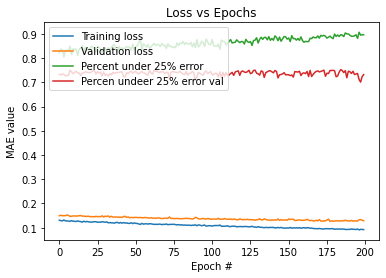

654/654 [==============================] - 20s 28ms/step - loss: 0.0200 - relative_error_10.0: 0.3361 - relative_error_25.0: 0.7319 - ssim_loss: 0.0760 - edge_loss: 0.0168 - mean_absolute_error: 0.0534 - mean_squared_error: 0.0066 - root_mean_squared_error: 0.0812


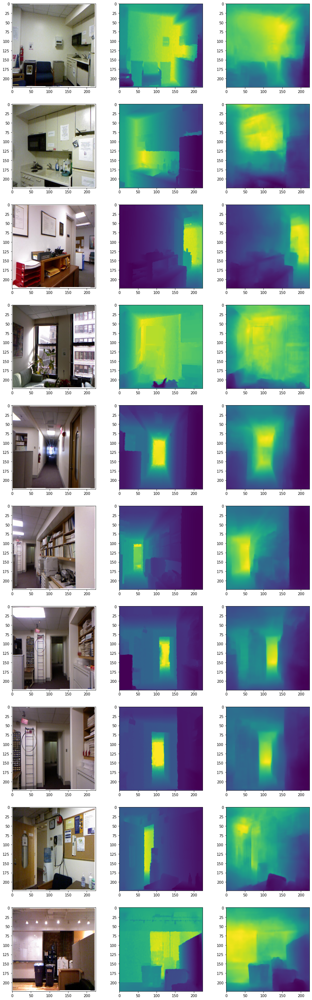

In [44]:
# model: mobilenet unet, alpha = 1.0, regularization, not pretrained
# iters: 150, bs: 8, data augmentation: color and spatial with random sized crops, shuffling
# loss: 0.3 * l1 + 1.0 * ssim + 1.0 * edge
# optimizer: SGD with lr 0.01 and momentum 0.9
name = "mobilenet_unet_34"
importlib.reload(models)
importlib.reload(losses)
# model = models.mobilenet_unet(224, 224, 4, alpha=1.0)
model = tf.keras.models.load_model("saved_models/{}.h5".format(name))
loss = losses.l1_ssim_edge(l1_weight=0.3, ssim_weight=1.0, edge_weight=1.0)
optimizer = keras.optimizers.SGD(learning_rate=1e-2, momentum=0.9)
experiment(name, model, loss, optimizer, 8, 200, augment_rgb=True, augment_spatial=True, shuffle=True)
m = tf.keras.models.load_model("saved_models/{}.h5".format(name))
show_history(name)
evaluate_model(m, 10)

In [40]:
layer = m.get_layer("Conv1")
print(tf.reduce_sum(layer.get_weights()[0][:, :, 3, :]))

tf.Tensor(-0.69494116, shape=(), dtype=float32)
